In [ ]:
import rpy2
import rpy2.robjects as ro
ro.r(".libPaths")("/public1/software/liuzj/softwares/anaconda3/envs/sc_py/lib/R/library")
from rpy2.robjects.packages import importr
import rpy2.ipython.html
rpy2.ipython.html.init_printing()
from jpy_tools.rTools import py2r, r2py, r_inline_plot, rHelp, trl, rSet, rGet, ad2so, so2ad, so2md, rcontext, Trl, r2py_re, py2r_re
from jpy_tools import loadPkl, toPkl
rBase = importr('base')
rUtils = importr('utils')
dplyr = importr('dplyr')
reticulate = importr('reticulate')
R = ro.r
T = Trl()
R("options(browser='firefox', shiny.port=6533)")
%load_ext rpy2.ipython


    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    

<Figure size 72x72 with 0 Axes>

In [ ]:
from jpy_tools import singleCellTools

Global seed set to 0


In [ ]:
import pandas as pd
import scanpy as sc
import numpy as np
import scipy.sparse as ss
from cool import F
import muon as mu

In [ ]:
import patchworklib as pw

In [ ]:
%config InlineBackend.figure_format = 'retina'
import seaborn as sns
from matplotlib import pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.font_manager as font_manager
# plt.rcParams['figure.dpi'] = 150
font_dirs = ["/public/home/mowp/test/fonts/"]
font_files = font_manager.findSystemFonts(fontpaths=font_dirs)
for font_file in font_files:
    font_manager.fontManager.addfont(font_file)
plt.rcParams["font.family"] = "Arial"
sns.despine(top=True, right=True)
from itertools import product
from functools import reduce
import patchworklib as pw
from jpy_tools.otherTools import pwRecoverSeaborn, pwStack, F, pwShow
pw.show = pwShow
fc_recoverSns = pwRecoverSeaborn()
import seaborn.objects as so
from cycler import cycler
dt_snsStyle = {**sns.axes_style('ticks'), "legend.frameon": False, "axes.spines.top":False, "axes.spines.right":False, "axes.prop_cycle":cycler(color=['grey'])}

<Figure size 432x288 with 0 Axes>

In [ ]:
dir_temp = '/public/home/liuzj/projects/singleCell/02_jupyter/soybean/0510_combine/'

In [ ]:
dir_result = "/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/analysis/noduleWithRoot/"

In [ ]:
# ad = sc.read_h5ad(f"{dir_result}/ad_brief_com_version_1.h5ad")

In [ ]:
dt_renameSample = {
    "Root": "Root",
    "Large Nodule": "Mature Nodule",
    "Small Nodule": "Developing Nodule",
}

In [ ]:
dt_renameSample = {
    "Root": "Root",
    "Mature Nodule": "Nodule (21 dpi)",
    "Developing Nodule": "Nodule (12 dpi)",
}

In [ ]:
# ad.obs['Sample_time'] = ad.obs['Sample_new'].map(dt_renameSample).cat.set_categories(['Nodule (21 dpi)', 'Nodule (12 dpi)', 'Root'])

# Load Gene Data

## load symbol info

In [ ]:
df_symbol = pd.read_table("/data/Zhaijx/liuzj/data/soybase_IPF/ncbi_locus/soybean_gene_symbol_name.txt").set_index('geneID')[['Symbol', 'other_designations']]

In [ ]:
df_symbol = df_symbol.loc[~df_symbol.index.duplicated()]

In [ ]:
dt_symbol = df_symbol.loc[~df_symbol['Symbol'].str.startswith('LOC')]['Symbol'].to_dict()

In [ ]:
df_soybase = pd.read_table(
    "/data/Zhaijx/liuzj/data/soybase_IPF/soybase_genome_annotation_v2.0_09-27-2021.txt",
    skiprows=11,
)
dt_soybase = (
    df_soybase.assign(
        **{
            "Gmax 2.0 Primary Protein ID (1)": lambda df: df[
                "Gmax 2.0 Primary Protein ID (1)"
            ].str.replace("Glyma.", "GLYMA_")
        }
    )
    .set_index("Gmax 2.0 Primary Protein ID (1)")[
        "Top Arabidopsis (TAIR10) BLASTP Hit (4)"
    ]
    .to_dict()
)

## get arab desc

In [ ]:
df_arabDesc = pd.read_table('/data/Zhaijx/liuzj/data/Araport11/original/arab_gene_desc.txt')

In [ ]:
dt_arabDesc = df_arabDesc['Gene Model Name'].to_dict()

## load nodulation related gene

In [ ]:
dt_oldLocusToNew = pd.read_table(
    "/data/Zhaijx/liuzj/data/soybase_IPF/Glyma_11_to_Glyma_20_Correspondence_Full.csv",
    skiprows=1,
).assign(
    **{
        "Glyma 1.1": lambda df: df["Glyma 1.1"]
        .str.replace("Glyma", "Glyma."),
        "Glyma2.0": lambda df: df["Glyma2.0"]
        .str.replace("g", "G"),
    }
).set_index(
    "Glyma 1.1"
)[
    "Glyma2.0"
].to_dict()

In [ ]:
# other rules
dt_oldLocusToNew.update(
    {
        "Glyma.15G19630": "Glyma.15G178100",
        "Glyma.07G04510": "Glyma.07G040300",
        "Glyma.6g04220": "Glyma.06G039100",
        "Glyma.8g01770": "Glyma.08G014500",
        "Glyma.7G133000": "Glyma.07G133000",
        "Glyma.5G126200": "Glyma.05G126200",
    }
)

In [ ]:
dt_oldLocusToNew.update({x.replace('g', 'G'):y for x,y in dt_oldLocusToNew.items()})

In [ ]:
dt_oldLocusToNew.update({x.replace('Glyma.', 'Glyma'):y for x,y in dt_oldLocusToNew.items()})

In [ ]:
df_nodulationRelatedGene = pd.read_excel('/data/Zhaijx/liuzj/data/nodulation_related_gene/TPC2019-RA-00279_Supplemental_Data_Set_1.xlsx', skiprows=1, header = [0, 1])

In [ ]:
df_nodulationRelatedGene = df_nodulationRelatedGene[
    [
        ("Gene Symbol", "Unnamed: 0_level_1"),
        ("Phenotypic Defect", "Infection"),
        ("Phenotypic Defect", "Nodule Organogenesis "),
        ("Phenotypic Defect", "Fixation"),
        ("Reference", "Unnamed: 4_level_1"),
        ("Protein class/Molecular function", "Unnamed: 5_level_1"),
        ("Gene Name", "Unnamed: 6_level_1"),
        ("Alternate names", "Unnamed: 7_level_1"),
        ("Mutagen", "Unnamed: 8_level_1"),
        ("Medicago Gene ID", "Unnamed: 9_level_1"),
        ("Probeset", "Unnamed: 10_level_1"),
        ("Lotus Gene ID", "Unnamed: 11_level_1"),
        ("Soybean Gene ID", "Unnamed: 12_level_1"),
        ("Phaseolus Gene ID", "Unnamed: 13_level_1"),
        ("Myc Phenotype", "Unnamed: 14_level_1"),
    ]
]

In [ ]:
def _rename(x):
    if x[1].startswith('Unnamed'):
        return x[0]
    else:
        return x[1] + 'Phenotype'
df_nodulationRelatedGene.columns = df_nodulationRelatedGene.columns.map(_rename)
df_nodulationRelatedGene

,Gene Symbol,InfectionPhenotype,Nodule Organogenesis Phenotype,FixationPhenotype,Reference,Protein class/Molecular function,Gene Name,Alternate names,Mutagen,Medicago Gene ID,Probeset,Lotus Gene ID,Soybean Gene ID,Phaseolus Gene ID,Myc Phenotype
0,GmACP,NaN,Nod+/-,NaN,"Wang et al., 2014",Carrier protein,ACYL CARRIER PROTEIN (ACP),NaN,RNAi,Medtr7g080390,Mtr.48571.1.S1_at,Lj1g3v2840250,Glyma.18G244300,Phvul.008G052400,NaN
1,"PvAGO5, GmAGO5",Inf-,"Nod+/-, White++",NaN,"Reyero-Saavedra et al., 2017",Multidomain protein (RNA silencing),ARGONAUTE 5 (AGO5),NaN,RNAi,"Medtr4g056430, Medtr4g056470",Mtr.45521.1.S1_at,Lj0g3v0169039.1,Glyma.12G083500,Phvul.011G088200,NaN
2,LjAMSH,"Inf+/-, Inf*",Nod+/-,Fix*,"Malolepszy et al., 2015",Enzyme (Metalloprotease; Deubiquitinating),ASSOCIATED MOLECULE WITH THE SH3 DOMAIN OF STA...,NaN,LORE1,Medtr6g083940,Mtr.21924.1.S1_at; Mtr.21925.1.S1_s_at,Lj2g3v0721190,Glyma.07G093100,Phvul.003G094300,Myc+
3,LjAMT1.1,NaN,Nod++,Fix+/-,"Rogato et al., 2008",Transporter (Ammonium),AMMONIUM TRANSPORTER 1.1 (AMT1.1),NaN,Antisense,Medtr1g045550,Mtr.10556.1.S1_at,"Lj5g3v1314550, Lj0g3v0302059",Glyma.10G132300,Phvul.007G231700,NaN
4,PvANN1,Inf+/-,Nod+/-,Fix+/-,"Carrasco-castilla et al., 2018",Membrane binding protein,ANNEXIN1 (ANN1),NaN,RNAi,Medtr8g038210,Mtr.14183.1.S1_at,Lj0g3v0203419,Glyma.13G199800,Phvul.011G209300,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202,MtZPT2,NaN,Nod*,Fix-,"Frugier et al., 2000",TF (Zinc-finger motif containing),Krüppel-like Cys-2/His-2 ZINC FINGER PROTEIN (...,NaN,Antisense,Medtr3g102980,Mtr.37495.1.S1_at,-,Glyma.06G045400,Phvul.009G070800,NaN
203,MtZR1,NaN,Nod*,Fix+/-,"Hopkins et al., 2013",Unknown protein,ZINC RIBBON protein 1 (ZR1),NaN,RNAi,Medtr3g086740,Msa.965.1.S1_at,-,Glyma18g01770,"Phvul.001G254500, Phvul.011G068500",NaN
204,MtγECS,NaN,Nod+,Fix+/-,"El Msehli et al., 2011",Enzyme (Synthetase),γ‐GLUTAMYLCYSTEINE SYNTHETASE (γECS),NaN,RNAi,Medtr8g098350,Mtr.26622.1.S1_at,Lj4g3v2951270,Glyma.05G207600,Phvul.002G289200,NaN
205,Gs52,NaN,"Nod+/-, Nod*",Fix*,"Govindarajulu M, 2009",Enzyme (Ecto-apyrase),Glycine sojae 52 (GS52),NaN,RNAi,Medtr7g085200,-,Lj1g3v3948070,Glyma.16G043300,-,NaN


In [ ]:
df_nodulationRelatedGene['Soybean Gene Parsed ID'] = df_nodulationRelatedGene['Soybean Gene ID'].str.findall(r"Glyma.[\w]+\b")
df_nodulationRelatedGene = df_nodulationRelatedGene.explode('Soybean Gene Parsed ID')
df_nodulationRelatedGene['Soybean Gene Parsed ID'] = df_nodulationRelatedGene['Soybean Gene Parsed ID'].map(lambda x:dt_oldLocusToNew.get(x,x))

In [ ]:
df_nodulationRelatedGene['Soybean Gene Parsed ID'] = df_nodulationRelatedGene['Soybean Gene Parsed ID'].str.replace('Glyma.', 'GLYMA_')

In [ ]:
ls_otherSpecies = """LjNFR5
LjSYMRK
LjNIN 
LjHAR1
MtVAMP721d/MtVAMP721e""".split('\n')

In [ ]:
df_nodulationRelatedGeneGmOnly = df_nodulationRelatedGene.pipe(lambda df:df.loc[df['Gene Symbol'].str.contains('Gm') | df.eval("`Gene Symbol` in @ls_otherSpecies")])
# df_nodulationRelatedGeneGmOnly = df_nodulationRelatedGene

In [ ]:
df_nodulationRelatedGene

,Gene Symbol,InfectionPhenotype,Nodule Organogenesis Phenotype,FixationPhenotype,Reference,Protein class/Molecular function,Gene Name,Alternate names,Mutagen,Medicago Gene ID,Probeset,Lotus Gene ID,Soybean Gene ID,Phaseolus Gene ID,Myc Phenotype,Soybean Gene Parsed ID
0,GmACP,NaN,Nod+/-,NaN,"Wang et al., 2014",Carrier protein,ACYL CARRIER PROTEIN (ACP),NaN,RNAi,Medtr7g080390,Mtr.48571.1.S1_at,Lj1g3v2840250,Glyma.18G244300,Phvul.008G052400,NaN,GLYMA_18G244300
1,"PvAGO5, GmAGO5",Inf-,"Nod+/-, White++",NaN,"Reyero-Saavedra et al., 2017",Multidomain protein (RNA silencing),ARGONAUTE 5 (AGO5),NaN,RNAi,"Medtr4g056430, Medtr4g056470",Mtr.45521.1.S1_at,Lj0g3v0169039.1,Glyma.12G083500,Phvul.011G088200,NaN,GLYMA_12G083500
2,LjAMSH,"Inf+/-, Inf*",Nod+/-,Fix*,"Malolepszy et al., 2015",Enzyme (Metalloprotease; Deubiquitinating),ASSOCIATED MOLECULE WITH THE SH3 DOMAIN OF STA...,NaN,LORE1,Medtr6g083940,Mtr.21924.1.S1_at; Mtr.21925.1.S1_s_at,Lj2g3v0721190,Glyma.07G093100,Phvul.003G094300,Myc+,GLYMA_07G093100
3,LjAMT1.1,NaN,Nod++,Fix+/-,"Rogato et al., 2008",Transporter (Ammonium),AMMONIUM TRANSPORTER 1.1 (AMT1.1),NaN,Antisense,Medtr1g045550,Mtr.10556.1.S1_at,"Lj5g3v1314550, Lj0g3v0302059",Glyma.10G132300,Phvul.007G231700,NaN,GLYMA_10G132300
4,PvANN1,Inf+/-,Nod+/-,Fix+/-,"Carrasco-castilla et al., 2018",Membrane binding protein,ANNEXIN1 (ANN1),NaN,RNAi,Medtr8g038210,Mtr.14183.1.S1_at,Lj0g3v0203419,Glyma.13G199800,Phvul.011G209300,NaN,GLYMA_13G199800
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202,MtZPT2,NaN,Nod*,Fix-,"Frugier et al., 2000",TF (Zinc-finger motif containing),Krüppel-like Cys-2/His-2 ZINC FINGER PROTEIN (...,NaN,Antisense,Medtr3g102980,Mtr.37495.1.S1_at,-,Glyma.06G045400,Phvul.009G070800,NaN,GLYMA_06G045400
203,MtZR1,NaN,Nod*,Fix+/-,"Hopkins et al., 2013",Unknown protein,ZINC RIBBON protein 1 (ZR1),NaN,RNAi,Medtr3g086740,Msa.965.1.S1_at,-,Glyma18g01770,"Phvul.001G254500, Phvul.011G068500",NaN,GLYMA_18G014300
204,MtγECS,NaN,Nod+,Fix+/-,"El Msehli et al., 2011",Enzyme (Synthetase),γ‐GLUTAMYLCYSTEINE SYNTHETASE (γECS),NaN,RNAi,Medtr8g098350,Mtr.26622.1.S1_at,Lj4g3v2951270,Glyma.05G207600,Phvul.002G289200,NaN,GLYMA_05G207600
205,Gs52,NaN,"Nod+/-, Nod*",Fix*,"Govindarajulu M, 2009",Enzyme (Ecto-apyrase),Glycine sojae 52 (GS52),NaN,RNAi,Medtr7g085200,-,Lj1g3v3948070,Glyma.16G043300,-,NaN,GLYMA_16G043300


## load matrix and QC

In [ ]:
import glob

In [ ]:
dir_result = "/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/step1_cellRanger/"

In [ ]:
ls_sample = ['nodule_large', 'nodule_small', 'root']

In [ ]:
ls_cellrangerH5 = [f"{dir_result}/{x}/{x}/outs/filtered_feature_bc_matrix.h5" for x in ls_sample]

In [ ]:
dir_result = "/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/analysis/noduleWithRoot/"

In [ ]:
ls_ad = [sc.read_10x_h5(x) for x in ls_cellrangerH5]

In [ ]:
ad = sc.concat(ls_ad, label='batch', keys=ls_sample, index_unique='-batch-')

In [ ]:
sc.pp.filter_genes(ad, min_cells=10)

In [ ]:
ad.obs.value_counts("batch")

batch
nodule_large    14819
nodule_small     9686
root             7636
dtype: int64

In [ ]:
singleCellTools.detectDoublet.byScDblFinder(ad, batch_key='batch')

2021-09-26 10:50:51.612 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:167 - start to transfer adata to R


transfer `<class 'anndata._core.anndata.AnnData'>` to R:  End  


2021-09-26 10:53:26.225 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:171 - start to calculate doublet score
2021-09-26 10:55:32.050 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:175 - start to intergrate result with adata


transfer `DFrame` to python:  End  


2021-09-26 10:55:33.833 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:188 - before filter: 32141
2021-09-26 10:55:34.100 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:192 - after filter: 27602


In [ ]:
ad.obs['batch'] = ad.obs['batch'].cat.set_categories(['nodule_small', 'nodule_large', 'root'])

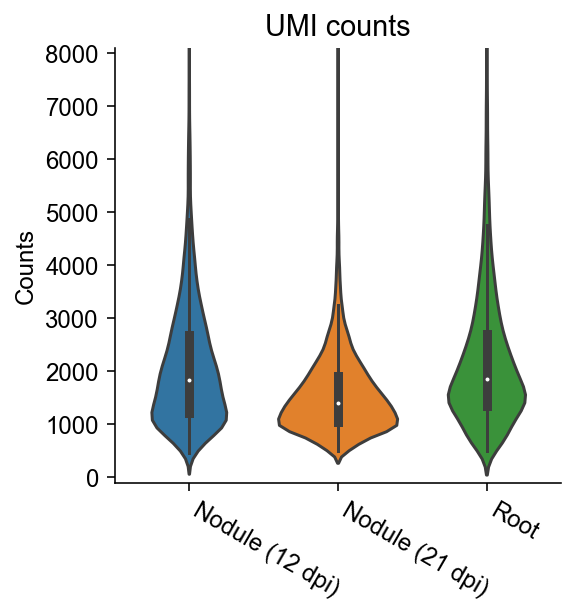

In [ ]:
plt.subplots(figsize=(4,4))
sns.violinplot(data = ad.obs, x='batch', y='n_counts')
plt.ylim(-100, 8100)
plt.xticks([0,1,2], ['Nodule (12 dpi)', 'Nodule (21 dpi)', 'Root'], rotation=-30, ha='left')
plt.xlabel('')
plt.ylabel("Counts")
plt.title("UMI counts")
sns.despine()

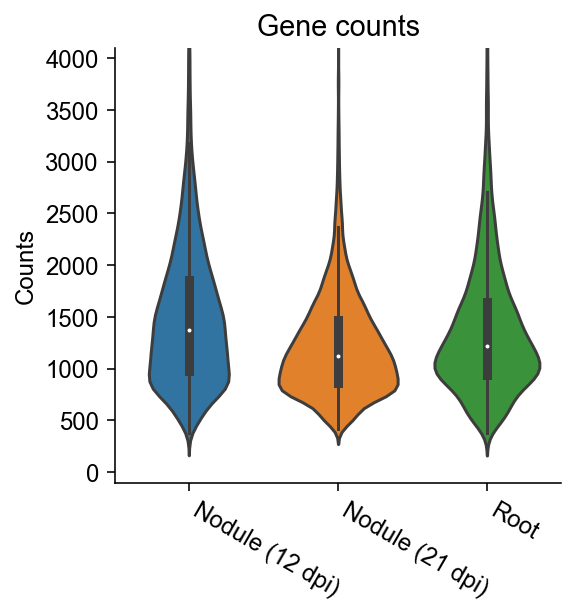

In [ ]:
plt.subplots(figsize=(4,4))
sns.violinplot(data = ad.obs, x='batch', y='n_genes')
plt.ylim(-100, 4100)
plt.xticks([0,1,2], ['Nodule (12 dpi)', 'Nodule (21 dpi)', 'Root'], rotation=-30, ha='left')
plt.xlabel('')
plt.ylabel("Counts")
plt.title("Gene counts")
sns.despine()

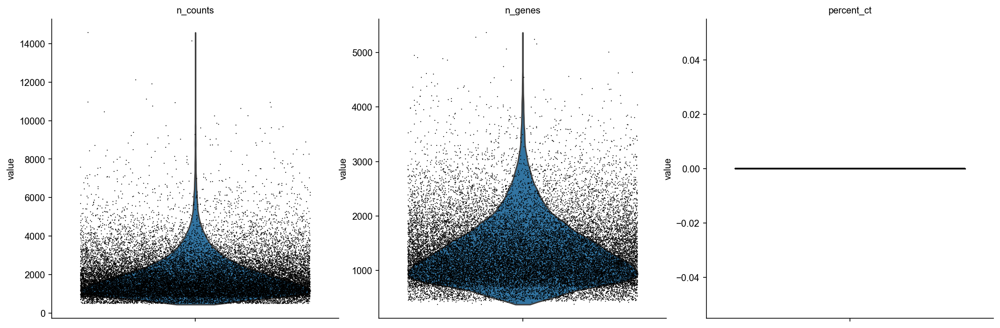

In [ ]:
singleCellTools.plotting.plotCellScatter(ad)

In [ ]:
ad = ad[ad.obs.eval("400 < n_genes < 4000 & 600 < n_counts < 6000")]

In [ ]:
ad.obs.value_counts("batch")

batch
nodule_large    12004
nodule_small     8229
root             6479
dtype: int64

In [ ]:
ad.layers['raw'] = ad.X.copy()

## basic static

In [ ]:
ad.obs['UMI counts'] = ad.to_df('raw').sum(1)
ad.obs['Gene counts'] = (ad.to_df('raw') > 0).astype(int).sum(1)

In [ ]:
_dt = {'nodule_large':'Large Nodule', 'nodule_small':'Small Nodule', 'root':'Root'}
ad.obs['Sample'] = ad.obs['batch'].map(_dt)

In [ ]:
ad_merged = singleCellTools.geneEnrichInfo._mergeData(ad, 'Sample_time', 'raw')

In [ ]:
(ad_merged.to_df() > 0).T.to_excel(f"{dir_result}/gene_basic_info.xlsx")

## clustering

In [ ]:
import scvi
from jpy_tools.otherTools import loadPkl, toPkl

In [ ]:
sc.pp.highly_variable_genes(ad, layer='raw', batch_key='batch', n_top_genes=5000, flavor='seurat_v3')

In [ ]:
ad.layers['normalize_log'] = ad.layers['raw'].copy()
sc.pp.normalize_total(ad, 1e4, layer='normalize_log')
sc.pp.log1p(ad, layer='normalize_log')

## run scVI to integrate datasets

In [ ]:
ad_forScvi = singleCellTools.basic.getPartialLayersAdata(ad, 'raw', ['batch'], ['highly_variable'])
ad_forScvi = ad_forScvi[:, ad_forScvi.var['highly_variable']].copy()

In [ ]:
toPkl(ad_forScvi, 'ad_forScvi_soybean', 'scem')

0


In [ ]:
# run on scem
# scvi.data.setup_anndata(
#     ad_forScvi,
# )

# scvi.settings.seed = 39
# scvi.settings.num_threads = 56

# model_withBatchEffect = scvi.model.SCVI(ad_forScvi)
# model_withBatchEffect.train()
# ad_forScvi.obsm['X_scvi_withBatchEffect'] = model_withBatchEffect.get_latent_representation(ad_forScvi).copy()


# scvi.data.setup_anndata(
#     ad_forScvi,
#     batch_key='batch'
# )

# scvi.settings.seed = 39
# scvi.settings.num_threads = 56

# model = scvi.model.SCVI(ad_forScvi)
# model.train()
# ad_forScvi.obsm['X_scvi'] = model.get_latent_representation(ad_forScvi).copy()

In [ ]:
ad_forScvi = loadPkl('ad_forScvi_soybean').copy()

In [ ]:
ad.obsm['X_scvi_withBatchEffect'] = ad_forScvi.obsm['X_scvi_withBatchEffect']
ad.obsm['X_scvi'] = ad_forScvi.obsm['X_scvi']

In [ ]:
sc.pp.neighbors(ad, use_rep='X_scvi')

In [ ]:
sc.tl.umap(ad)

In [ ]:
sc.tl.leiden(ad, resolution=0.3)
ad.obs['Cluster'] = ad.obs['leiden']

In [ ]:
ad.obs['Cluster'] = ad.obs['Cluster'].astype(str)

In [ ]:
_ls_colors = ['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#ff9896',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#d62728',
 '#c5b0d5',
 '#c49c94']

ad.uns['leiden_colors'] = _ls_colors
ad.uns['Cluster_colors'] = _ls_colors
ad.uns['Cell type_colors'] = _ls_colors

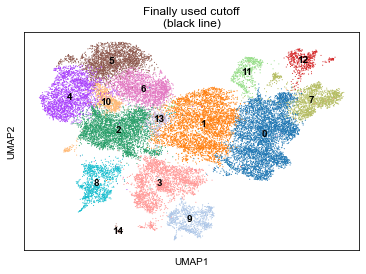

In [ ]:
sc.pl.umap(ad, color = 'Cluster', legend_loc='on data', title='Finally used cutoff\n(black line)')

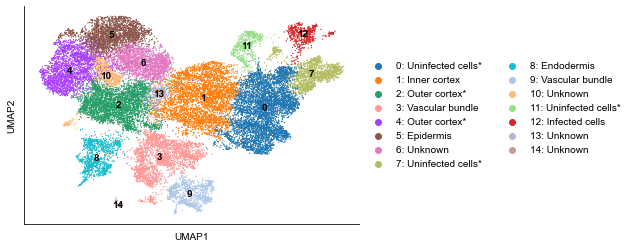

In [ ]:
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="")
sns.despine(top=True, right=True)
plt.show()

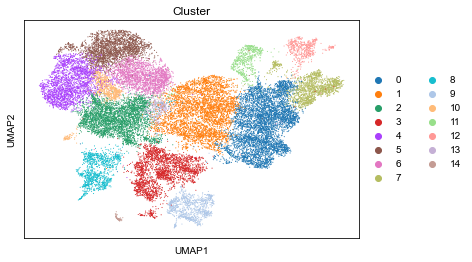

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

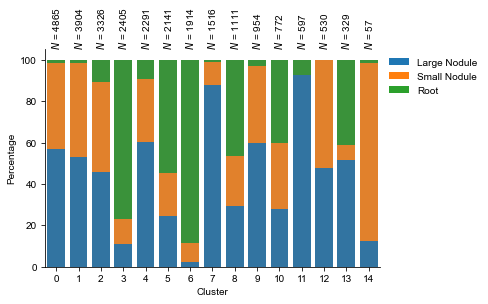

In [ ]:
sc.pl.umap(ad, color = 'Cluster')
singleCellTools.plotting.plotLabelPercentageInCluster(ad, "Cluster", "Sample")

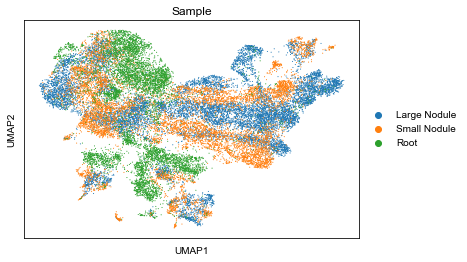

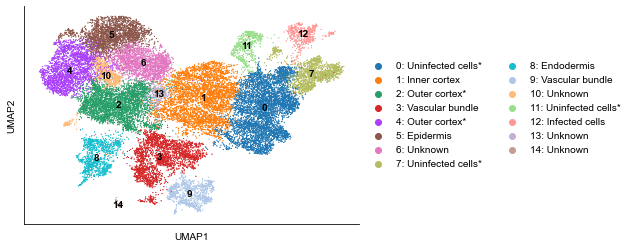

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

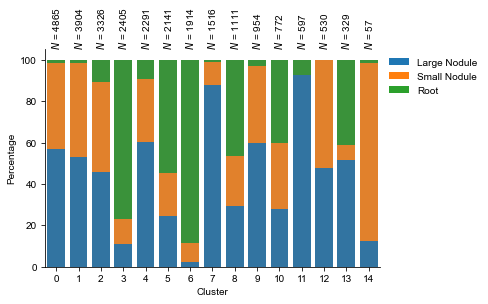

In [ ]:
sc.pl.umap(ad, color="Sample")
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="")
sns.despine(top=True, right=True)
plt.show()

singleCellTools.plotting.plotLabelPercentageInCluster(ad, "Cluster", "Sample")

In [ ]:
ad.uns['Sample_time_colors'] = ['#ff7f0e', '#1f77b4', '#2ca02c']

In [ ]:
ad.obs['Sample_time'] = ad.obs['Sample_time'].cat.set_categories([ 'Nodule (12 dpi)','Nodule (21 dpi)', 'Root'])

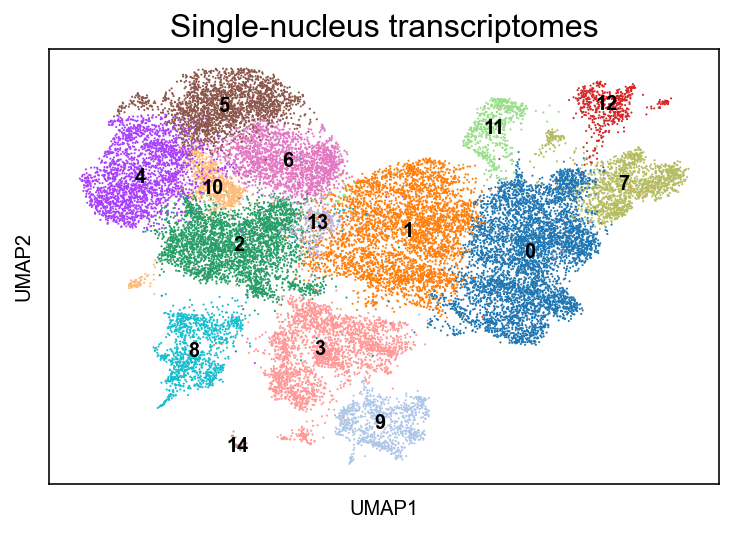

In [ ]:
ax = sc.pl.umap(ad, color="Cluster", title='Single-nucleus transcriptomes', legend_loc='on data', show=False)
plt.title('Single-nucleus transcriptomes', fontsize=16)
plt.show()

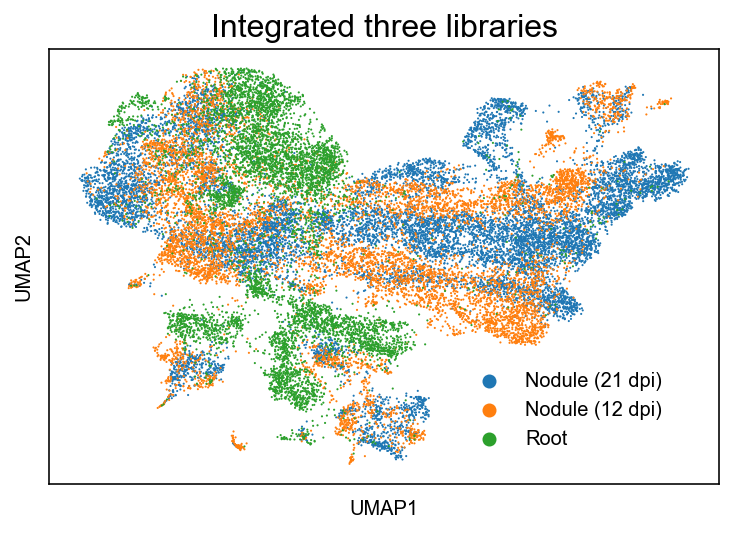

In [ ]:
ax = sc.pl.umap(ad, color="Sample_time", title='Integrated three libraries', show=False)
plt.title('Integrated three libraries', fontsize=16)
plt.legend(loc='upper left', bbox_to_anchor=(0.6, 0.3), frameon=False, ncol=1)
plt.show()

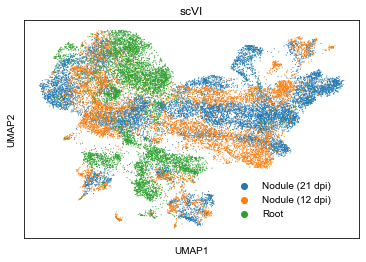

In [ ]:
ax = sc.pl.umap(ad, color="Sample_time", title='scVI', show=False)
plt.legend(loc='upper left', bbox_to_anchor=(0.6, 0.3), frameon=False, ncol=1)

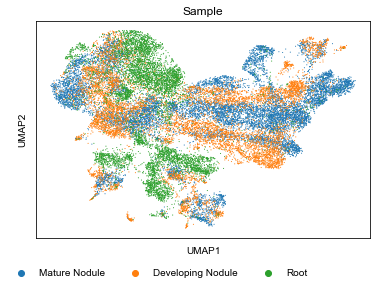

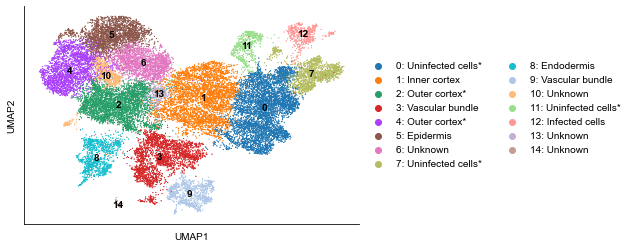

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

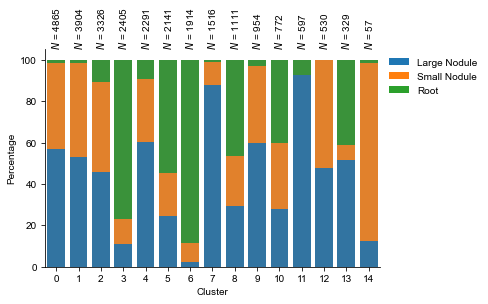

In [ ]:
ax = sc.pl.umap(ad, color="Sample_new", title='Sample', show=False)
plt.legend(loc='upper left', bbox_to_anchor=(-0.1, -0.1), frameon=False, ncol=3)

ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="")
sns.despine(top=True, right=True)
plt.show()

singleCellTools.plotting.plotLabelPercentageInCluster(ad, "Cluster", "Sample")

## scanorama

In [ ]:
import scanpy.external as sce

In [ ]:
ad_scanorama = ad.copy()

In [ ]:
ad_scanorama.X = ad_scanorama.layers['normalize_log'].copy()

In [ ]:
sc.tl.pca(ad_scanorama)

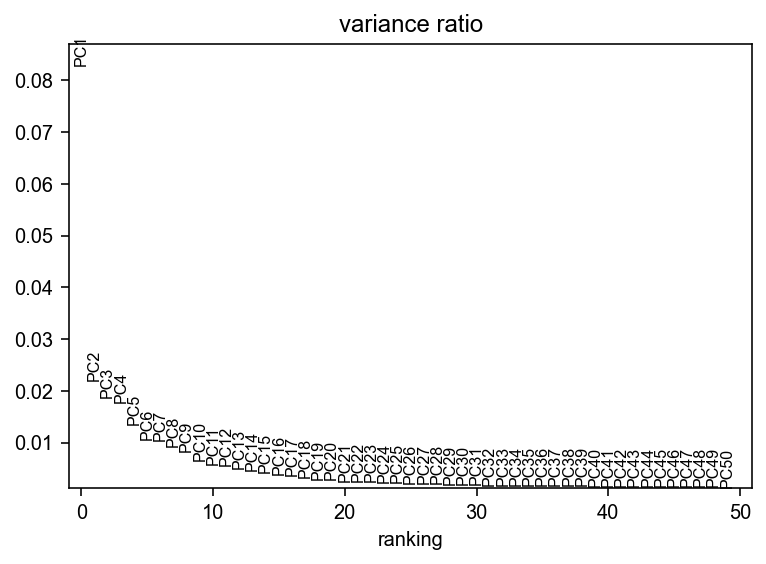

In [ ]:
sc.pl.pca_variance_ratio(ad_scanorama, 50,)

In [ ]:
ad_scanorama.obsm['X_pca_10'] = ad_scanorama.obsm['X_pca'][:, :10]

In [ ]:
sce.pp.scanorama_integrate(ad_scanorama, 'batch', basis='X_pca_10')

[[0.         0.19650018 0.01389103]
 [0.         0.         0.20311777]
 [0.         0.         0.        ]]
Processing datasets nodule_small <=> root
Processing datasets nodule_large <=> nodule_small


In [ ]:
sc.pp.neighbors(ad_scanorama, use_rep='X_scanorama')

In [ ]:
sc.tl.umap(ad_scanorama, 0.3)

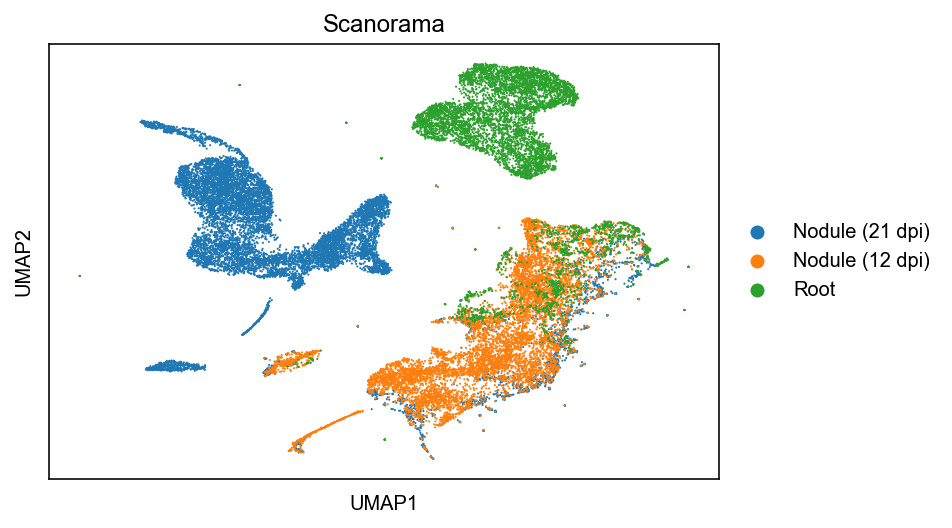

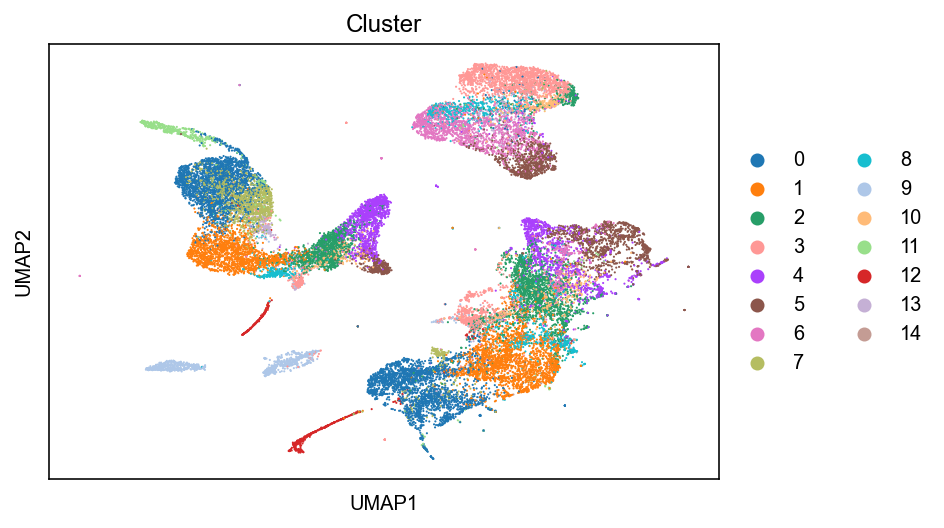

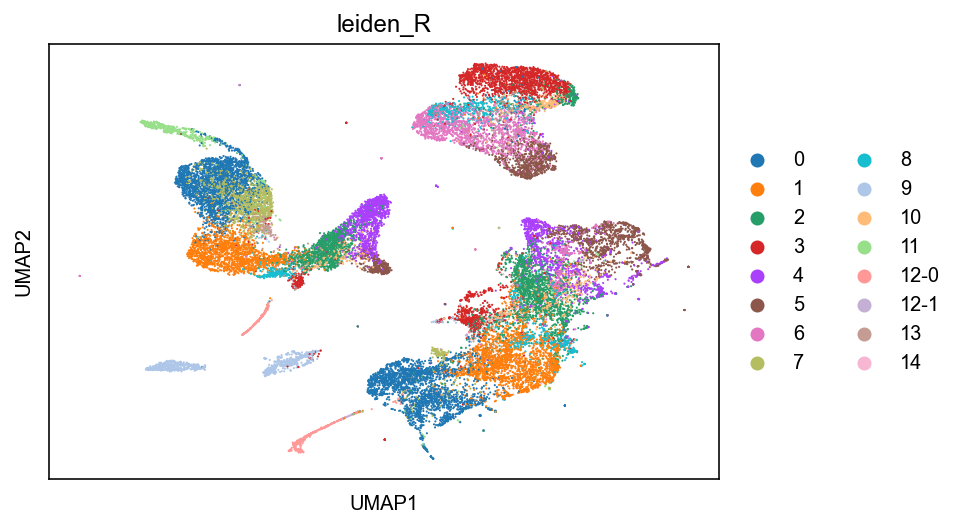

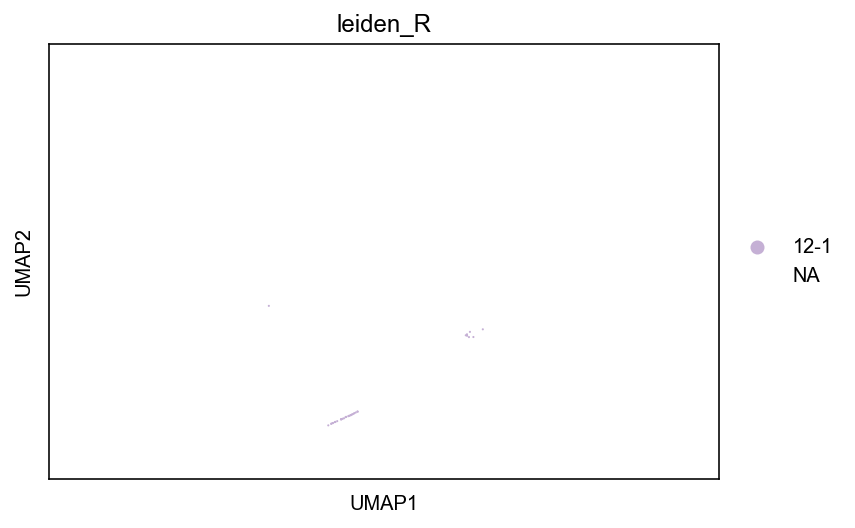

In [ ]:
sc.pl.umap(ad_scanorama, color='Sample_time', title='Scanorama')
sc.pl.umap(ad_scanorama, color='Cluster')
sc.pl.umap(ad_scanorama, color='leiden_R')
sc.pl.umap(ad_scanorama, color='leiden_R', groups=('leiden', ('12-1')), na_color='#FFFFFF')

Text(0, 0.5, '')

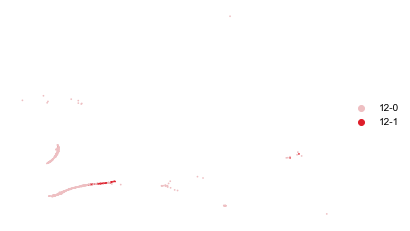

In [ ]:
sc.pl.umap(
    ad_scanorama[ad_scanorama.obs.eval("Cluster in ['12']")],
    color="leiden_R", show=False, palette=['#EEBFC2', '#DE1E2A'],size=12
)
sns.despine(left=True, bottom=True)
plt.title('')
plt.xlabel('')
plt.ylabel('')

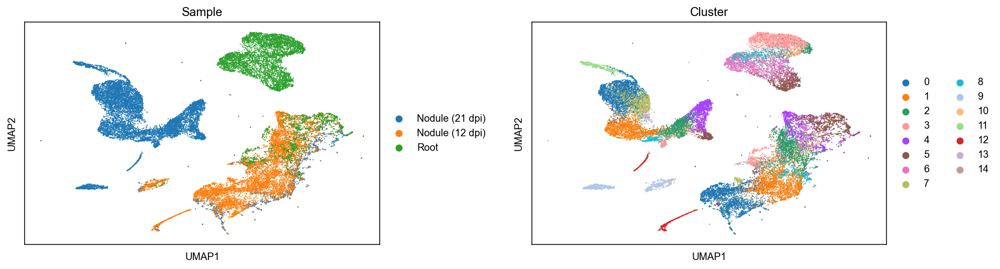

In [ ]:
axs = sc.pl.umap(ad_scanorama, color=['Sample_time', 'Cluster'], title=['Sample', 'Cluster'], wspace=0.3, show=False)
ax = axs[0]
plt.sca(ax)
# plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.07), frameon=False, ncol=3, fontsize=12)
# plt.tight_layout()
plt.show()

## harmony

In [ ]:
import scanpy.external as sce

In [ ]:
ad_harmony = ad.copy()

In [ ]:
ad_harmony.X = ad_harmony.layers['normalize_log'].copy()

In [ ]:
sc.tl.pca(ad_harmony)

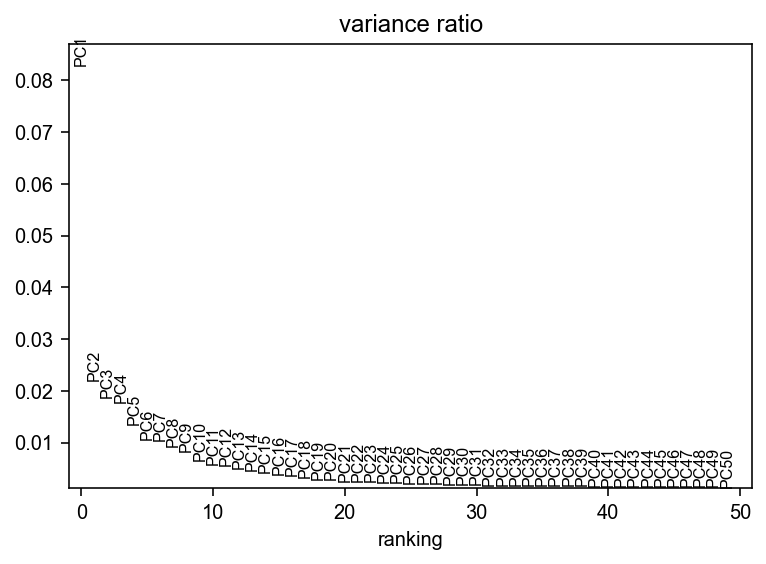

In [ ]:
sc.pl.pca_variance_ratio(ad_harmony, 50,)

In [ ]:
ad_harmony.obsm['X_pca_10'] = ad_harmony.obsm['X_pca'][:, :10]

In [ ]:
sce.pp.harmony_integrate(ad_harmony, 'batch', basis='X_pca_10')

2022-10-31 14:01:49,755 - harmonypy - INFO - Iteration 1 of 10
2022-10-31 14:01:59,244 - harmonypy - INFO - Iteration 2 of 10
2022-10-31 14:02:08,679 - harmonypy - INFO - Iteration 3 of 10
2022-10-31 14:02:18,614 - harmonypy - INFO - Iteration 4 of 10
2022-10-31 14:02:28,275 - harmonypy - INFO - Iteration 5 of 10
2022-10-31 14:02:37,530 - harmonypy - INFO - Iteration 6 of 10
2022-10-31 14:02:46,733 - harmonypy - INFO - Converged after 6 iterations


In [ ]:
sc.pp.neighbors(ad_harmony, use_rep='X_pca_harmony')

In [ ]:
sc.tl.umap(ad_harmony, 0.3)

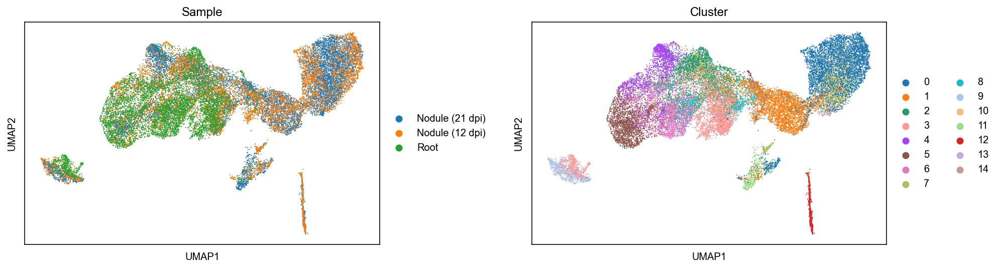

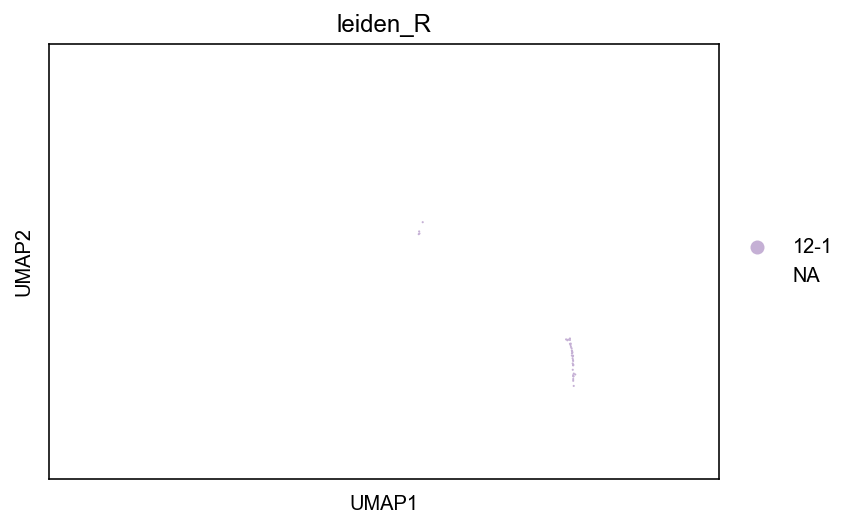

In [ ]:
axs = sc.pl.umap(ad_harmony, color=['Sample_time', 'Cluster'], title=['Sample', 'Cluster'], wspace=0.3)

sc.pl.umap(ad_harmony, color='leiden_R', groups=('leiden_R', ('12-1')), na_color='#FFFFFF')

Text(0.5, 1.0, 'Cluster 12')

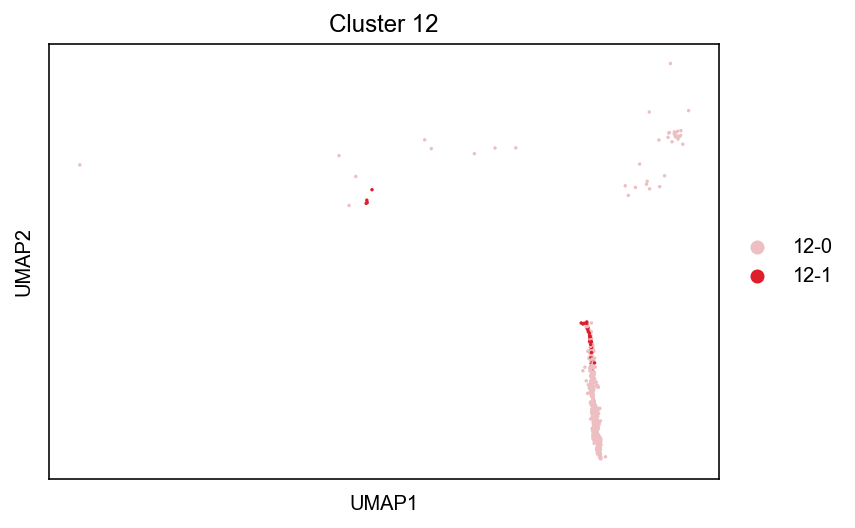

In [ ]:
sc.pl.umap(
    ad_harmony[ad_harmony.obs.eval("Cluster in ['12']")],
    color="leiden_R", show=False, palette=['#EEBFC2', '#DE1E2A'],size=12
)
plt.title('Cluster 12')

## CCA

In [ ]:
Seurat = importr('Seurat')

In [ ]:
ad_cca = singleCellTools.normalize.integrateBySeurat(ad, 'batch', ad.var.loc[lambda df:df['highly_variable']].index.to_list())

R[write to console]: Warning:
R[write to console]:  Feature names cannot have underscores ('_'), replacing with dashes ('-')

R[write to console]: Warning:
R[write to console]:  Invalid name supplied, making object name syntactically valid. New object name is batchn_genesn_countspercent_ctleiden_0.0leiden_0.1leiden_0.2leiden_0.3leiden_0.4leiden_0.5leiden_0.6leiden_0.7leiden_0.8leiden_0.9leiden_1.0leiden_1.1leiden_1.2leiden_1.3leiden_1.4leiden_1.5leiden_1.6leiden_1.7leiden_1.8leiden_1.9leiden_2.0leidenUMI.countsGene.countsSampleleiden_RClusterCell.typeX__groupSample_twoPartitionUMI.counts.log10Sample_newwgcna_clustercluster_mergeUCSample_time; see ?make.names for more details on syntax validity

R[write to console]: Warning:
R[write to console]:  Keys should be one or more alphanumeric characters followed by an underscore, setting key from scvi_withBatchEffect_ to scviwithBatchEffect_

R[write to console]: Warning:
R[write to console]:  All keys should be one or more alphanumeric charac

  |++++++++++++++++++++++++++++++++++++++++++++++++++| 100% elapsed=11s  


R[write to console]: Finding all pairwise anchors



  |                                                  | 0 % ~calculating  

R[write to console]: Running CCA

R[write to console]: Merging objects

R[write to console]: Finding neighborhoods

R[write to console]: Finding anchors

R[write to console]: 	Found 15752 anchors

R[write to console]: Filtering anchors

R[write to console]: 	Retained 5537 anchors



  |+++++++++++++++++                                 | 33% ~12m 38s      

R[write to console]: Running CCA

R[write to console]: Merging objects

R[write to console]: Finding neighborhoods

R[write to console]: Finding anchors

R[write to console]: 	Found 15221 anchors

R[write to console]: Filtering anchors

R[write to console]: 	Retained 2648 anchors



  |++++++++++++++++++++++++++++++++++                | 67% ~06m 35s      

R[write to console]: Running CCA

R[write to console]: Merging objects

R[write to console]: Finding neighborhoods

R[write to console]: Finding anchors

R[write to console]: 	Found 12094 anchors

R[write to console]: Filtering anchors

R[write to console]: 	Retained 3489 anchors



  |++++++++++++++++++++++++++++++++++++++++++++++++++| 100% elapsed=15m 26s


R[write to console]: Merging dataset 2 into 1

R[write to console]: Extracting anchors for merged samples

R[write to console]: Finding integration vectors

R[write to console]: Finding integration vector weights

R[write to console]: 0%   10   20   30   40   50   60   70   80   90   100%

R[write to console]: [----|----|----|----|----|----|----|----|----|----|

R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to con

In [ ]:
sc.tl.pca(ad_cca)

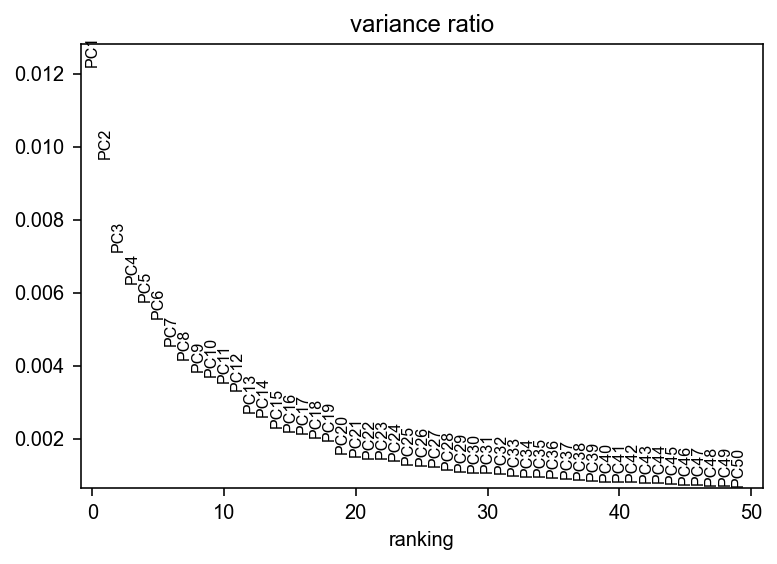

In [ ]:
sc.pl.pca_variance_ratio(ad_cca, 50)

In [ ]:
sc.pp.neighbors(ad_cca, n_pcs=20)

In [ ]:
sc.tl.umap(ad_cca, 0.3)

In [ ]:
ad_cca.uns['Cluster_colors'] = ad.uns['Cluster_colors']

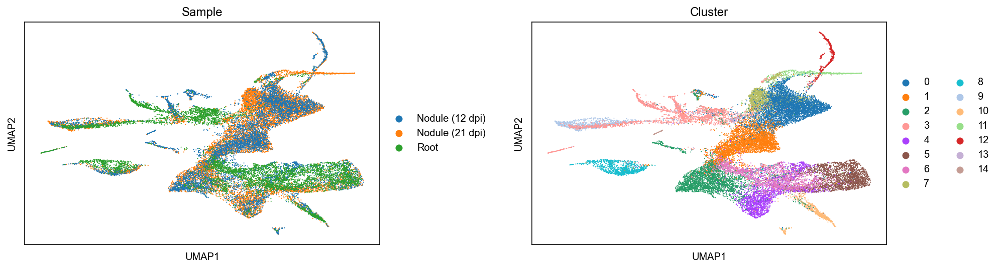

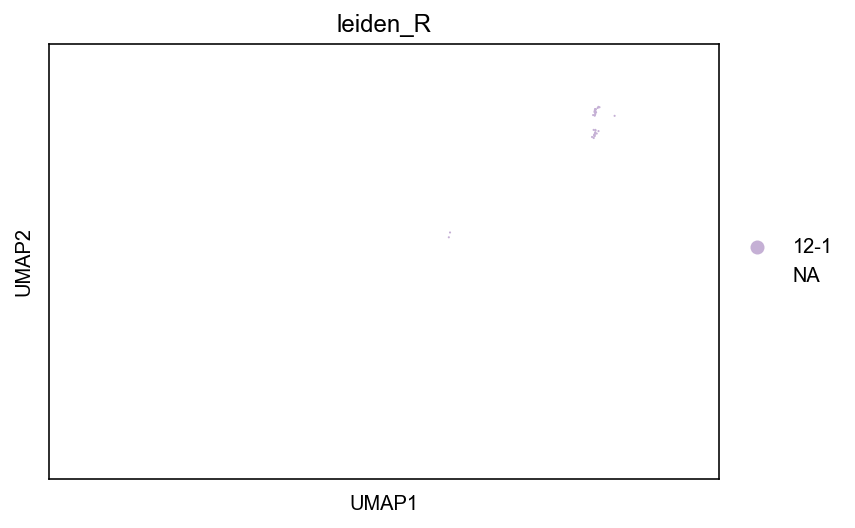

In [ ]:
axs = sc.pl.umap(ad_cca, color=['Sample_time', 'Cluster'], title=['Sample', 'Cluster'], wspace=0.3)

sc.pl.umap(ad_cca, color='leiden_R', groups=('leiden_R', ('12-1')), na_color='#FFFFFF')

Text(0.5, 1.0, 'Cluster 12')

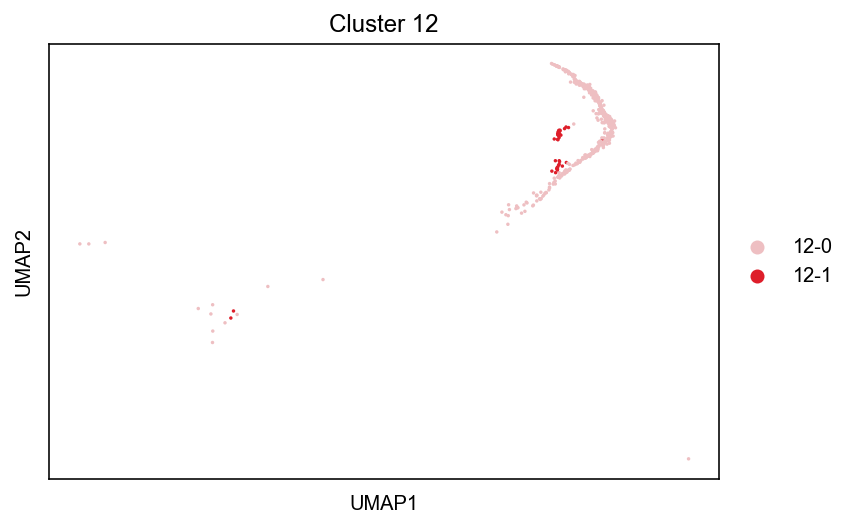

In [ ]:
sc.pl.umap(
    ad_cca[ad_cca.obs.eval("Cluster in ['12']")],
    color="leiden_R", show=False, palette=['#EEBFC2', '#DE1E2A'],size=12
)
plt.title('Cluster 12')

# annotation

## by gene

In [ ]:
dt_visualizationGene = {
    "Cortex": {"PIN2": "GLYMA_09G117900", "ENOD2": "GLYMA_20G203800", "CA1": "GLYMA_06G182700"},
    "Stele": dict(
        # MATE79="GLYMA_13G339800",
        MATE87="GLYMA_15G274600",
        PIN1b="GLYMA_07G102500",
        #         PIN1d="GLYMA_03G126000",
        SLR="GLYMA_03G158700",
        **{"NPF7.3":"GLYMA_17G153300"}
    ),
    #     "Infection Zone": dict(
    #         LBA="GLYMA_10G199100",
    #         LBC1="GLYMA_10G199000",
    #         LBC2="GLYMA_20G191200",
    #         LBC3="GLYMA_10G198800",
    #     ),
    "Infected cell": {"SYMREM1.1": "GLYMA_08G012800", "ENOD55": "GLYMA_02G204500", "RPG": "GLYMA_10G198700"}, 
    "Epidermis": dict(SHV3='GLYMA_08G324300', COBL7="GLYMA_09G039900",  CPC= "GLYMA_01G224900"),
}
dt_visualizationGene = {x:{j:f"{i}\n({j})" for i,j in y.items()} for x,y in dt_visualizationGene.items()}

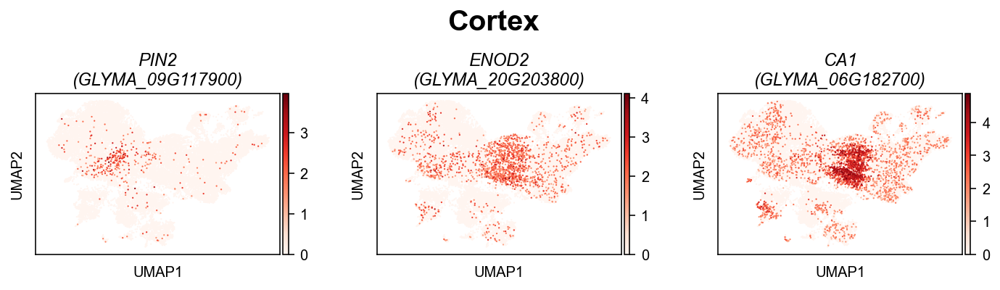

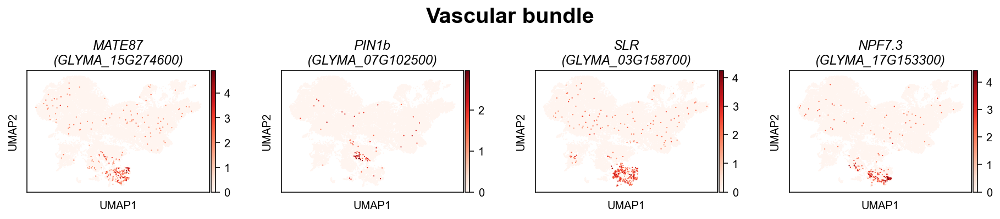

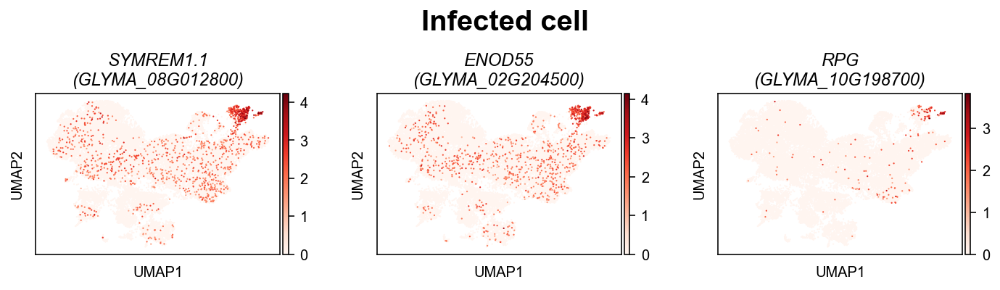

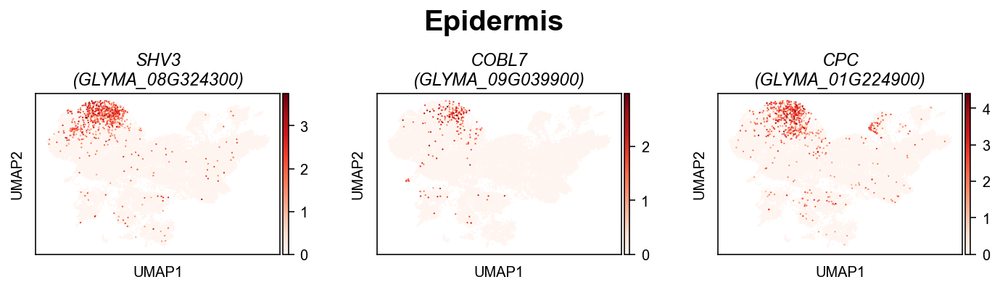

In [ ]:
with plt.rc_context({"figure.figsize": (3, 2)}):
    for (celltype, _dt_genes), x, z, y in zip(
        dt_visualizationGene.items(), [0.45, 0.45, 0.46, 0.45, 0.45], [5,5,5,5,10], [1.3,1.3,1.3,1.3,1.3]
    ):
        axs = sc.pl.umap(
            ad,
            layer="normalize_log",
            cmap="Reds",
            color=_dt_genes.keys(),
            title=_dt_genes.values(),
            size=z,
            show=False,
            ncols=4,
            hspace=0.7,
        )
            
        if len(_dt_genes) == 1:
            axs = [axs]
        for ax in axs:
            plt.sca(ax)
            text = ax.get_title()
            plt.title(text, fontdict={"style": "italic"})
        if celltype == 'Stele':
            celltype = 'Vascular bundle'
        plt.suptitle(celltype, x=x, y=y, fontsize=20, fontweight='bold')
        plt.show()

[<AxesSubplot:title={'center':'GLYMA_02G098200'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_11G203900'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_05G088400'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_13G300600'}, xlabel='UMAP1', ylabel='UMAP2'>]

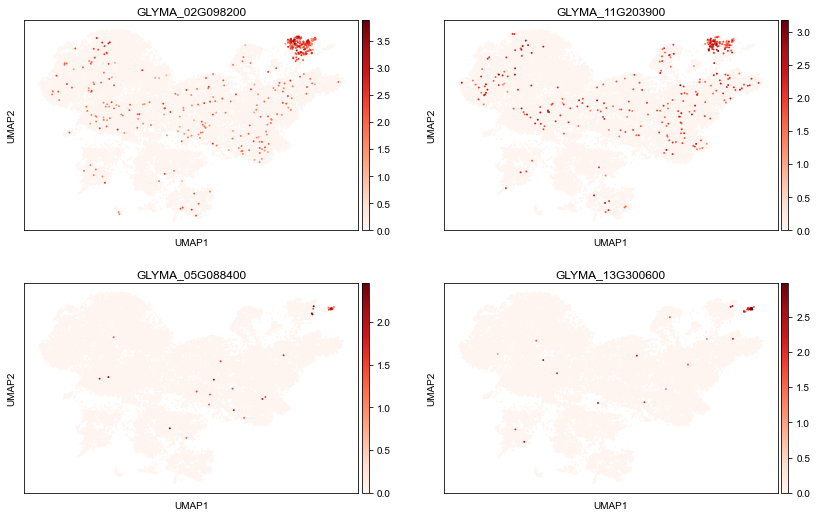

In [ ]:
_ls = ['GLYMA_02G098200', 'GLYMA_11G203900', 'GLYMA_05G088400', 'GLYMA_13G300600']

sc.pl.umap(
                ad,
                layer="normalize_log",
                cmap="Reds",
                color=_ls,
                size=15,
                ncols=2,
                show=False,
            )

## by ara

In [ ]:
dt_arab2soybean = pd.read_table(
    "/public/home/liuzj/data/ortholog/plant/parsed/1v1/arab__v__soybase_2.1v1.tsv"
).set_index("arab")["soybase_2"].to_dict()

In [ ]:
dt_arab2soybean = pd.read_table(
    "/public/home/liuzj/data/ortholog/plant/parsed/1v1_test/soybase_2__v__arab.1v1.tsv"
).set_index("arab")["soybase_2"].to_dict()

In [ ]:
ad_ara = sc.read_h5ad('/data/Zhaijx/liuzj/projects/singleCellRoot/bioaxivData/GSE152766_Root_Atlas.h5ad')
ad_ara = ad_ara[:, ad_ara.var.index.isin(list(dt_arab2soybean.keys()))]
ad_ara.var.index = ad_ara.var.index.map(dt_arab2soybean)
ad_ara.obs['specie'] = 'arabidopsis'

In [ ]:
ad_root = ad[ad.obs['batch'] == 'root'].copy()

In [ ]:
ad_root.obs['orig.ident'] = 'soybean'
ad_root.obs['specie'] = 'soybean'

In [ ]:
import anndata

In [ ]:
toPkl(ad_ara, 'ad_ara', 'scem')
toPkl(ad_root, 'ad_root', 'scem')

2022-11-02 19:20:20.833 | INFO     | jpy_tools.otherTools:toPkl:477 - please run `loadPkl('ad_ara', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object
2022-11-02 19:20:52.617 | INFO     | jpy_tools.otherTools:toPkl:477 - please run `loadPkl('ad_root', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


0
0


In [ ]:
# ad_root = loadPkl('ad_root',  lambda **dt:sc.read_h5ad(**dt), arg_path='filename').copy()
# ad_ara = loadPkl('ad_ara',  lambda **dt:sc.read_h5ad(**dt), arg_path='filename').copy()

# ad_ara = ad_ara[ad_ara.obs['time.anno'].isin(['Maturation'])]
# ad_ara = ad_ara[~ad_ara.obs['celltype.anno'].isin(['Putative Quiescent Center', 'Stem Cell Niche', 'Columella', 'Lateral Root Cap'])]

# ad_integrated = singleCellTools.scvi.labelTransferByScanvi(
#     ad_ara,
#     "celltype.anno",
#     "raw",
#     ad_root,
#     "raw",
#     True,
#     ["orig.ident", "specie"],
#     max_epochs=200,
#     mode="merge",
#     batch_size_ref=2**11, 
#     dt_params2SCVIModel = {'n_layers': 4},
#     dt_params2SCANVIModel = {'n_layers':4},
#     hvgBatch='specie',
#     n_top_genes=5000)




# toPkl(ad_root, 'ad_root', 'ipf', dir_path=dir_temp)
# toPkl(ad_integrated, 'ad_integrated', 'ipf', dir_path=dir_temp)

In [ ]:
ad_root = loadPkl('ad_root',  lambda **dt:sc.read_h5ad(**dt), arg_path='filename').copy()
ad_integrated = loadPkl('ad_integrated',  lambda **dt:sc.read_h5ad(**dt), arg_path='filename').copy()

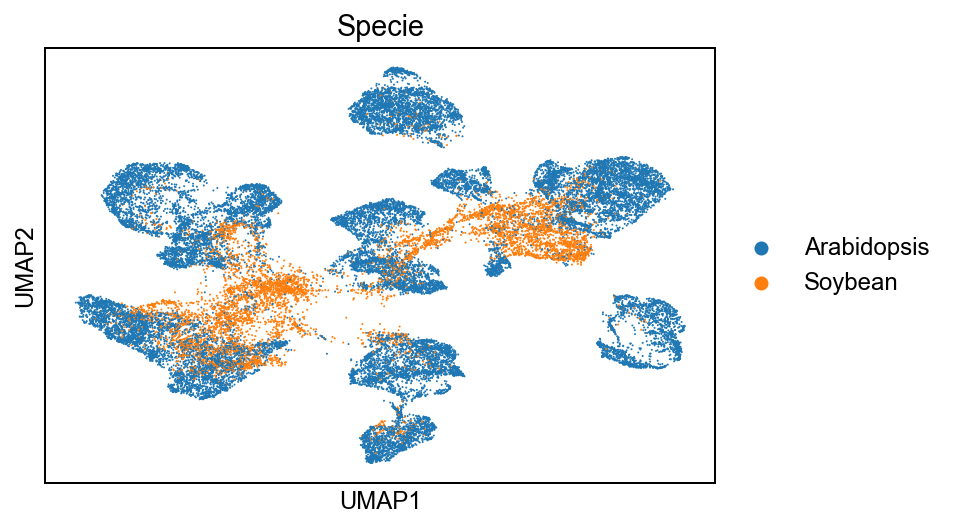

In [ ]:
_dt = {'arabidopsis': 'Arabidopsis', 'soybean':'Soybean'}
ad_integrated.obs['Specie'] = ad_integrated.obs['specie'].map(_dt)
sc.pl.umap(ad_integrated, color='Specie', )

In [ ]:
ad_root.obs["labelTransfer_scanvi_celltype.anno"] = (
    ad_root.obs["labelTransfer_scanvi_celltype.anno"]
    .str.capitalize()
    .astype("category")
    .cat.reorder_categories(
        [
            "Atrichoblast",
            "Cortex",
            "Endodermis",
            "Pericycle",
            "Phloem",
            "Procambium",
            "Trichoblast",
            "Xylem",
            "Unknown",
        ]
    )
)

In [ ]:
ad_integrated.obs['scANVI_results'] = ad_root.obs['labelTransfer_scanvi_celltype.anno'] 
ad_root.obs['Cluster'] = ad.obs['Cluster']
ad_integrated.obs['Cluster'] = ad.obs['Cluster'] 

Trying to set attribute `.uns` of view, copying.


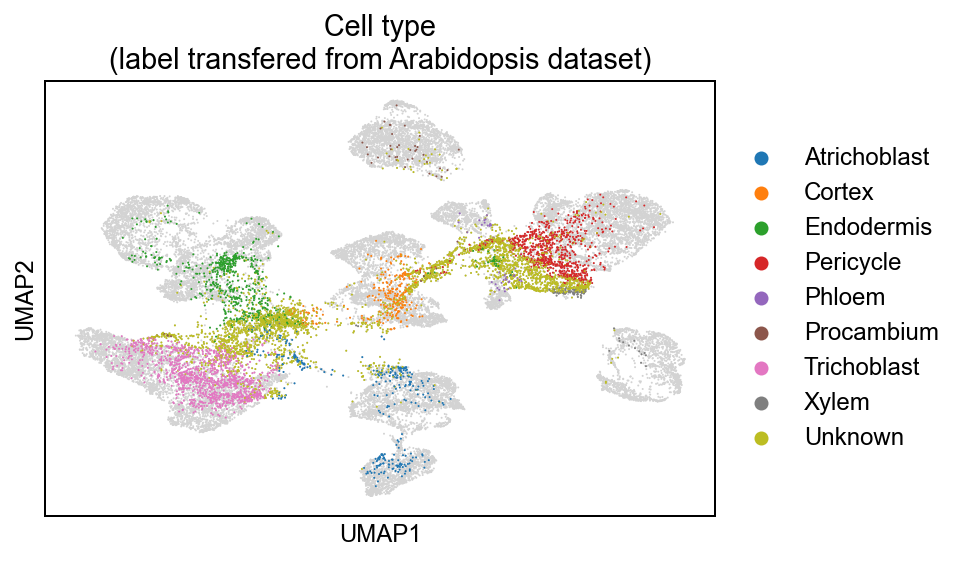

Trying to set attribute `.uns` of view, copying.


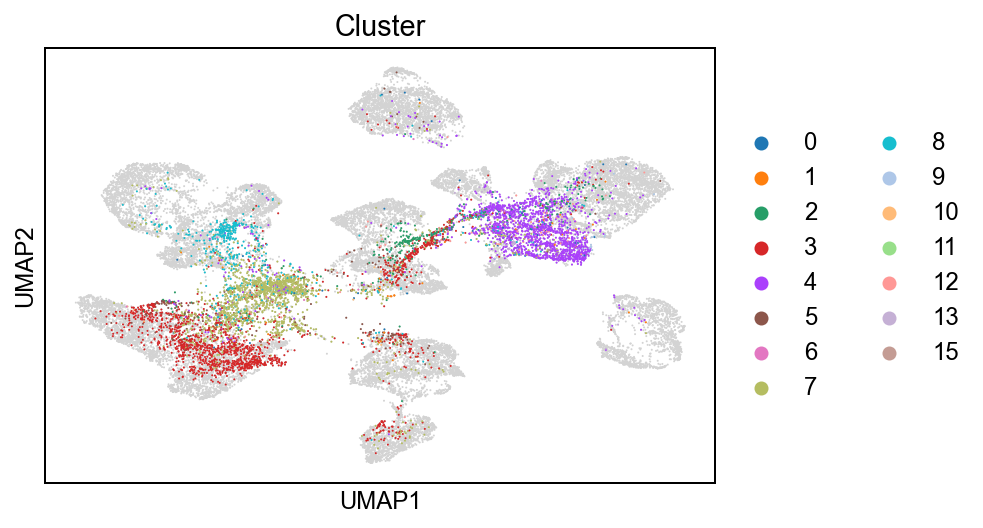

In [ ]:
_ad = ad_integrated[ad_integrated.obs.eval("Specie == 'Soybean'")]
ax = sc.pl.umap(ad_integrated, show=False)
sc.pl.umap(
    _ad,
    show=False,
    ax=ax,
    title="Cell type\n(label transfered from Arabidopsis dataset)",
    color="scANVI_results",
    size=12e4 / len(ad_integrated),
)
plt.show()

_ad = ad_integrated[ad_integrated.obs.eval("Specie == 'Soybean'")]
ax = sc.pl.umap(ad_integrated, show=False)
sc.pl.umap(
    _ad,
    show=False,
    ax=ax,
    color="Cluster",
    size=12e4 / len(ad_integrated),
)
plt.show()

In [ ]:
ad_root = loadPkl(
    "ad_root",
    dir_path="/public/home/liuzj/projects/singleCell/02_jupyter/soybean/2021_11_12",
)

<AxesSubplot:title={'center':'Cell type\n(label transfered from Arabidopsis dataset)'}, xlabel='UMAP1', ylabel='UMAP2'>

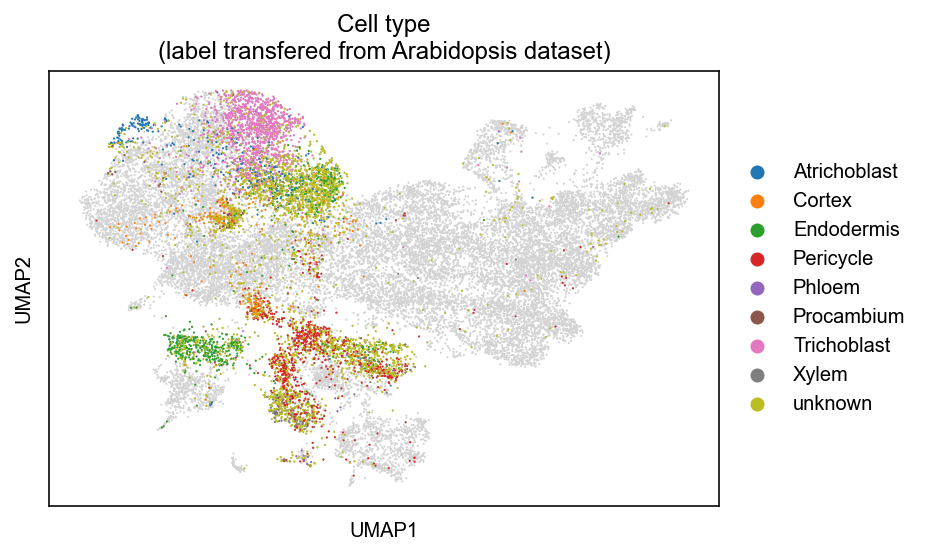

In [ ]:
ax = sc.pl.umap(ad, show=False)
sc.pl.umap(
    ad_root,
    color="labelTransfer_scanvi_celltype.anno",
    ax=ax,
    size=12e4 / len(ad),
    title="Cell type\n(label transfered from Arabidopsis dataset)",
    show=False
)
# plt.legend(ncol=4, frameon=False, bbox_to_anchor=(0,1))

In [ ]:
_dt = {
    "Atrichoblast": "Epidermis",
    "Pericycle": "Stele",
    "Phloem": "Stele",
    "Procambium": "Stele",
    "Trichoblast": "Epidermis",
    "Xylem": "Stele",
    "unknown": "Unknown",
}

In [ ]:
ad_root.obs["labelTransfer_results"] = ad_root.obs[
    "labelTransfer_scanvi_celltype.anno"
].map(lambda x: _dt.get(x, x))

In [ ]:
# ad_root.uns['labelTransfer_results_colors'] = ['#FBB03B', '#F77D0E', '#8C5552', '#B5C3E2', '#808080']

In [ ]:
_dt = singleCellTools.basic.getadataColor(ad_root, 'labelTransfer_results')
_dt['Unknown'] = '#808080'
singleCellTools.basic.setadataColor(ad_root, 'labelTransfer_results', _dt);

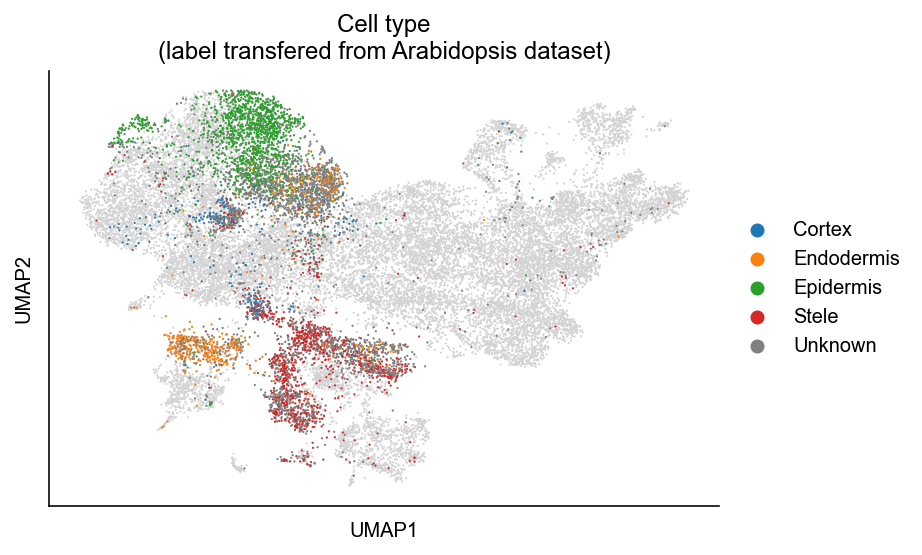

In [ ]:
ax = sc.pl.umap(ad, show=False)
sc.pl.umap(
    ad_root,
    color="labelTransfer_results",
    ax=ax,
    size=12e4 / len(ad),
    title="Cell type\n(label transfered from Arabidopsis dataset)",
    show=False
)
sns.despine()
# plt.legend(ncol=4, frameon=False, bbox_to_anchor=(0,1))

In [ ]:
# ad.obs['labelTransfer_scanvi_celltype.anno'] = ad_integrated.obs['labelTransfer_scanvi_celltype.anno']
# ad.obs['labelTransfer_scanvi_time.celltype.anno'] = ad_integratedZone.obs['labelTransfer_scanvi_time.celltype.anno']

In [ ]:
ad_root.obs['Cluster'] = ad.obs['Cluster']

In [ ]:
ad_root.obs['Cluster'].value_counts().loc[lambda x:x >= 100].index.to_list()

['3', '6', '5', '8', '2', '10', '4', '13']

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

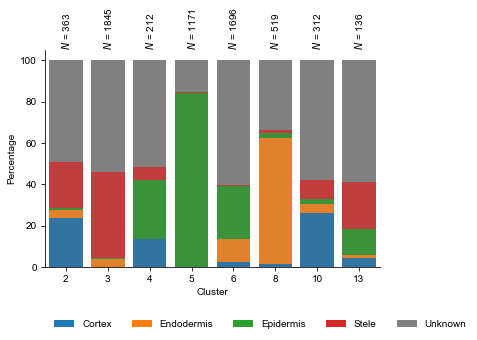

In [ ]:
_ls = ad_root.obs["Cluster"].value_counts().loc[lambda x: x >= 100].index.to_list()
_ad = ad_root[ad_root.obs.eval("Cluster in @_ls")]
singleCellTools.plotting.plotLabelPercentageInCluster(
    _ad, "Cluster", "labelTransfer_results", dt_kwargsForLegend=dict(ncol=5, loc='upper left', bbox_to_anchor=(0,-0.2))
)

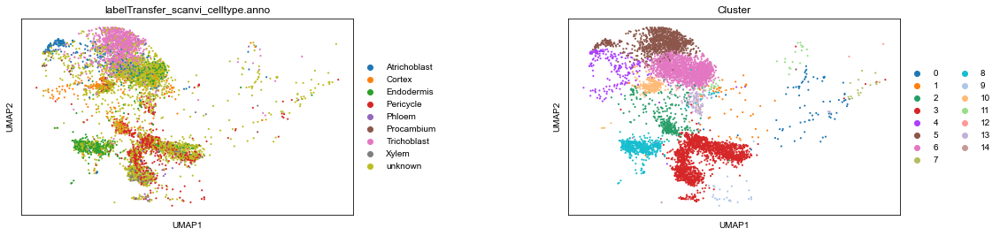

In [ ]:
sc.pl.umap(ad_root, color=['labelTransfer_scanvi_celltype.anno', 'Cluster'], wspace=0.5,)

# test clustering resolution

In [ ]:
import tqdm
import sklearn.metrics

In [ ]:
ad_forClusteringTest = ad.copy()

In [ ]:
for res in tqdm.tqdm(np.linspace(0, 1.5, 16)):
    res= f"{res:.1f}" >> F(float)
    sc.tl.leiden(ad_forClusteringTest, resolution=res, key_added=f"leiden_{res}")

100%|██████████| 16/16 [01:31<00:00,  5.72s/it]


In [ ]:
dt_silhouette_score = {}
for res in tqdm.tqdm(np.linspace(0, 1.5, 16)):
    if res == 0:
        continue
    res= f"{res:.1f}" >> F(float)
    dt_silhouette_score[res] = sklearn.metrics.silhouette_score(ad_forClusteringTest.obsm['X_scvi'], ad_forClusteringTest.obs[f"leiden_{res}"], random_state = 39)

100%|██████████| 16/16 [04:22<00:00, 16.42s/it]


In [ ]:
ad_rootKnownByAra = ad_root[ad_root.obs.eval("labelTransfer_results != 'Unknown'")]

In [ ]:
dt_ami = {}
for res in np.linspace(0, 1.5, 16):
    res= f"{res:.1f}" >> F(float)
    dt_ami[res >> F(str)] = sklearn.metrics.adjusted_mutual_info_score(ad_rootKnownByAra.obs['labelTransfer_results'], ad_forClusteringTest[ad_rootKnownByAra.obs.index].obs[f"leiden_{res}"] )

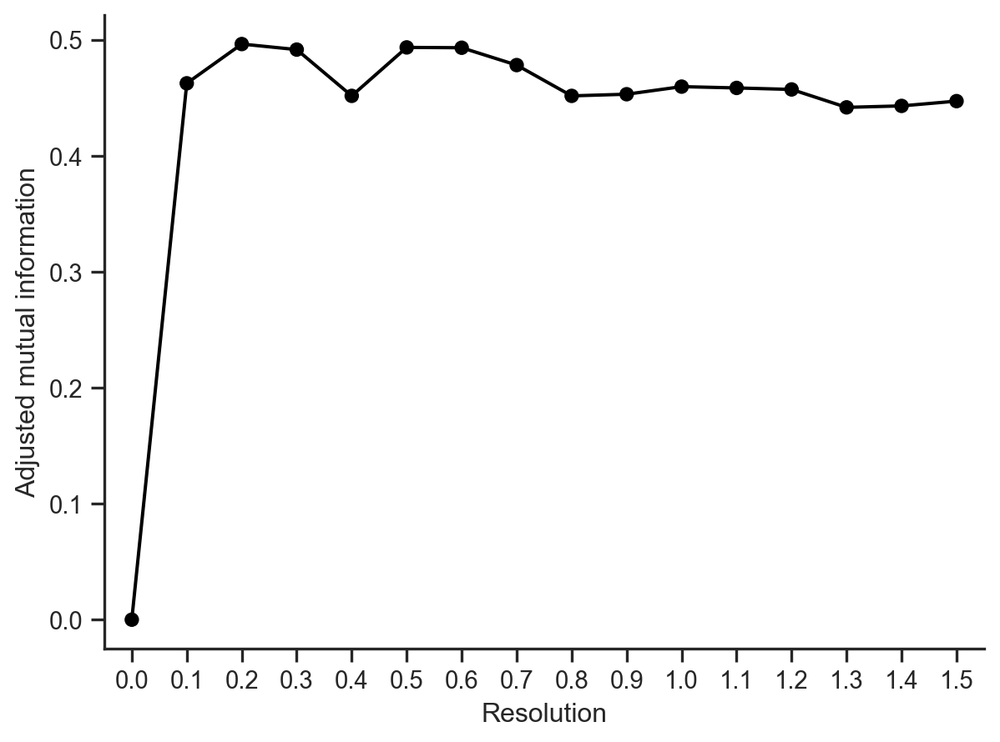

In [ ]:
(
    so.Plot(x=dt_ami.keys(), y=dt_ami.values())
    .add(so.Line(color='Black'))
    .add(so.Dot(color='Black'))
    .theme(dt_snsStyle)
    .label(x='Resolution', y='Adjusted mutual information')
)

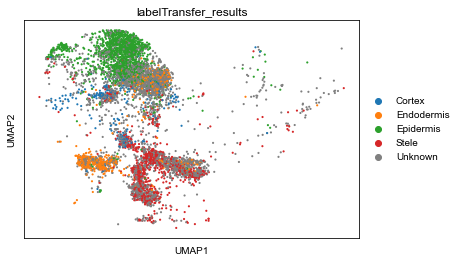

In [ ]:
sc.pl.umap(ad_root, color='labelTransfer_results')

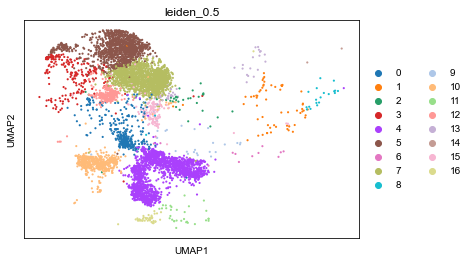

In [ ]:
sc.pl.umap(ad_root, color='leiden_0.5')

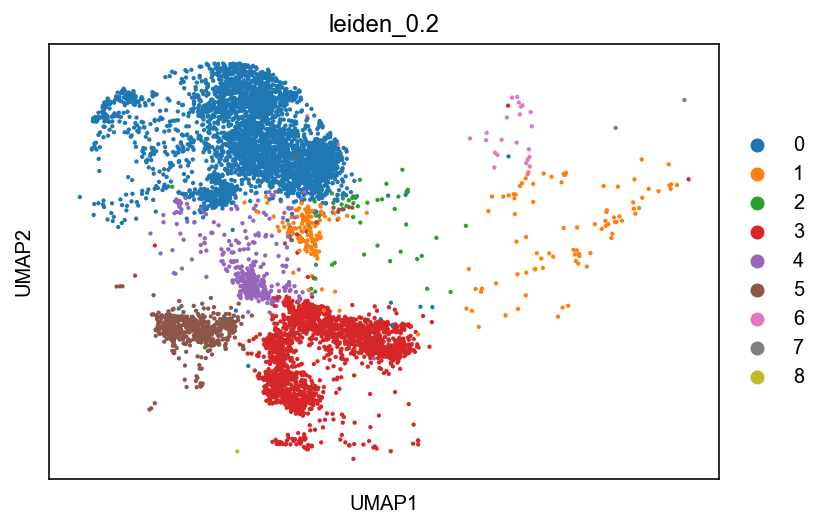

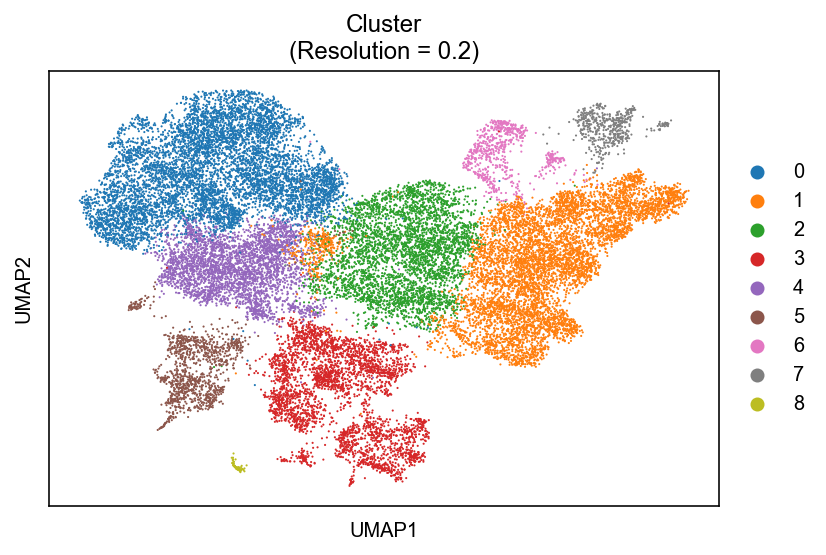

In [ ]:
sc.pl.umap(ad_root, color='leiden_0.2')
sc.pl.umap(ad_forClusteringTest, color='leiden_0.2', title='Cluster\n(Resolution = 0.2)')

In [ ]:
ad_forClusteringTest.uns['leiden_0.3_colors'] = ad.uns['Cluster_colors']

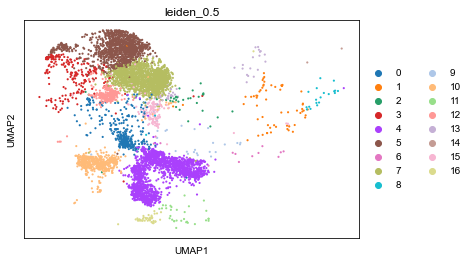

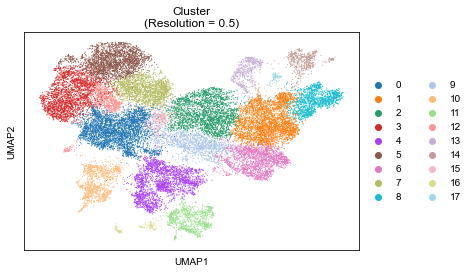

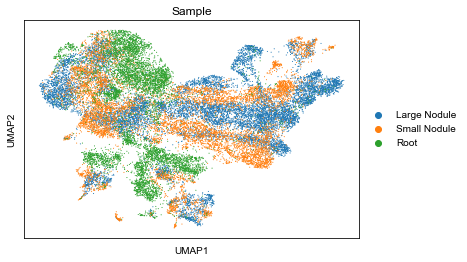

In [ ]:
sc.pl.umap(ad_root, color='leiden_0.5')
sc.pl.umap(ad_forClusteringTest, color='leiden_0.5',  title='Cluster\n(Resolution = 0.5)')

sc.pl.umap(ad_forClusteringTest, color='Sample')

In [ ]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad_forClusteringTest, 'raw', 'leiden_0.5', kayAddedPrefix='enrichScore_')

In [ ]:
_dt = ad_forClusteringTest.uns['enrichScore__cellexES'].groupby('leiden_0.5').apply(lambda x: x.sort_values('enrichScore', ascending=False).head(5)['gene'].to_list()).to_dict()

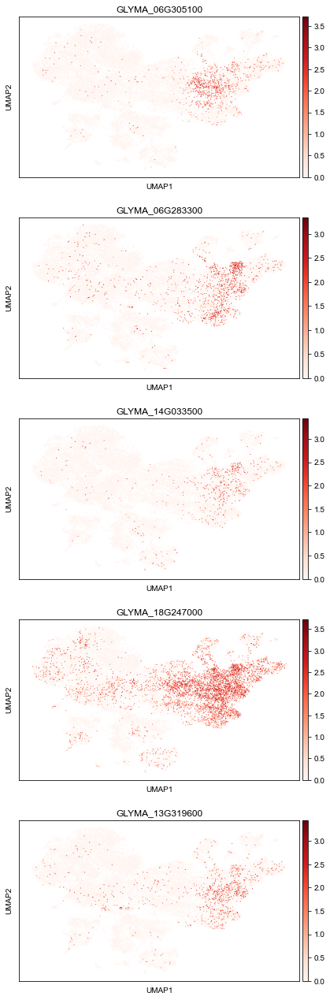

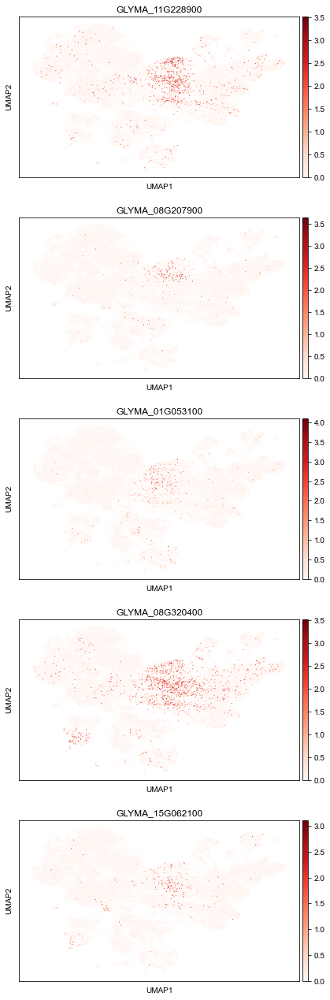

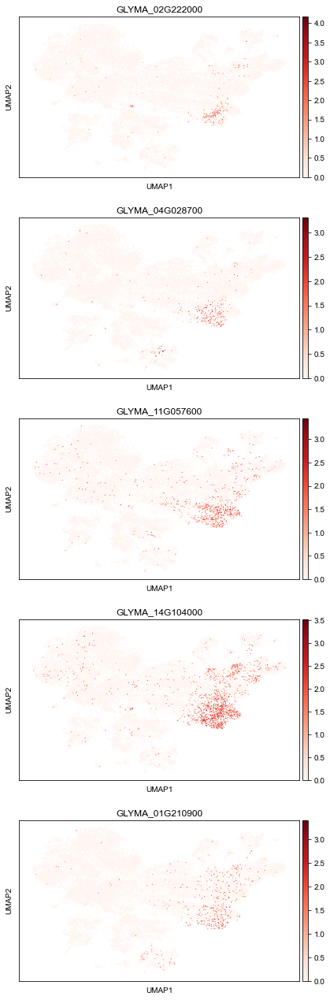

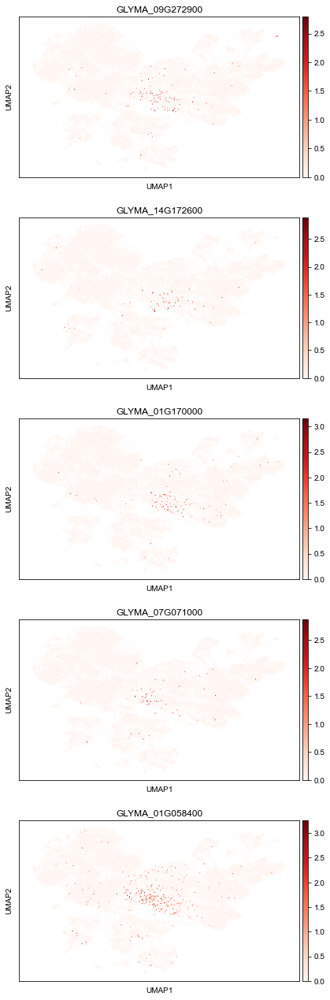

In [ ]:
for c in ['1','2', '6', '9']:
    sc.pl.umap(ad_forClusteringTest, color=_dt[c], ncols=1, layer='normalize_log', cmap='Reds')

# QC test

In [ ]:
import glob

In [ ]:
dir_result = "/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/step1_cellRanger/"

In [ ]:
ls_sample = ['nodule_large', 'nodule_small', 'root']

In [ ]:
ls_cellrangerH5 = [f"{dir_result}/{x}/{x}/outs/filtered_feature_bc_matrix.h5" for x in ls_sample]

In [ ]:
dir_result = "/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/analysis/noduleWithRoot/"

In [ ]:
ls_ad = [sc.read_10x_h5(x) for x in ls_cellrangerH5]

In [ ]:
ad_raw = sc.concat(ls_ad, label='batch', keys=ls_sample, index_unique='-batch-')

In [ ]:
dt_renameSample = {
    "root": "Root",
    "nodule_large": "Nodule (21 dpi)",
    "nodule_small": "Nodule (12 dpi)",
}

In [ ]:
ad_raw.obs['Sample'] = ad_raw.obs['batch'].map(dt_renameSample).astype('category').cat.set_categories(['Nodule (12 dpi)', 'Nodule (21 dpi)', 'Root'])

In [ ]:
sc.pp.filter_genes(ad_raw, min_cells=10)

In [ ]:
singleCellTools.detectDoublet.byScDblFinder(ad_raw, batch_key='batch')

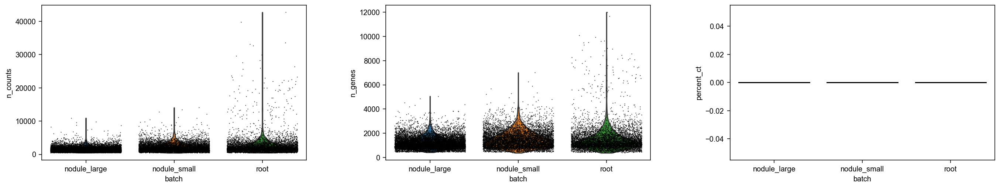

In [ ]:
singleCellTools.plotting.plotCellScatter(ad_raw, batch='batch')

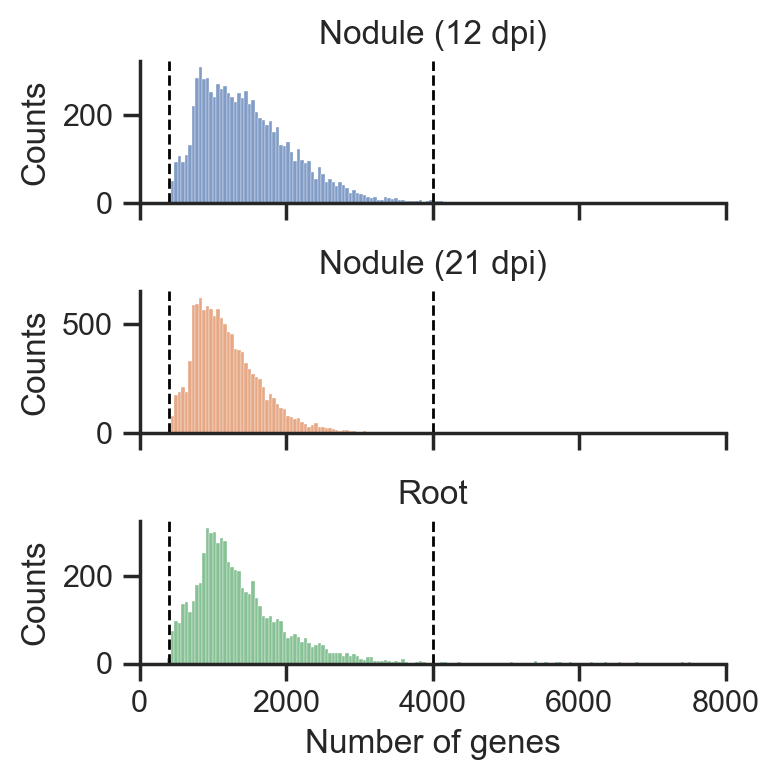

In [ ]:
fig = (
    so.Plot(data=ad_raw.obs)
    .facet(row='Sample')
    .add(so.Bars(), so.Hist(binrange=(0, 8000)), so.Stack(), x='n_genes', color='Sample', legend=False)
    .share(y=False)
    .limit(x=(0, 8000))
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=400, y=[0, 1250], orient='y', data={})
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=4000, y=[0, 1250], orient='y', data={})
    .scale(color='deep')
    .theme(dt_snsStyle)
    .label(x='Number of genes', y='Counts')
    .layout(size=(4,4))
    .plot()._figure
)
axs = fig.axes
for ax in axs:
    ax.axvline(x=400, ls='--', color='black', lw=1)
    ax.axvline(x=4000, ls='--', color='black', lw=1)
fig

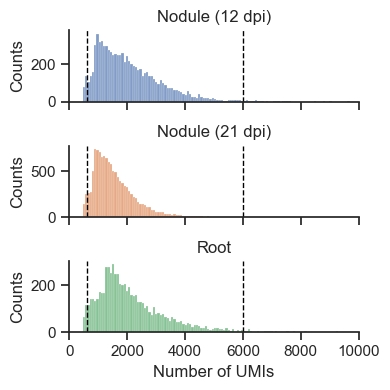

In [ ]:
fig = (
    so.Plot(data=ad_raw.obs)
    .facet(row='Sample')
    .add(so.Bars(), so.Hist(binrange=(0, 10000)), so.Stack(), x='n_counts', color='Sample', legend=False)
    .limit(x=(0, 10000))
    .share(y=False)
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=600, y=[0, 1350], orient='y', data={})
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=6000, y=[0, 1350], orient='y', data={})
    .scale(color='deep')
    .theme(dt_snsStyle)
    .label(x='Number of UMIs', y='Counts')
    .layout(size=(4,4))
    .plot()._figure
)
axs = fig.axes
for ax in axs:
    ax.axvline(x=600, ls='--', color='black', lw=1)
    ax.axvline(x=6000, ls='--', color='black', lw=1)
fig

<AxesSubplot:xlabel='Cluster', ylabel='n_counts'>

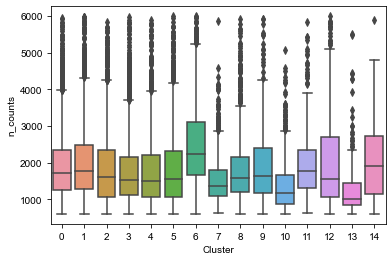

In [ ]:
sns.boxplot(ad.obs, x='Cluster', y='n_counts')

<AxesSubplot:xlabel='Cluster', ylabel='n_genes'>

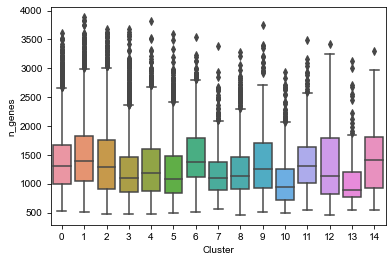

In [ ]:
sns.boxplot(ad.obs, x='Cluster', y='n_genes')

# QC alternative 1

stringent

umi: 800 -- 4000

genes: 600 -- 3000

In [ ]:
dt

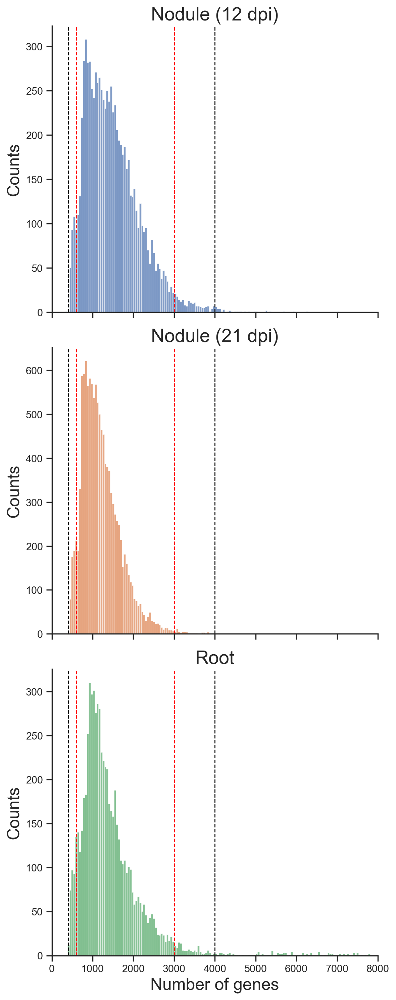

In [ ]:
fig = (
    so.Plot(data=ad_raw.obs)
    .facet(row='Sample')
    .add(so.Bars(), so.Hist(binrange=(0, 8000)), so.Stack(), x='n_genes', color='Sample', legend=False)
    .share(y=False)
    .limit(x=(0, 8000))
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=400, y=[0, 1250], orient='y', data={})
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=4000, y=[0, 1250], orient='y', data={})
    .scale(color='deep')
    .theme({**dt_snsStyle, 'axes.titlesize':20, "axes.labelsize":18})
    .label(x='Number of genes', y='Counts')
    .layout(size=(6,15))
    .plot()._figure
)
axs = fig.axes
for ax in axs:
    ax.axvline(x=600, ls='--', color='red', lw=1)
    ax.axvline(x=3000, ls='--', color='red', lw=1)
    ax.axvline(x=400, ls='--', color='black', lw=1)
    ax.axvline(x=4000, ls='--', color='black', lw=1)
fig

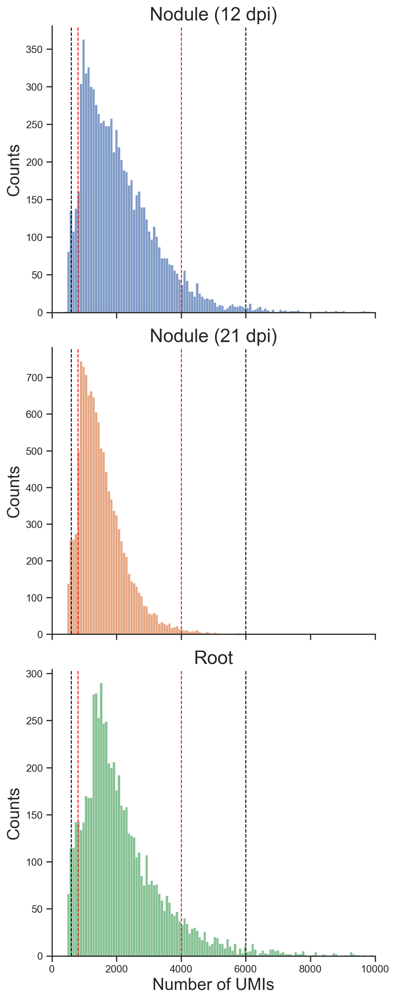

In [ ]:
fig = (
    so.Plot(data=ad_raw.obs)
    .facet(row='Sample')
    .add(so.Bars(), so.Hist(binrange=(0, 10000)), so.Stack(), x='n_counts', color='Sample', legend=False)
    .limit(x=(0, 10000))
    .share(y=False)
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=600, y=[0, 1350], orient='y', data={})
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=6000, y=[0, 1350], orient='y', data={})
    .scale(color='deep')
    .theme({**dt_snsStyle, 'axes.titlesize':20, "axes.labelsize":18})
    .label(x='Number of UMIs', y='Counts')
    .layout(size=(6,15))
    .plot()._figure
)
axs = fig.axes
for ax in axs:
    ax.axvline(x=800, ls='--', color='red', lw=1)
    ax.axvline(x=4000, ls='--', color='red', lw=1)
    ax.axvline(x=600, ls='--', color='black', lw=1)
    ax.axvline(x=6000, ls='--', color='black', lw=1)
fig

In [ ]:
ad_qc1 = ad_raw[ad_raw.obs.eval("600 < n_genes < 3000 & 800 < n_counts < 4000")]

In [ ]:
ad_qc1.obs.value_counts("batch")

batch
nodule_large    10980
nodule_small     7293
root             5582
dtype: int64

In [ ]:
ad_qc1.layers['raw'] = ad_qc1.X.copy()

In [ ]:
sc.pp.highly_variable_genes(ad_qc1, layer='raw', batch_key='batch', n_top_genes=5000, flavor='seurat_v3')

In [ ]:
ad_qc1forScvi = singleCellTools.basic.getPartialLayersAdata(ad_qc1, 'raw', ['batch'], ['highly_variable'])
ad_qc1forScvi = ad_qc1forScvi[:, ad_qc1forScvi.var['highly_variable']].copy()

In [ ]:
toPkl(ad_qc1forScvi, 'ad_qc1forScvi', 'scem')

2022-09-23 17:27:31.062 | INFO     | jpy_tools.otherTools:toPkl:477 - please run `loadPkl('ad_qc1forScvi', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


0


In [ ]:
# run on scem

# scvi.model.SCVI.setup_anndata(
#     ad_qc1forScvi,
#     batch_key='batch'
# )

# scvi.settings.seed = 39
# scvi.settings.num_threads = 24

# model = scvi.model.SCVI(ad_qc1forScvi)
# model.train()
# ad_qc1forScvi.obsm['X_scvi'] = model.get_latent_representation(ad_qc1forScvi).copy()

# toPkl(ad_qc1forScvi, 'ad_qc1forScvi', 'ipf')

In [ ]:
ad_qc1forScvi = loadPkl('ad_qc1forScvi', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')

In [ ]:
sc.pp.neighbors(ad_qc1forScvi, use_rep='X_scvi')

In [ ]:
sc.tl.umap(ad_qc1forScvi)

In [ ]:
ad_qc1forScvi.obs['Cluster'] = ad.obs['Cluster']
ad_qc1forScvi.obs['leiden_R'] = ad.obs['leiden_R']

In [ ]:
ad_qc1forScvi

AnnData object with n_obs × n_vars = 23855 × 5000
    obs: 'batch', '_scvi_batch', '_scvi_labels', 'Cluster', 'leiden_R'
    var: 'highly_variable'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'neighbors', 'umap'
    obsm: 'X_scvi', 'X_umap'
    obsp: 'distances', 'connectivities'

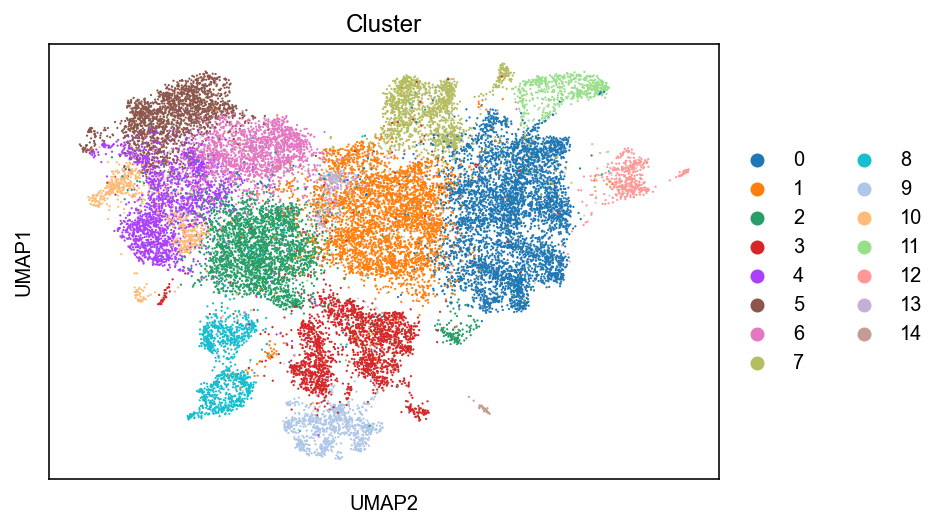

In [ ]:
ax = sc.pl.umap(ad_qc1forScvi, color='Cluster', show=False, na_in_legend=False, components=('2,1'))
# ax.invert_yaxis()
# ax.invert_xaxis()
plt.show()

In [ ]:
ad_qc1forScvi.uns['Cluster_colors'] = ad.uns['Cluster_colors']

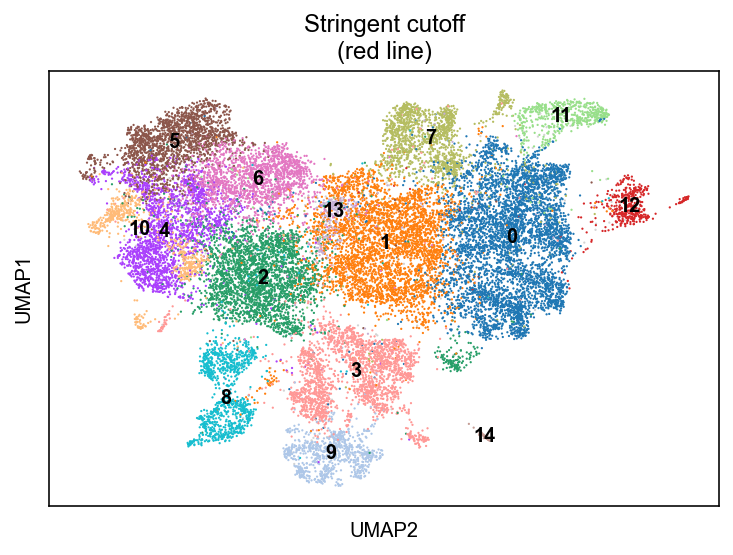

In [ ]:
sc.pl.umap(ad_qc1forScvi, color='Cluster', show=False, na_in_legend=False, components=('2,1'), legend_loc='on data', title='Stringent cutoff\n(red line)')
plt.show()
# ax.invert_yaxis()

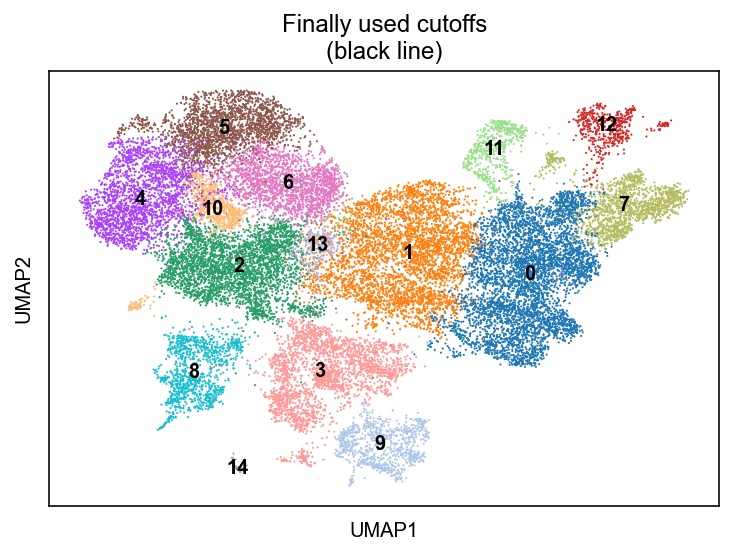

In [ ]:
sc.pl.umap(ad, color = 'Cluster', legend_loc='on data', title='Finally used cutoffs\n(black line)')

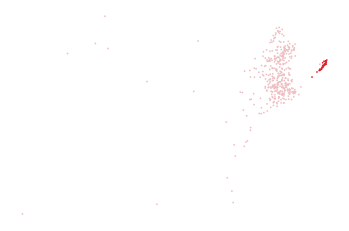

In [ ]:
ax = sc.pl.umap(
    ad_qc1forScvi[ad_qc1forScvi.obs.eval("Cluster in ['12']")],
    color="leiden_R", show=False, palette=['#EEBFC2', '#DE1E2A'], legend_loc=None,size=12, components=('2,1')
)
sns.despine(left=True, bottom=True)
plt.title('')
plt.xlabel('')
plt.ylabel('')

plt.show()

# QC alternative 2

NO further QC

In [ ]:
ad_qc2 = ad_raw.copy()

In [ ]:
ad_qc2.layers['raw'] = ad_qc2.X.copy()

In [ ]:
sc.pp.highly_variable_genes(ad_qc2, layer='raw', batch_key='batch', n_top_genes=5000, flavor='seurat_v3')

In [ ]:
ad_qc2forScvi = singleCellTools.basic.getPartialLayersAdata(ad_qc2, 'raw', ['batch'], ['highly_variable'])
ad_qc2forScvi = ad_qc2forScvi[:, ad_qc2forScvi.var['highly_variable']].copy()

In [ ]:
toPkl(ad_qc2forScvi, 'ad_qc2forScvi', 'scem')

2022-09-23 19:17:57.778 | INFO     | jpy_tools.otherTools:toPkl:477 - please run `loadPkl('ad_qc2forScvi', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


0


In [ ]:
# run on scem

# scvi.model.SCVI.setup_anndata(
#     ad_qc2forScvi,
#     batch_key='batch'
# )

# scvi.settings.seed = 39
# scvi.settings.num_threads = 24

# model = scvi.model.SCVI(ad_qc2forScvi)
# model.train()
# ad_qc2forScvi.obsm['X_scvi'] = model.get_latent_representation(ad_qc2forScvi).copy()

# toPkl(ad_qc2forScvi, 'ad_qc2forScvi', 'ipf')

In [ ]:
ad_qc2forScvi = loadPkl('ad_qc2forScvi', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')

In [ ]:
sc.pp.neighbors(ad_qc2forScvi, use_rep='X_scvi')

In [ ]:
sc.tl.umap(ad_qc2forScvi)

In [ ]:
ad_qc2forScvi.obs['Cluster'] = ad.obs['Cluster']
ad_qc2forScvi.obs['leiden_R'] = ad.obs['leiden_R']

In [ ]:
ad_qc2forScvi.uns['Cluster_colors'] = ad.uns['Cluster_colors']

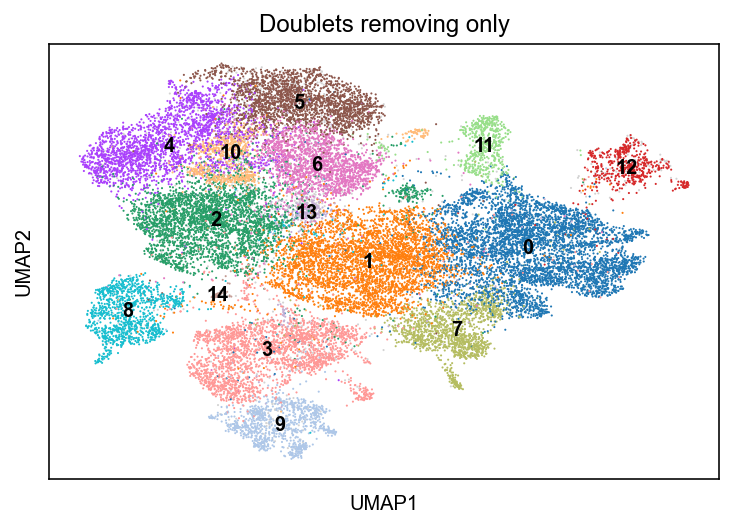

In [ ]:
ax = sc.pl.umap(ad_qc2forScvi, color='Cluster', legend_loc='on data', title='Doublets removing only', show=False, na_in_legend=False)
ax.invert_yaxis()
plt.show()

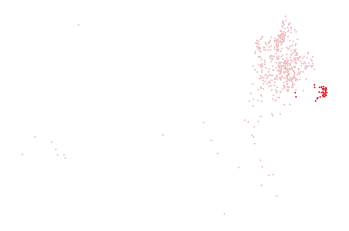

In [ ]:
ax = sc.pl.umap(
    ad_qc2forScvi[ad_qc2forScvi.obs.eval("Cluster in ['12']")],
    color="leiden_R", show=False, palette=['#EEBFC2', '#DE1E2A'], legend_loc=None,size=12
)
sns.despine(left=True, bottom=True)
plt.title('')
plt.xlabel('')
plt.ylabel('')

ax.invert_yaxis()
# ax.invert_xaxis()
plt.show()

## spatial

### deconvolution

In [ ]:
ad_st = loadPkl('ad_afterTissueCut_polished', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_temp)

In [ ]:
ad_sc = sc.read_h5ad(f"{dir_result}/ad_20220311.v1.h5ad")
ad_scNodule = ad_sc[ad_sc.obs.eval("Sample != 'Root'")].copy()

In [ ]:
toPkl(ad_st, 'ad_st', 'scem')
toPkl(ad_scNodule, 'ad_scNodule', 'scem')

In [ ]:
# scem :

# ad_st = loadPkl('ad_st', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')
# ad_scNodule = loadPkl('ad_scNodule', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')

# ls_keepCluster = ad_scNodule.obs['Cluster'].value_counts().pipe(lambda sr:sr[sr > 500].index.to_list())
# ad_scNoduleFiltered = ad_scNodule[ad_scNodule.obs.eval("Cluster in @ls_keepCluster")]

# singleCellTools.spatialTools.getClusterScoreFromScDataByDestvi(
#     ad_st,
#     ad_scNoduleFiltered,
#     clusterKey="Cluster",
#     nFeatures=3000,
#     condScviEpoch=1000, 
#     destviEpoch=4000, 
#     minUmiCountsInStLayer = 10, 
#     batchSize=1024, hvgLabel='Sample',  
#     hvgScDataOnly=True,
#     # dt_condScviConfigs={'n_layers':4},
# )
# toPkl(ad_st, 'ad_st_afterDeconvolution', 'ipf')

In [ ]:
ad_st = loadPkl('ad_st_afterDeconvolution', lambda **dt:sc.read_h5ad(**dt), arg_path='filename',  dir_path=dir_result)

... storing 'destVI_results' as categorical
... storing 'destVI_results_merged' as categorical


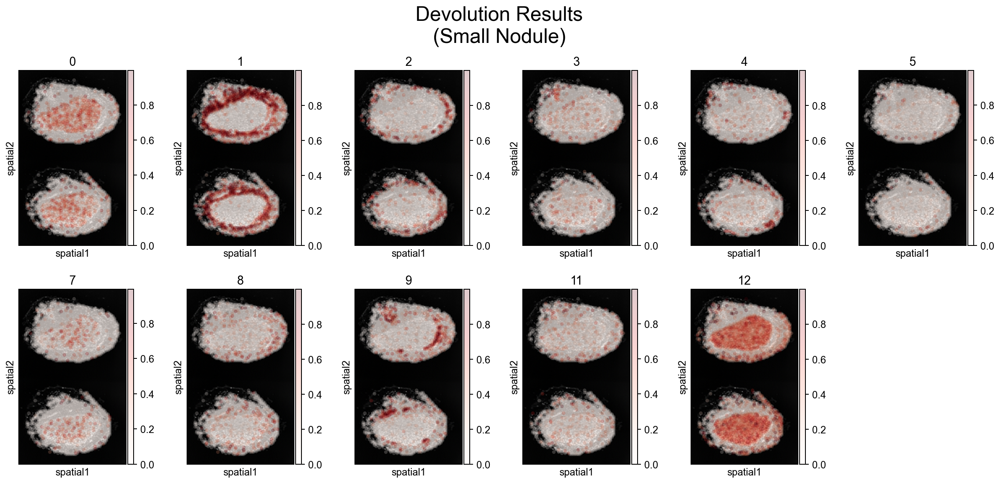

In [ ]:
with plt.rc_context({"figure.figsize": (3.5, 4)}):
    sc.pl.spatial(
        singleCellTools.plotting.obsmToObs(_ad_stSm, "proportions"),
        color=ad_st.obsm["proportions"].columns[:-1],
        size=0.2,
        cmap="Reds",
        wspace=0,
        alpha=0.2,
        ncols=6,
        show=False,
    )
    plt.suptitle("Devolution Results\n(Small Nodule)", x=0.45, y=1.02, fontsize=24)

... storing 'destVI_results' as categorical
... storing 'destVI_results_merged' as categorical


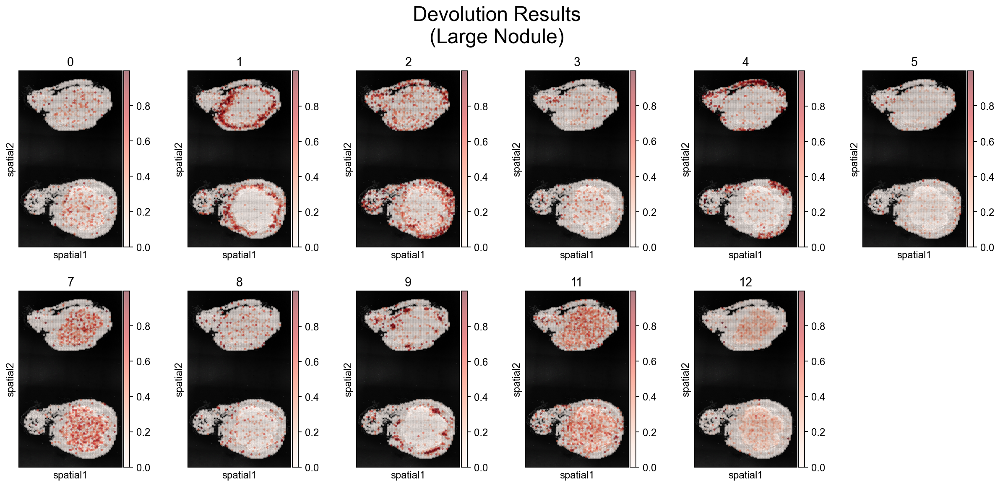

In [ ]:
with plt.rc_context({"figure.figsize": (3.5, 4)}):
    sc.pl.spatial(
        singleCellTools.plotting.obsmToObs(_ad_stLg, "proportions"),
        color=ad_st.obsm["proportions"].columns[:-1],
        size=0.2,
        cmap="Reds",
        wspace=0,
        alpha=0.5,
        ncols=6,
        show=False,
    )
    plt.suptitle("Devolution Results\n(Large Nodule)", x=0.45, y=1.02, fontsize=24)

### add cross-cut image

In [ ]:
ad_stAlign = sc.read_h5ad(f"{dir_result}/st_alignCross_0503.h5ad")

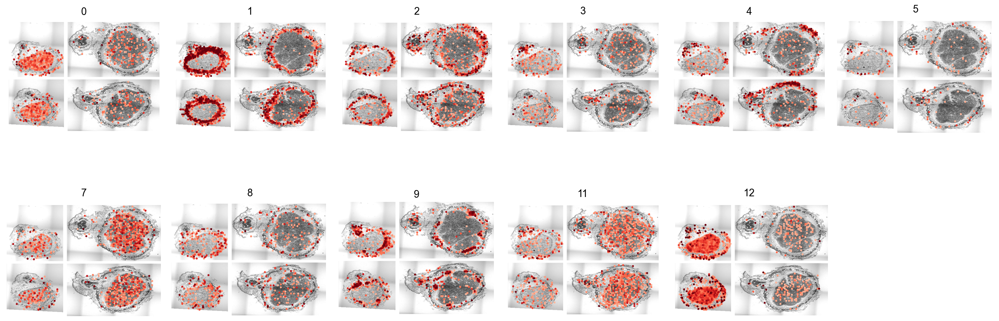

In [ ]:
fig, axs = plt.subplots(2,6, figsize=(20,8))
axs = axs.reshape(-1)
ls_useCluster = ad_stAlign.obsm['proportions'].columns[:-1]
for ax, cluster in zip(axs, ls_useCluster):
#     sc.pl.spatial(
#         ad_align,
#         size=0.075,
#         ax=ax,show=False,img_key="cross"
#     )
    _ad = singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions")
    _ad = _ad[_ad.obs[cluster] > 0.25]
    sc.pl.spatial(
        _ad,
        color=cluster,
        size=0.2,
        ax=ax,
        cmap='Reds',
        vmin=0, vmax=1,colorbar_loc=None,show=False,img_key="cross"
    )
#     ax.invert_yaxis()
    sns.despine(left=True, bottom=True)
    plt.sca(ax)
    plt.xlabel('')
    plt.ylabel('')
axs[-1].set_visible(False)
plt.tight_layout()
plt.show()

In [ ]:
# ad_stAlign.write_h5ad(f"{dir_result}/stAlignedAndCuted.h5ad")

In [ ]:
dt_cluster2Tissue = {
    "0": "Uninfected cells*",
    "1": "Inner cortex",
    "2": "Outer cortex*",
    "3": "Vascular bundle",
    "4": "Outer cortex*",
    "5": "Epidermis",
    "6": "Unknown",
    "7": "Uninfected cells*",
    "8": "Endodermis",
    "9":"Vascular bundle",
    "10":"Unknown",
    "11":"Uninfected cells*",
    "12":"Infected cells",
    "13":"Unknown",
    "14":"Unknown",
}
dt_cluster2Tissue = {x:y.rstrip('*') for x,y in dt_cluster2Tissue.items()}
dt_cluster2Tissue = {x:f"{x}\n({y})" for x,y in dt_cluster2Tissue.items()}

Text(0.5, 1.0, '12\n(Infected cells)')

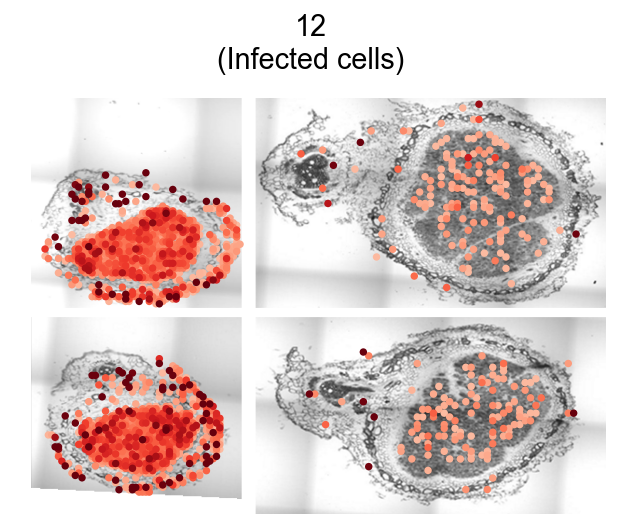

In [ ]:
_ad = singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions")
_ad = _ad[_ad.obs[cluster] > 0.25]
ax = sc.pl.spatial(
    _ad,
    color=cluster,
    size=0.2,
    cmap="Reds",
    vmin=0,
    vmax=1,
    colorbar_loc=None,
    show=False,
    img_key="cross",
)[0]
#     ax.invert_yaxis()
sns.despine(left=True, bottom=True)
plt.xlabel("")
plt.ylabel("")
plt.title(dt_cluster2Tissue[ax.get_title()])

In [ ]:
ad_stAlign = sc.read_h5ad(f"{dir_result}/stAlignedAndCuted.h5ad")

In [ ]:
ax.get_xlim(), ax.get_ylim()


((-18.346480678304268, 617.3859695561097),
 (447.6898209228389, -19.078977186801858))

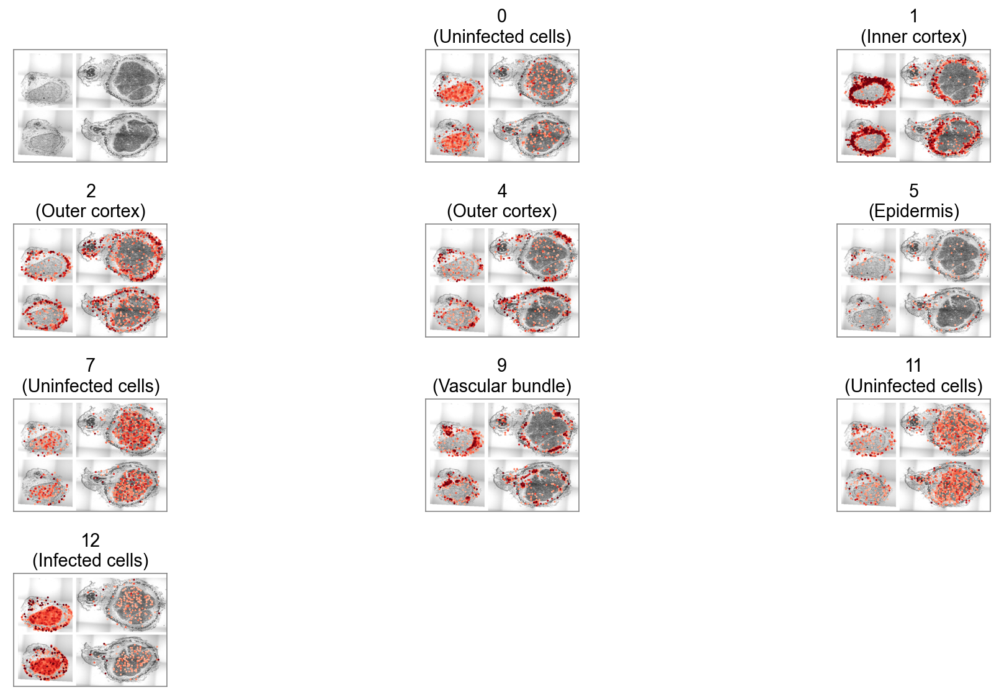

In [ ]:
fig, axs = plt.subplots(4, 3, figsize=(14, 8))
axs = axs.reshape(-1)
ls_useCluster = ad_stAlign.obsm["proportions"].columns[:-1]
for ax, cluster in zip(axs[1:], [x for x in ls_useCluster if x not in ['3', '8']]):
    #     sc.pl.spatial(
    #         ad_align,
    #         size=0.075,
    #         ax=ax,show=False,img_key="cross"
    #     )
    _ad = singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions")
    _ad = _ad[_ad.obs[cluster] > 0.25]
    sc.pl.spatial(
        _ad,
        color=cluster,
        size=0.2,
        ax=ax,
        cmap="Reds",
        vmin=0,
        vmax=1,
        colorbar_loc=None,
        show=False,
        img_key="cross",
    )
    #     ax.invert_yaxis()
    plt.sca(ax)
    plt.xlabel("")
    plt.ylabel("")
    plt.xlim(-18.346480678304268, 617.3859695561097)
    plt.ylim(447.6898209228389, -19.078977186801858)
    ax.spines['top'].set_color('grey') 
    ax.spines['right'].set_color('grey')
    ax.spines['bottom'].set_color('grey')
    ax.spines['left'].set_color('grey')
    plt.title(dt_cluster2Tissue[ax.get_title()])
ax = axs[0]
plt.sca(ax)
sc.pl.spatial(
    _ad,
    ax=axs[0],
    colorbar_loc=None,
    show=False,
    img_key="cross",
)
ax.spines['top'].set_color('grey') 
ax.spines['right'].set_color('grey')
ax.spines['bottom'].set_color('grey')
ax.spines['left'].set_color('grey')
plt.xlabel("")
plt.ylabel("")
plt.xlim(-18.346480678304268, 617.3859695561097)
plt.ylim(447.6898209228389, -19.078977186801858)

axs[-2].remove()
axs[-1].remove()
plt.tight_layout()
plt.show()

In [ ]:
from itertools import cycle

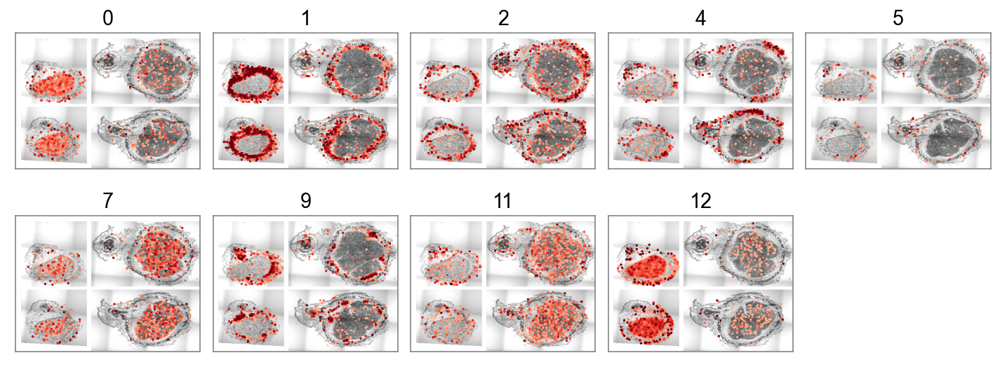

In [ ]:
colWidth = 0.115
fig, axs = plt.subplots(2, 5, figsize=(17, 4))
axs = axs.reshape(-1)
ls_useCluster = ad_stAlign.obsm["proportions"].columns[:-1]
for ax, cluster in zip(axs, [x for x in ls_useCluster if x not in ['3', '8']]):
    #     sc.pl.spatial(
    #         ad_align,
    #         size=0.075,
    #         ax=ax,show=False,img_key="cross"
    #     )
    _ad = singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions")
    _ad = _ad[_ad.obs[cluster] > 0.25]
    sc.pl.spatial(
        _ad,
        color=cluster,
        size=0.2,
        ax=ax,
        cmap="Reds",
        vmin=0,
        vmax=1,
        colorbar_loc=None,
        show=False,
        img_key="cross",
    )
    #     ax.invert_yaxis()
    plt.sca(ax)
    plt.xlabel("")
    plt.ylabel("")
    plt.xlim(-18.346480678304268, 617.3859695561097)
    plt.ylim(447.6898209228389, -19.078977186801858)
    ax.spines['top'].set_color('grey') 
    ax.spines['right'].set_color('grey')
    ax.spines['bottom'].set_color('grey')
    ax.spines['left'].set_color('grey')
#     plt.title(dt_cluster2Tissue[ax.get_title()])
plt.tight_layout()
for ax, icol in zip(axs, cycle([0,1,2,3,4])):
    pos = ax.get_position()
    ax.set_position([colWidth * icol, pos.y0, pos.x1 - pos.x0, pos.y1-pos.y0])
axs[-1].remove()
plt.show()

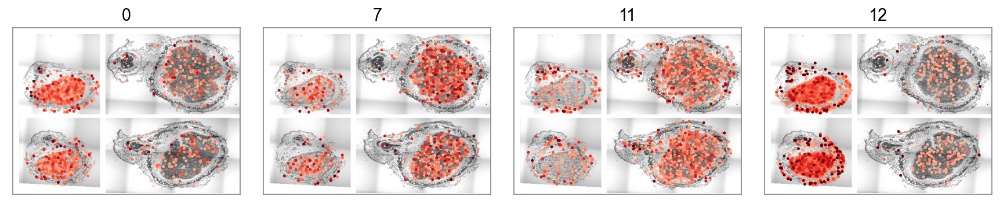

In [ ]:
colWidth = 0.25
fig, axs = plt.subplots(1, 4, figsize=(12, 3))
axs = axs.reshape(-1)
ls_useCluster = ad_stAlign.obsm["proportions"].columns[:-1]
for ax, cluster in zip(axs, [x for x in ["0", "7", "11", "12"]]):
    #     sc.pl.spatial(
    #         ad_align,
    #         size=0.075,
    #         ax=ax,show=False,img_key="cross"
    #     )
    _ad = singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions")
    _ad = _ad[_ad.obs[cluster] > 0.25]
    sc.pl.spatial(
        _ad,
        color=cluster,
        size=0.2,
        ax=ax,
        cmap="Reds",
        vmin=0,
        vmax=1,
        colorbar_loc=None,
        show=False,
        img_key="cross",
    )
    #     ax.invert_yaxis()
    plt.sca(ax)
    plt.xlabel("")
    plt.ylabel("")
    plt.xlim(-18.346480678304268, 617.3859695561097)
    plt.ylim(447.6898209228389, -19.078977186801858)
    ax.spines['top'].set_color('grey') 
    ax.spines['right'].set_color('grey')
    ax.spines['bottom'].set_color('grey')
    ax.spines['left'].set_color('grey')
#     plt.title(dt_cluster2Tissue[ax.get_title()])
plt.tight_layout()
for ax, icol in zip(axs, cycle([0,1,2,3])):
    pos = ax.get_position()
    ax.set_position([colWidth * icol, pos.y0, pos.x1 - pos.x0, pos.y1-pos.y0])
plt.show()

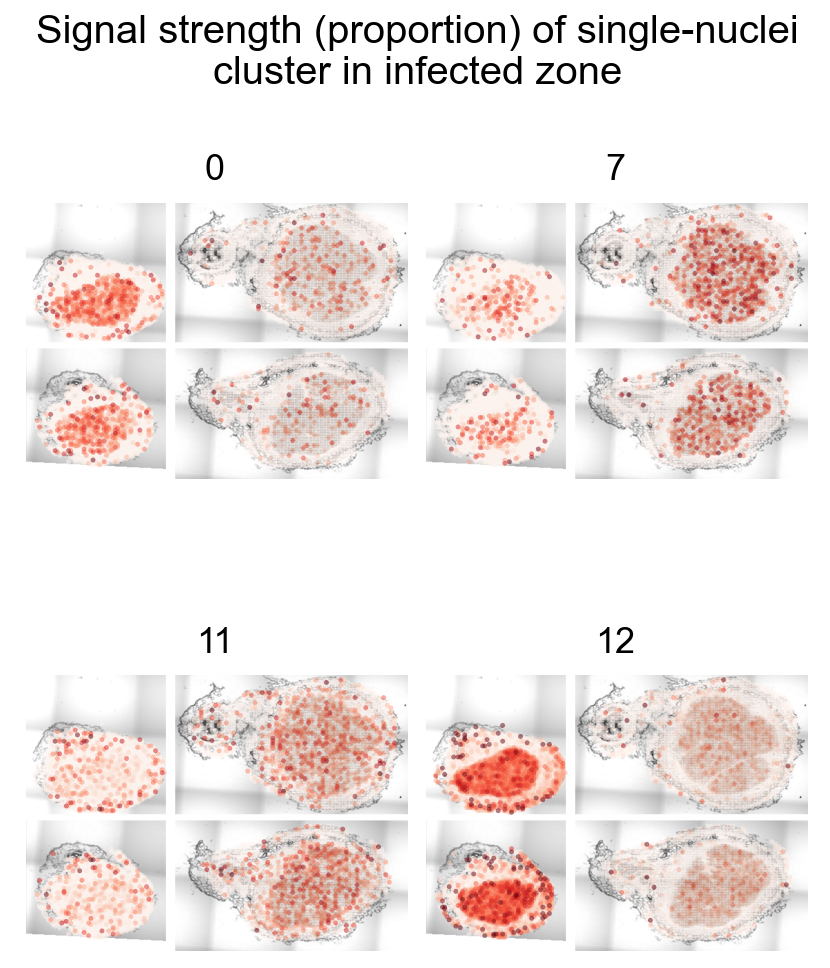

In [ ]:
with plt.rc_context({"figure.figsize": (3.5, 4)}):
    axs = sc.pl.spatial(
        singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions"),
        color=["0", "7", "11", "12"],
        size=0.2,
        cmap="Reds",
        wspace=0,
        hspace=0,
        alpha=0.5,
        ncols=2,
        show=False,
        colorbar_loc=None,
        img_key="cross",
    )
    for ax in axs:
        plt.sca(ax)
        plt.xlabel("")
        plt.ylabel("")
        sns.despine(left=True, bottom=True)
        plt.title(ax.get_title(), fontdict=dict(size=18))
    plt.suptitle(
        "Signal strength (proportion) of single-nuclei\ncluster in infected zone",
        x=0.5,
        y=0.96,
        fontsize=20,
    )
    plt.show()

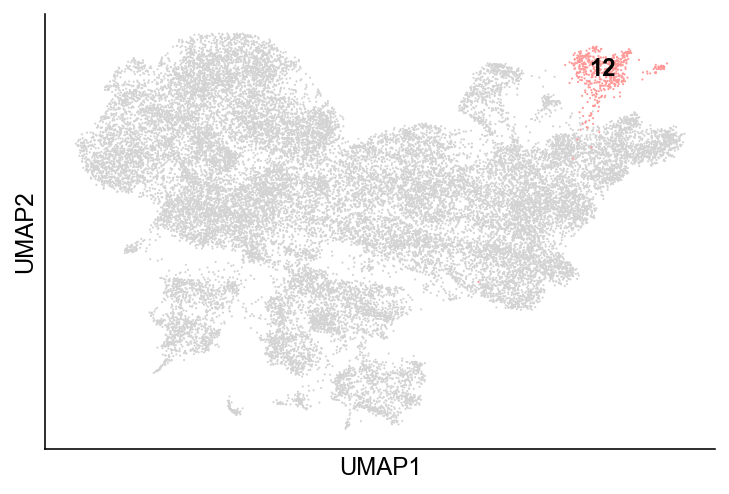

In [ ]:
# fig, ax = plt.subplots(figsize=(6, 3))
_ls = ['12']
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False, groups = _ls)
# sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", groups=[dt_cluster2Tissue[x] for x in _ls], na_in_legend=False, legend_loc=None)
sns.despine(top=True, right=True)
# plt.legend(loc="upper left", bbox_to_anchor=(0, -0.1), ncol=2, frameon=False)
plt.title("")

plt.show()

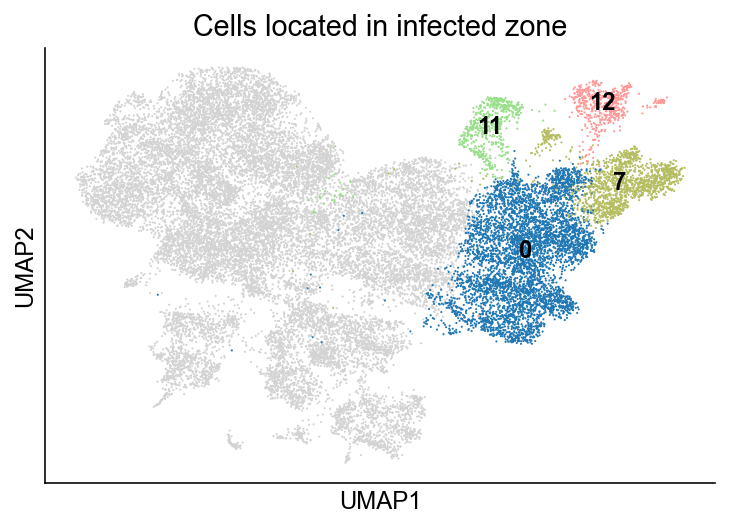

In [ ]:
# fig, ax = plt.subplots(figsize=(6, 3))
_ls = ['0', '7', '11', '12']
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False, groups = _ls)
# sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", groups=[dt_cluster2Tissue[x] for x in _ls], na_in_legend=False, legend_loc=None)
sns.despine(top=True, right=True)
# plt.legend(loc="upper left", bbox_to_anchor=(0, -0.1), ncol=2, frameon=False)
plt.title("Cells located in infected zone")
plt.show()

#### figure 1a

In [ ]:
ad_stLarge = ad_stAlign[ad_stAlign.obs.eval("batch == 'lg2'")]

Text(0, 0.5, '')

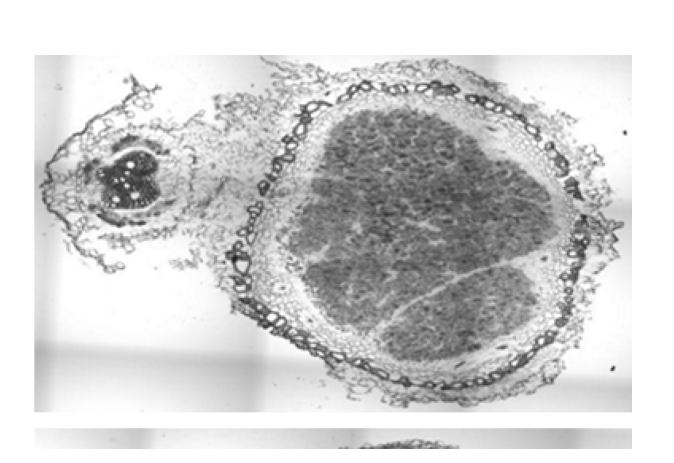

In [ ]:
sc.pl.spatial(
    ad_stLarge,
    colorbar_loc=None,
    show=False,
    img_key="cross",
)
sns.despine(left=True, bottom=True)
plt.xlabel("")
plt.ylabel("")

In [ ]:
dt_mergeStPropotion = {
    "0": ["0", "12", "7", "11"],
    "1": ["1"],
    "2": ["2", "4"],
    "3": ["9"],
}

In [ ]:
def mergePropotion(line):
    
    dt_finalPropotion = {}
    for mergedCluster, ls_elementCluster in dt_mergeStPropotion.items():
        dt_finalPropotion[mergedCluster] = 0
        for element in ls_elementCluster:
            dt_finalPropotion[mergedCluster] += line.at[element]
    return pd.Series(dt_finalPropotion).rename(line.name)
                

In [ ]:
ls_results = []
for _, line in ad_stLarge.obsm["proportions"].iterrows():
    ls_results.append(mergePropotion(line))

In [ ]:
ad_stLarge.obsm['propotion_merged'] = pd.concat(ls_results, axis=1).T

In [ ]:
ad_stLarge.obs['propotion_merged'] = np.where(
    ad_stLarge.obsm["propotion_merged"].max(1) > 0.5,
    ad_stLarge.obsm["propotion_merged"].idxmax(1),
    None,
)

In [ ]:
_dt_color = singleCellTools.basic.getadataColor(ad, 'Cluster')

In [ ]:
singleCellTools.basic.setadataColor(ad_stLarge, 'propotion_merged', _dt_color);

Text(0, 0.5, '')

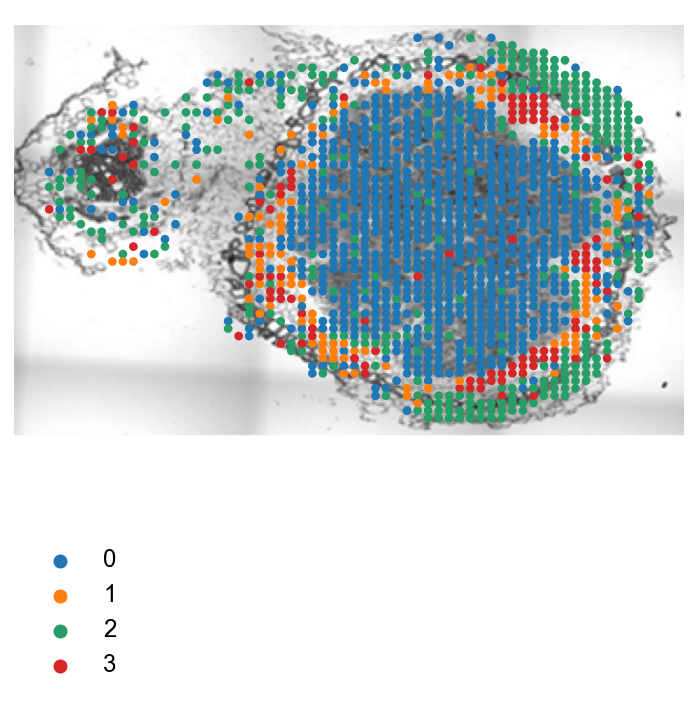

In [ ]:
sc.pl.spatial(
    ad_stLarge,
    color="propotion_merged",
    title='',
    size=0.12,
    show=False,
    img_key="cross", na_in_legend=False
)
plt.legend(ncol=1, loc='upper left', bbox_to_anchor=(0,-0.2), frameon=False)
sns.despine(left=True, bottom=True)
plt.xlabel("")
plt.ylabel("")

# st data clustering

In [ ]:
ad_stAlign = sc.read_h5ad(f"{dir_result}/stAlignedAndCuted.h5ad")

In [ ]:
ad_stAlign.obs['imagecol'] = ad_stAlign.obsm['spatial'][:, 0]
ad_stAlign.obs['imagerow'] = ad_stAlign.obsm['spatial'][:, 1]

In [ ]:
ad_stSm = ad_stAlign[ad_stAlign.obs.eval("Sample == 'Small Nodule'")]
ad_stLg = ad_stAlign[ad_stAlign.obs.eval("Sample == 'Large Nodule'")]

In [ ]:
so_stSm = singleCellTools.normalize.normalizeBySCT_r(ad_stSm)
so_stLg = singleCellTools.normalize.normalizeBySCT_r(ad_stLg)

R[write to console]: Warning:
R[write to console]:  Feature names cannot have underscores ('_'), replacing with dashes ('-')

R[write to console]: Warning:
R[write to console]:  Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_scvi_total_ to umapscvitotal_

R[write to console]: Warning:
R[write to console]:  All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to umapscvitotal_

R[write to console]: Warning:
R[write to console]:  Adding a Graph without an assay associated with it

R[write to console]: Warning:
R[write to console]:  Adding a Graph without an assay associated with it

R[write to console]: vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

R[write to console]: Calculating cell attributes from input UMI matrix: log_umi

R[write to console]: Total Step 1 genes: 21116

R[write to console]: Total overdispersed genes: 20883

R[write to console]: Exclud

  |======================================================================| 100%


R[write to console]: Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

R[write to console]: # of step1 poisson genes (variance < mean): 0

R[write to console]: # of low mean genes (mean < 0.001): 0

R[write to console]: Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

R[write to console]: Total # of poisson genes (theta=Inf; variance < mean): 233

R[write to console]: Calling offset model for all 233 poisson genes

R[write to console]: Ignoring theta inf genes

R[write to console]: Replacing fit params for 233 poisson genes by theta=Inf

R[write to console]: Setting min_variance based on median UMI:  0.16

R[write to console]: Second step: Get residuals using fitted parameters for 21116 genes



  |======================================================================| 100%


R[write to console]: Computing corrected count matrix for 21116 genes



  |======================================================================| 100%


R[write to console]: Calculating gene attributes

R[write to console]: Wall clock passed: Time difference of 1.582168 mins

R[write to console]: Determine variable features

R[write to console]: Place corrected count matrix in counts slot

R[write to console]: Centering data matrix

  |                                                                            
  |                                                                      |   0%
  |                                                                            
  |==                                                                    |   3%
  |                                                                            
  |=====                                                                 |   7%
  |                                                                            
  |=======                                                               |  10%
  |                                                                         

  |======================================================================| 100%


R[write to console]: Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

R[write to console]: # of step1 poisson genes (variance < mean): 0

R[write to console]: # of low mean genes (mean < 0.001): 0

R[write to console]: Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

R[write to console]: Total # of poisson genes (theta=Inf; variance < mean): 280

R[write to console]: Calling offset model for all 280 poisson genes

R[write to console]: Found 1 outliers - those will be ignored in fitting/regularization step


R[write to console]: Ignoring theta inf genes

R[write to console]: Replacing fit params for 280 poisson genes by theta=Inf

R[write to console]: Setting min_variance based on median UMI:  0.04

R[write to console]: Second step: Get residuals using fitted parameters for 15833 genes



  |======================================================================| 100%


R[write to console]: Computing corrected count matrix for 15833 genes



  |======================================================================| 100%


R[write to console]: Calculating gene attributes

R[write to console]: Wall clock passed: Time difference of 1.024059 mins

R[write to console]: Determine variable features

R[write to console]: Place corrected count matrix in counts slot

R[write to console]: Centering data matrix

  |                                                                            
  |                                                                      |   0%
  |                                                                            
  |===                                                                   |   5%
  |                                                                            
  |======                                                                |   9%
  |                                                                            
  |==========                                                            |  14%
  |                                                                         

In [ ]:
ad_stBc = ad_stAlign.copy()

In [ ]:
ad_stSm = ad_stSm[:, ad_stSm.uns["SCT_data_features"] >> F(map, lambda x:x.replace("-", "_")) >> F(list)]
ad_stLg = ad_stLg[:, ad_stLg.uns["SCT_data_features"] >> F(map, lambda x:x.replace("-", "_")) >> F(list)]

In [ ]:
ad_stSm.layers['SCT_counts'] = so_stSm["SCT"].layers['SCT_counts']
ad_stLg.layers['SCT_counts'] = so_stLg["SCT"].layers['SCT_counts']

ad_stSm.layers['SCT_scale.data'] = so_stSm['SCT_scale.data'].layers['SCT_scale.data']
ad_stLg.layers['SCT_scale.data'] = so_stLg['SCT_scale.data'].layers['SCT_scale.data']

In [ ]:
ad_stAlign = sc.concat([ad_stSm, ad_stLg], uns_merge="first")

In [ ]:
n_inducing = 1000

In [ ]:
sc.pp.highly_variable_genes(ad_stAlign, flavor="seurat_v3", n_top_genes=3000, batch_key='Sample', layer='raw')

In [ ]:
mu.tl.mofa(ad_stAlign, groups_label='Sample', n_factors=5, 
           use_layer='SCT_scale.data',
           center_groups=False,
           smooth_covariate=["imagerow", "imagecol"],
           smooth_kwargs={
               "sparseGP": True, "frac_inducing": n_inducing/ad_stAlign.n_obs,
               "start_opt": 10, "opt_freq": 10,
           },
           use_float32=True, seed=39,
           quiet=False)


        #########################################################
        ###           __  __  ____  ______                    ### 
        ###          |  \/  |/ __ \|  ____/\    _             ### 
        ###          | \  / | |  | | |__ /  \ _| |_           ### 
        ###          | |\/| | |  | |  __/ /\ \_   _|          ###
        ###          | |  | | |__| | | / ____ \|_|            ###
        ###          |_|  |_|\____/|_|/_/    \_\              ###
        ###                                                   ### 
        ######################################################### 
       
 
        
use_float32 set to True: replacing float64 arrays by float32 arrays to speed up computations...

Loaded view='data' group='Small Nodule' with N=3574 samples and D=3000 features...
Loaded view='data' group='Large Nodule' with N=4100 samples and D=3000 features...


Model options:
- Automatic Relevance Determination prior on the factors: True
- Automatic Relevance Determination pr

AttributeError: 'AnnData' object has no attribute 'mod'

In [ ]:
ad_stAlign = loadPkl('ad_stAlign_20221008_mefisto', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_result)

In [ ]:
sc.pp.neighbors(ad_stAlign, use_rep='X_mofa', n_neighbors=15)
sc.tl.umap(ad_stAlign, 0.3)

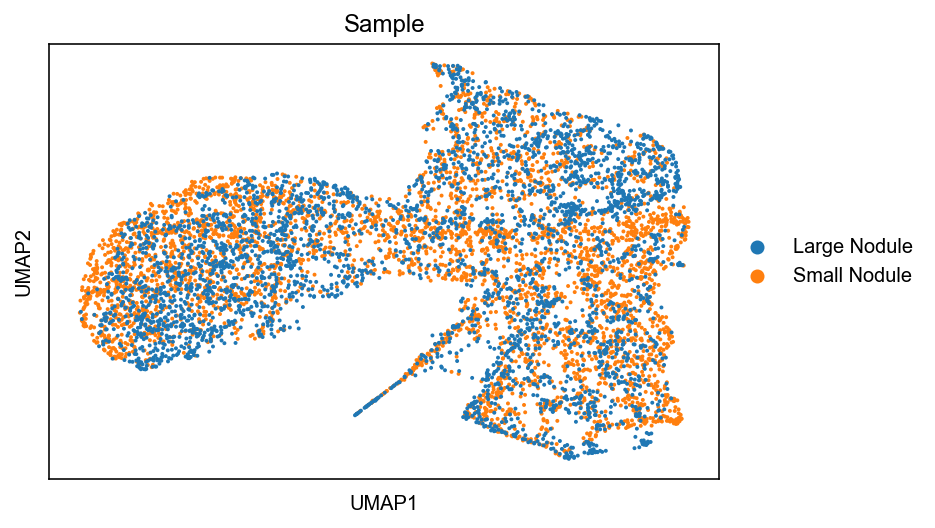

In [ ]:
sc.pl.umap(ad_stAlign, color='Sample')

In [ ]:
sc.tl.leiden(ad_stAlign, 0.2)

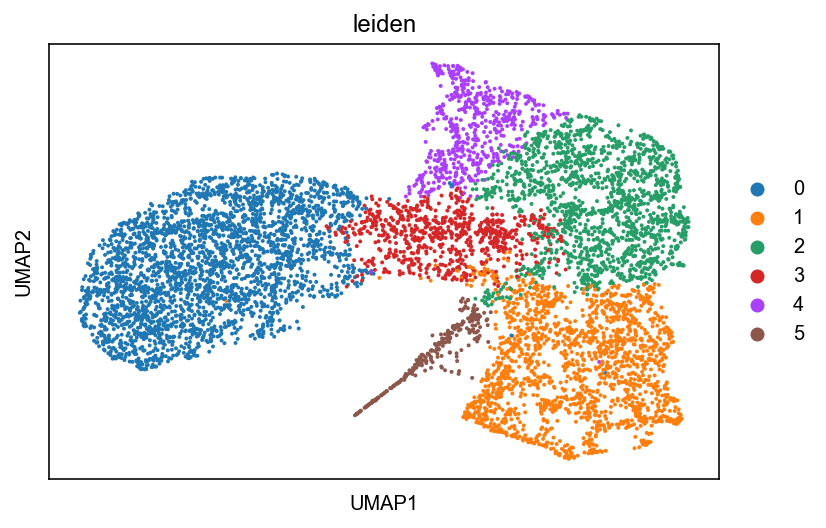

In [ ]:
sc.pl.umap(ad_stAlign, color='leiden')

Text(0, 0.5, '')

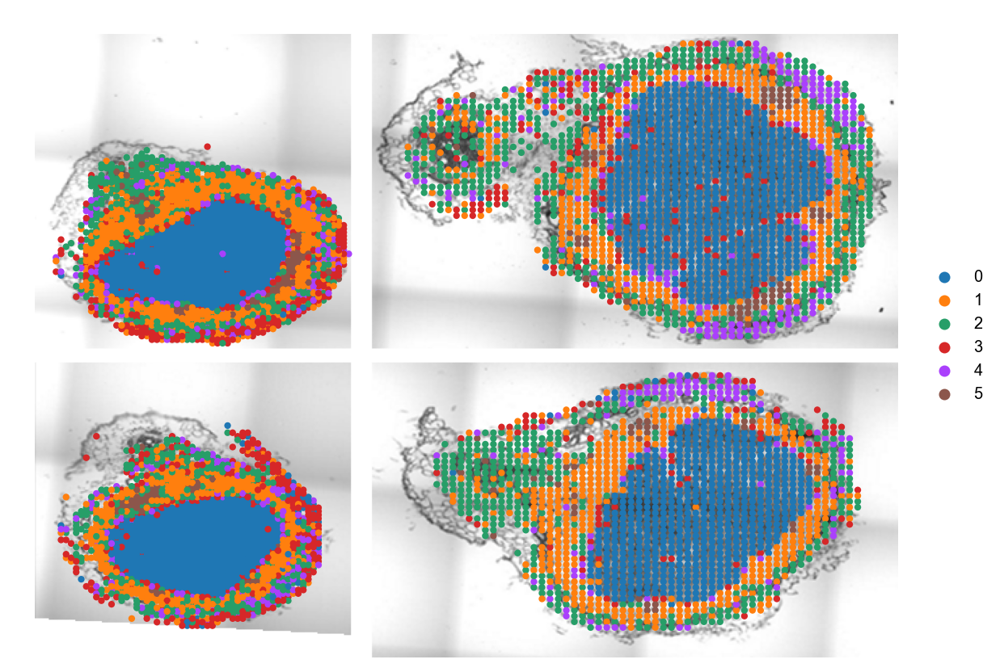

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
sc.pl.spatial(
    ad_stAlign,
    color="leiden",
    title='',
    size=0.12,
    show=False,
    # alpha=0.75,
    img_key="cross", na_in_legend=False,
    ax=ax
)
# plt.legend(ncol=1, loc='upper left', bbox_to_anchor=(0,-0.2), frameon=False)
sns.despine(left=True, bottom=True)
plt.xlabel("")
plt.ylabel("")

In [ ]:
dt_stAnno = {"0": "0: Infected Zone", "1": "1: Inner Cortex", "2": "2: Outer Cortex", "3": "3: Epidermis", "4": "4: Outer Cortex", "5": "5: Vascular Bundle"}
ad_stAlign.obs["annotation"] = ad_stAlign.obs["leiden"].map(dt_stAnno)

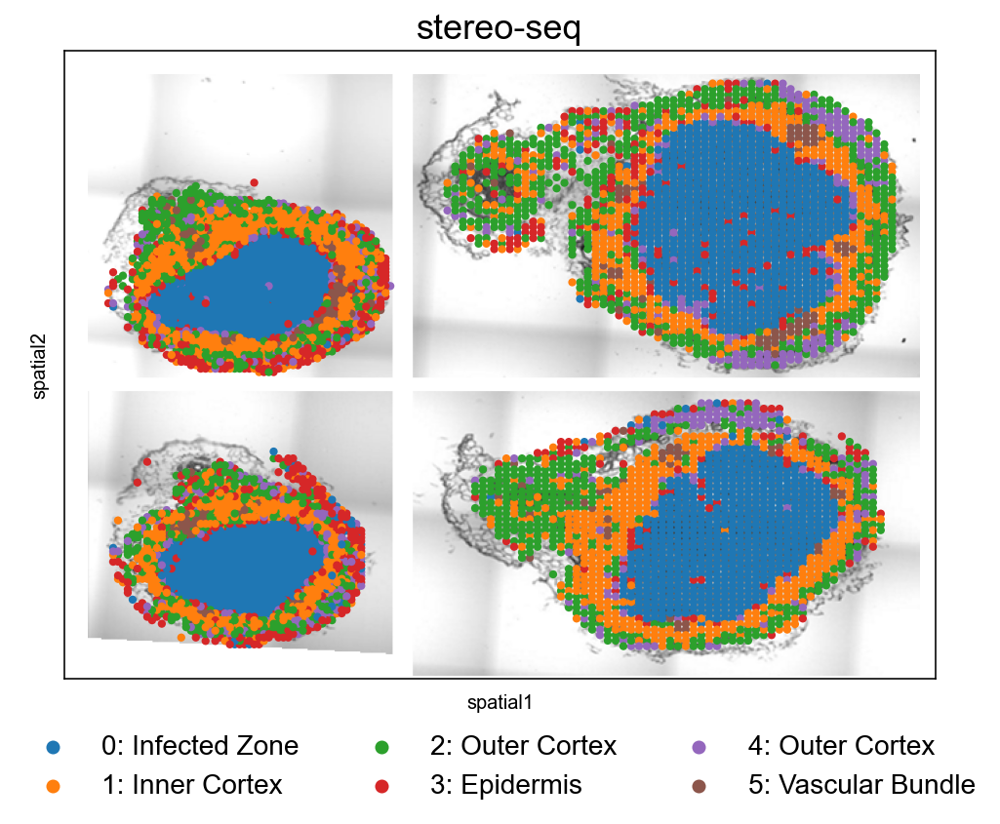

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(8, 6))
sc.pl.spatial(
    ad_stAlign,
    color="annotation",
    title='',
    size=0.15,
    show=False,
    # alpha=0.75,
    img_key="cross", na_in_legend=False,
    ax=ax
)
plt.legend(ncol=3, loc='upper center', bbox_to_anchor=(0.5,-0.05), frameon=False, fontsize=14)
plt.title("stereo-seq", fontsize=18)
plt.savefig("/public/home/liuzj/share/scSoybean/allSpatial_sample/leiden.png", dpi=300, bbox_inches='tight')

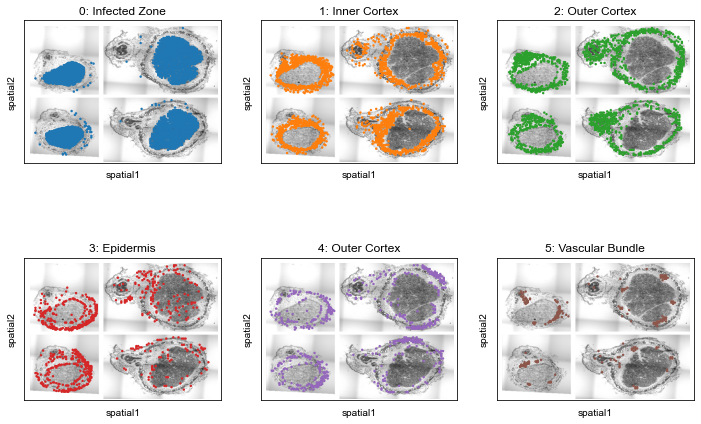

In [ ]:
fig, axs = plt.subplots(2, 3, figsize=(12,8))
axs = axs.reshape(-1)
for ax, ct in zip(axs, dt_stAnno.values()):
    sc.pl.spatial(
        ad_stAlign,
        color="annotation",
        title=ct,
        groups=[ct],
        size=0.2,
        show=False,
        # alpha=0.75,
        img_key="cross", 
        legend_loc=None,
        na_in_legend=False,
        ax=ax
    )

In [ ]:
# toPkl(ad_stAlign, 'ad_stAlign_20221013_mefisto_anno', 'ipf', dir_path=dir_result)

2022-10-13 16:30:48.102 | INFO     | jpy_tools.otherTools:toPkl:477 - please run `loadPkl('ad_stAlign_20221013_mefisto_anno', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


In [ ]:
ad_stAlign = loadPkl('ad_stAlign_20221013_mefisto_anno', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_result)

## get spec genes

In [ ]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad_stAlign, 'raw', 'leiden')

In [ ]:
dt_stSpecGenes = ad_stAlign.uns['leiden_cellexES'].query(
    "enrichScore > 0.75 & expressed_ratio / expressed_ratio_others > 2"
).groupby('leiden')['gene'].agg(list).to_dict()

In [ ]:
# ad_stAlign.uns['leiden_cellexES'].query(
#     "enrichScore > 0.75 & expressed_ratio / expressed_ratio_others > 2"
# ).to_excel(f"{dir_result}/stereoseq_spec_genes.xlsx")

In [ ]:
df_stSpecGenes = ad_stAlign.uns['leiden_cellexES'].query(
    "enrichScore > 0.75 & expressed_ratio / expressed_ratio_others > 2"
)

In [ ]:
df_stSpecGenes.merge(df_symbol, how="left", left_on="gene", right_index=True).eval(
    "Symbol = Symbol.fillna('') \n other_designations = other_designations.fillna('')",
    engine="python",
).to_excel(f"{dir_result}/stereoseq_spec_genes.xlsx")

In [ ]:
_str = """GLYMA_05G244700 GLYMA_05G151300 GLYMA_11G185200 GLYMA_13G024500 GLYMA_18G036300
GLYMA_06G182700 GLYMA_20G203800
GLYMA_03G185900 GLYMA_09G093000 GLYMA_20G241600
GLYMA_05G220500 GLYMA_09G092700 GLYMA_12G217300 GLYMA_17G139700  GLYMA_17G019300
GLYMA_02G160500 GLYMA_02G003700  GLYMA_02G135100  GLYMA_06G310700"""
_ls = _str >> F(lambda x:x.split('\n')) >> F(map, str.split) >> F(list)
dt_stMarkerGeneExample = {x:y for x,y in zip(["0: Infected Zone", "1: Inner Cortex", "2: Outer Cortex", "4: Outer Cortex", "5: Vascular Bundle"], _ls)}

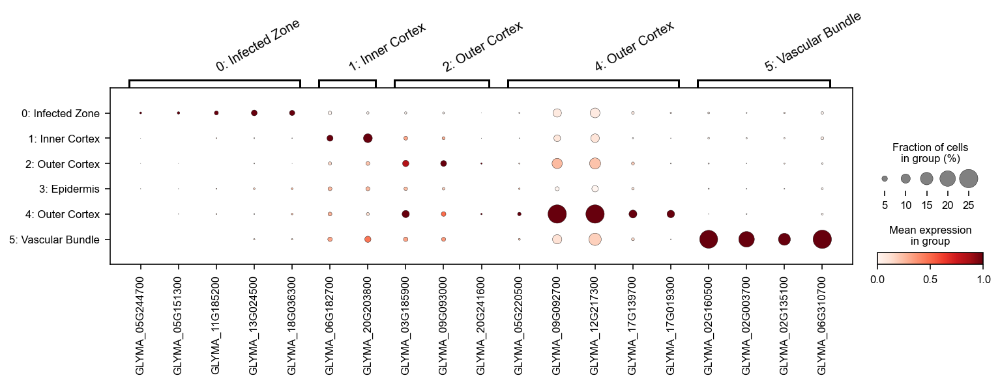

In [ ]:
axs = sc.pl.dotplot(ad_stAlign, dt_stMarkerGeneExample, groupby='annotation', cmap='Reds', layer='normalize_log', standard_scale='var', dot_max=0.25, figsize=(12,2.5), show=False)
ax = axs['gene_group_ax']
plt.sca(ax)
ax = axs['gene_group_ax']
for text in ax.texts:
    text.set(rotation=30, ha='left')

In [ ]:
# _ls = ['12','0', '7', '11', '1', '4','2', '3','9', '5', '6', '8','10', '13', '14']
_ls = ['12','0', '7', '11', '1', '4','2', '3','9', '5']

In [ ]:
_ad = ad[ad.obs.eval("Cluster in @_ls")].copy()
_ad.obs['Cluster'] = _ad.obs['Cluster'].cat.set_categories(_ls)

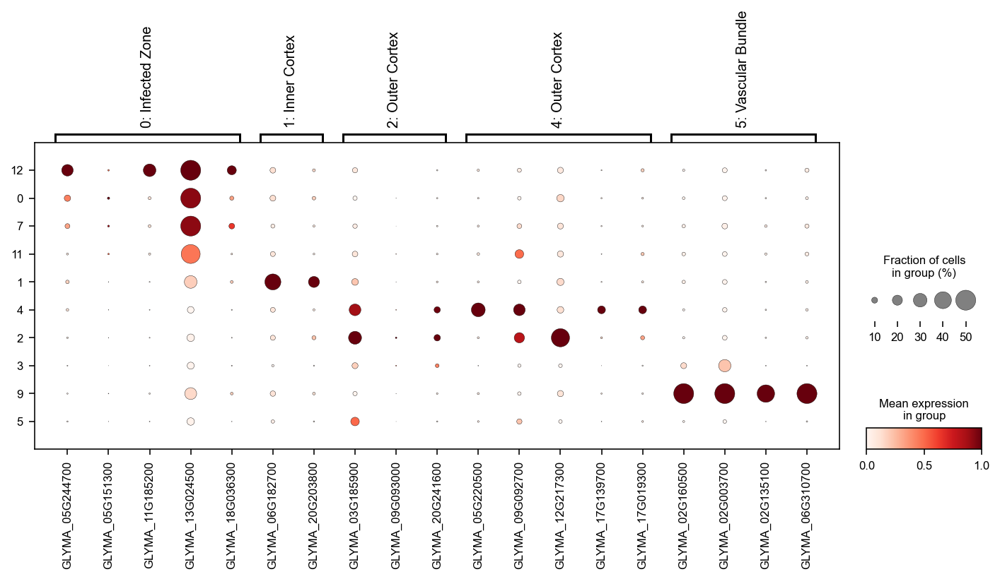

In [ ]:
sc.pl.dotplot(_ad, dt_stMarkerGeneExample, groupby='Cluster', cmap='Reds', layer='normalize_log', standard_scale='var', dot_max=0.5, figsize=(12,4))

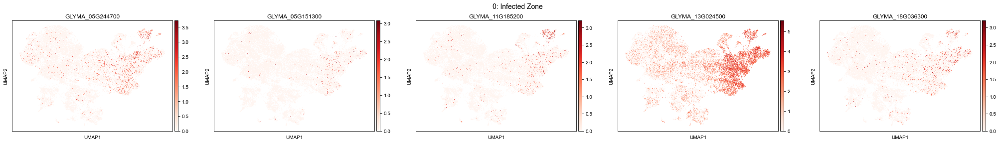

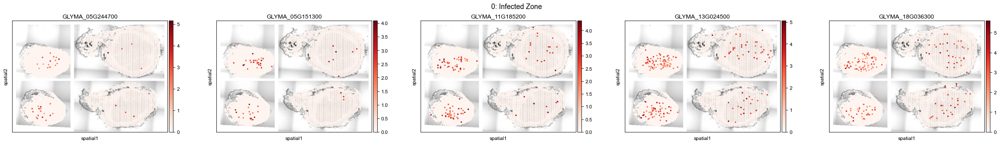

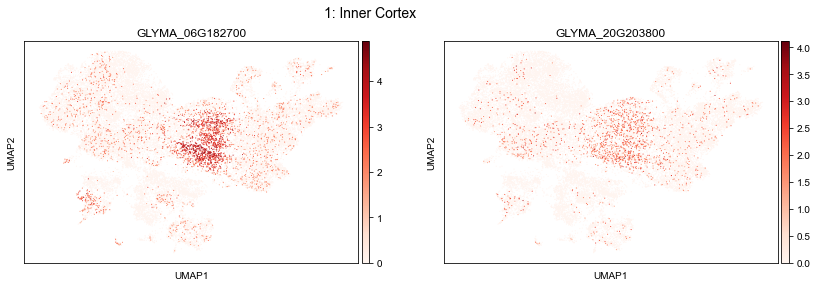

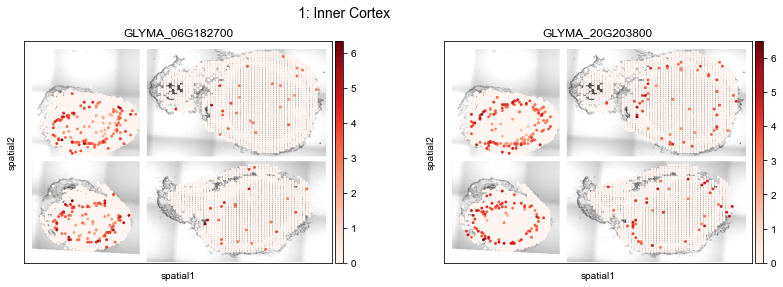

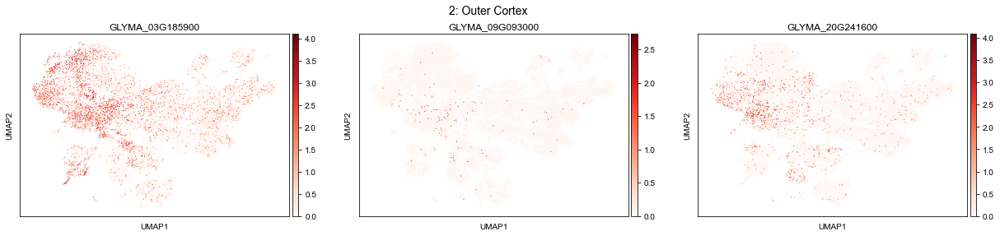

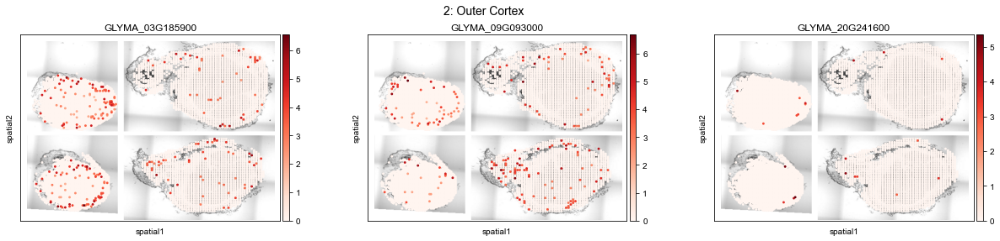

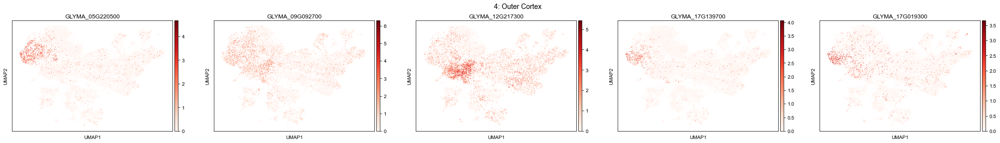

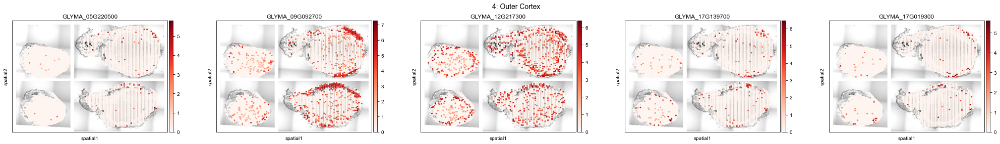

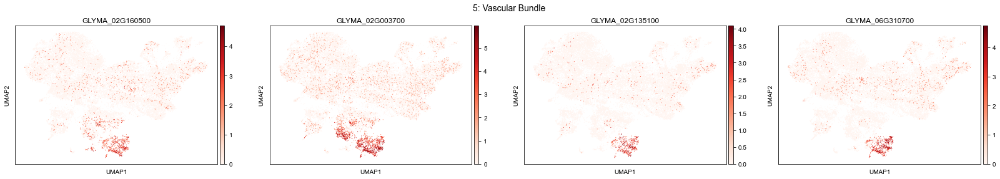

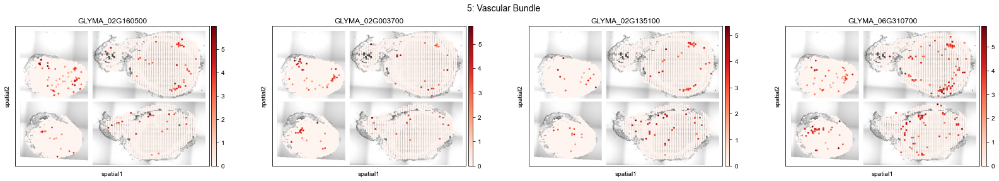

In [ ]:
for ct, ls_genes in dt_stMarkerGeneExample.items():
    ax = sc.pl.umap(ad, color=ls_genes, layer='normalize_log', cmap='Reds', ncols=5, show=False)
    plt.suptitle(ct, x=0.45, y=1.02, fontsize=14)
    plt.show()
    sc.pl.spatial(
        ad_stAlign,
        color=ls_genes,
        size=0.15,
        show=False,
        # alpha=0.75,
        img_key="cross", na_in_legend=False,
        layer='normalize_log', cmap='Reds', ncols=5
    )
    plt.suptitle(ct, x=0.45, y=1.02, fontsize=14)
    plt.show()

# final annotation

In [ ]:
# dt_cluster2Tissue = {
#     "0": "Cortex",
#     "1": "Cortex",
#     "2": "Unknown",
#     "3": "Stele",
#     "4": "Unknown",
#     "5": "Epidermis",
#     "6": "Cortex",
#     "7": "Cortex",
#     "8": "Endodermis",
#     "9":"Stele",
#     "10":"Cortex",
#     "11":"Unknown",
#     "12":"Infected zone",
#     "13":"Unknown",
#     "14":"Unknown",
# }
# dt_cluster2Tissue = {x:f"{x}: {y}" for x,y in dt_cluster2Tissue.items()}
# ad.obs['Cell type'] = ad.obs['Cluster'].map(dt_cluster2Tissue)
dt_cluster2Tissue = {
    "0": "Uninfected cells*",
    "1": "Inner cortex",
    "2": "Outer cortex*",
    "3": "Vascular bundle",
    "4": "Outer cortex*",
    "5": "Epidermis",
    "6": "Unknown",
    "7": "Uninfected cells*",
    "8": "Unknown",
    "9":"Vascular bundle",
    "10":"Unknown",
    "11":"Uninfected cells*",
    "12":"Infected cells",
    "13":"Unknown",
    "14":"Unknown",
}
dt_cluster2Tissue = {x:f"{x}: {y}" for x,y in dt_cluster2Tissue.items()}
ad.obs['Cell type'] = ad.obs['Cluster'].map(dt_cluster2Tissue)

In [ ]:
dt_cluster2Tissue = {
    "0": "Cells in infected zone*",
    "1": "Inner cortex",
    "2": "Outer cortex*",
    "3": "Vascular bundle",
    "4": "Outer cortex*",
    "5": "Epidermis",
    "6": "Unknown",
    "7": "Cells in infected zone*",
    "8": "Unknown",
    "9":"Vascular bundle",
    "10":"Unknown",
    "11":"Cells in infected zone*",
    "12":"Infected cells",
    "13":"Unknown",
    "14":"Unknown",
}
dt_cluster2Tissue = {x:f"{x}: {y}" for x,y in dt_cluster2Tissue.items()}
ad.obs['Cell type'] = ad.obs['Cluster'].map(dt_cluster2Tissue)

In [ ]:
%config InlineBackend.figure_format = 'png'


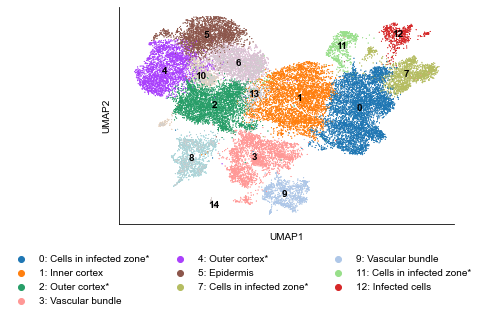

In [ ]:
# fig, ax = plt.subplots(figsize=(6, 3))
_ls = range(15) | F(map, str) | F(filter, lambda x: x not in ['6', '8', '10', '13', '14']) | F(list)
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", groups=[dt_cluster2Tissue[x] for x in _ls], na_in_legend=False)

# ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
# sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="")
plt.legend(loc="upper left", bbox_to_anchor=(-0.35, -0.1), ncol=3, frameon=False)
# plt.title("Single-nucleus transcriptomes")
sns.despine()
plt.show()

In [ ]:
ad.obs['Sample_two'] = ad.obs['Sample'].map(lambda x:x.split(' ')[-1])

In [ ]:
singleCellTools.basic.getadataColor(ad, 'Sample')

{'Large Nodule': '#1f77b4', 'Small Nodule': '#ff7f0e', 'Root': '#2ca02c'}

In [ ]:
_ls = (
    [x for x in ad.obs["Cell type"].unique() if ("*" not in x) & ("Unknown" not in x)]
    | F(map, lambda x: x.split(":")[0])
) | F(list)

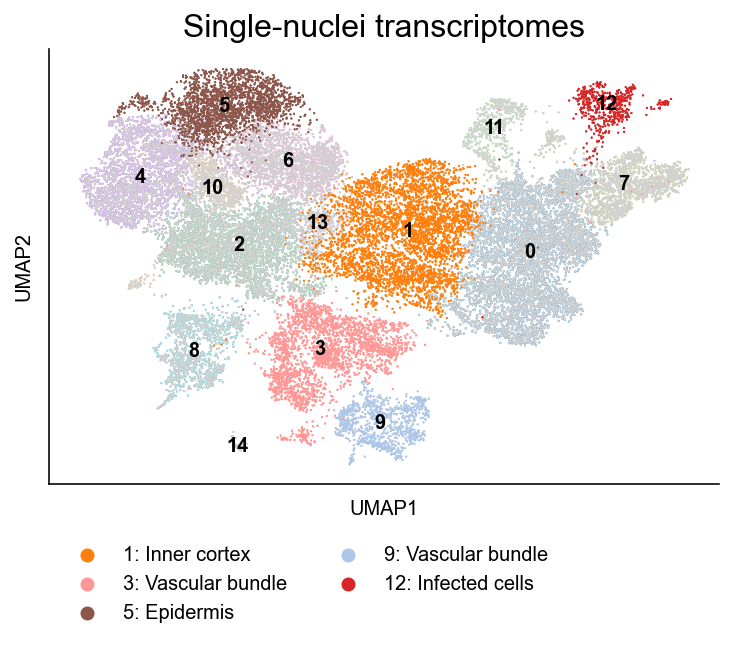

In [ ]:
# fig, ax = plt.subplots(figsize=(6, 3))
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", groups=[dt_cluster2Tissue[x] for x in _ls], na_in_legend=False)
sns.despine(top=True, right=True)
plt.legend(loc="upper left", bbox_to_anchor=(0, -0.1), ncol=2, frameon=False)
plt.title("Single-nuclei transcriptomes", fontsize=16)
plt.show()

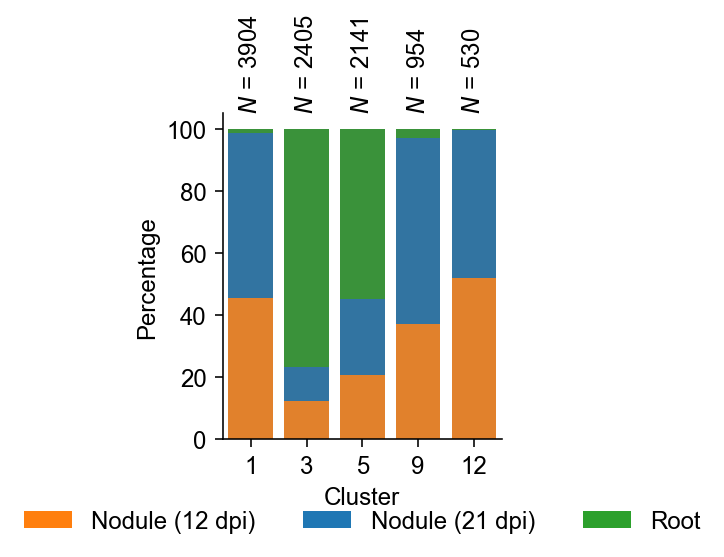

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

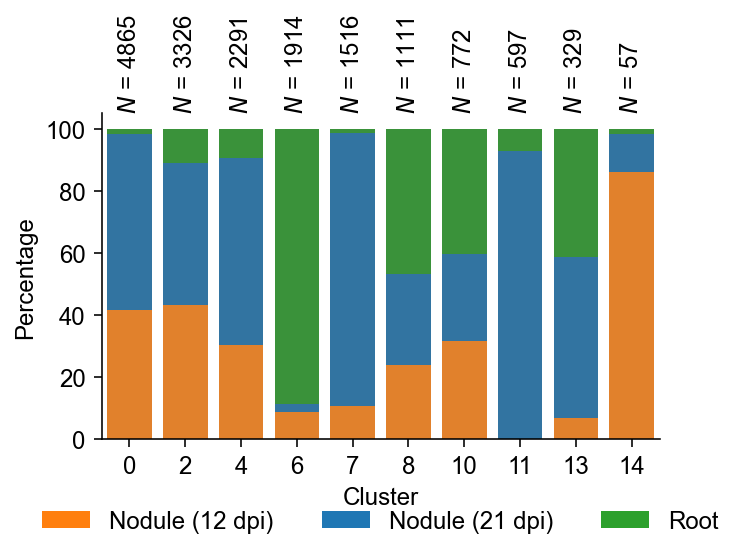

In [ ]:
_ls = (
    [x for x in ad.obs["Cell type"].unique() if ("*" not in x) & ("Unknown" not in x)]
    | F(map, lambda x: x.split(":")[0])
) | F(list)
fig,ax=plt.subplots(figsize=(2.5,3))
singleCellTools.plotting.plotLabelPercentageInCluster(
    ad[ad.obs.eval("Cluster in @_ls")],
    "Cluster",
    "Sample_time",
    dt_kwargsForLegend={"ncol": 3, "bbox_to_anchor": [0.5, -0.15], 'loc':'upper center'},
)
plt.show()
fig,ax=plt.subplots(figsize=(5,3))
singleCellTools.plotting.plotLabelPercentageInCluster(
    ad[ad.obs.eval("Cluster not in @_ls")],
    "Cluster",
    "Sample_time",
    dt_kwargsForLegend={"ncol": 3, "bbox_to_anchor": [0.5, -0.15], 'loc':'upper center'},
)

In [ ]:
import importlib
importlib.reload(singleCellTools.plotting)

<module 'jpy_tools.singleCellTools.plotting' from '/public/home/liuzj/softwares/anaconda3/lib/python3.8/site-packages/jpy_tools/singleCellTools/plotting.py'>

In [ ]:
ad.obs['Sample_time']

AAACCCAAGACGCAGT-1-batch-nodule_large    Nodule (21 dpi)
AAACCCAAGAGGATCC-1-batch-nodule_large    Nodule (21 dpi)
AAACCCACAAATACAG-1-batch-nodule_large    Nodule (21 dpi)
AAACCCACAGCAGTAG-1-batch-nodule_large    Nodule (21 dpi)
AAACCCACAGCTGTAT-1-batch-nodule_large    Nodule (21 dpi)
                                              ...       
TTTGTTGGTGTTACAC-1-batch-root                       Root
TTTGTTGTCAGTCCGG-1-batch-root                       Root
TTTGTTGTCCTCTTTC-1-batch-root                       Root
TTTGTTGTCGGTTGTA-1-batch-root                       Root
TTTGTTGTCTCATTTG-1-batch-root                       Root
Name: Sample_time, Length: 26712, dtype: category
Categories (3, object): ['Nodule (12 dpi)', 'Nodule (21 dpi)', 'Root']

In [ ]:
import importlib
importlib.reload(singleCellTools.plotting)

<module 'jpy_tools.singleCellTools.plotting' from '/public/home/liuzj/softwares/anaconda3/lib/python3.8/site-packages/jpy_tools/singleCellTools/plotting.py'>

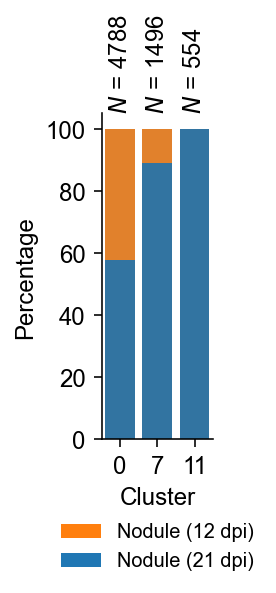

In [ ]:
with plt.rc_context({"figure.figsize": (1, 3)}):
    _ls = ["0", "7", "11"]
    singleCellTools.plotting.plotLabelPercentageInCluster(
        ad[ad.obs.eval("Sample in ['Large Nodule', 'Small Nodule'] & Cluster in @_ls")],
        "Cluster",
        "Sample_time",
        labelColor={"Nodule (12 dpi)": "#ff7f0e", "Nodule (21 dpi)": "#1f77b4"},
        dt_kwargsForLegend={
            "bbox_to_anchor": [0.5, -0.2],
            "loc": "upper center",
            "ncol": 1,
            "fontsize": 10,
        },
    )

# get marker

In [ ]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad, 'raw', 'Cell type')

In [ ]:
df_marker = ad.uns['Cell type_cellexES'].assign(
    Cluster=lambda df: df["Cell type"].str.split(":").str[0]
)

In [ ]:
df_marker["Cluster"] = df_marker["Cluster"].astype("category").cat.set_categories(
    ["0", "1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12", "13", "14"]
)

In [ ]:
# df_marker.drop(columns=["Cell type"]).query(
#     "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2"
# ).merge(df_symbol, how="left", left_on="gene", right_index=True).eval(
#     "Symbol = Symbol.fillna('') \n other_designations = other_designations.fillna('')",
#     engine="python",
# ).to_excel(f"{dir_result}/20220607_enrichGene.xlsx")

In [ ]:
ad.uns['Cell type_cellexES'].query(
    "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2"
)

,gene,Cell type,enrichScore,expressed_ratio,expressed_ratio_others
69,GLYMA_01G008000,0: Cortex,0.818345,0.111614,0.028928
83,GLYMA_01G009600,0: Cortex,0.811713,0.526208,0.197464
167,GLYMA_01G019700,0: Cortex,0.802225,0.364645,0.147984
224,GLYMA_01G027200,0: Cortex,0.783761,0.193011,0.064997
237,GLYMA_01G028600,0: Cortex,0.944330,0.110997,0.016844
...,...,...,...,...,...
589547,GLYMA_20G184900,9: Stele,0.800815,0.100629,0.008696
589627,GLYMA_20G195100,9: Stele,0.753702,0.406709,0.072599
589686,GLYMA_20G203100,9: Stele,0.868116,0.585954,0.031447
589713,GLYMA_20G206900,9: Stele,0.884120,0.606918,0.028496


In [ ]:
df_marker.drop(columns=["Cell type"]).query("expressed_ratio > 0.2 & expressed_ratio_others < 0.01")

,gene,enrichScore,expressed_ratio,expressed_ratio_others,Cluster
45735,GLYMA_04G079600,0.951995,0.213731,0.005821,10
58903,GLYMA_10G179400,0.952461,0.321244,0.009483,10
61374,GLYMA_11G200300,0.917594,0.310881,0.009715,10
83285,GLYMA_03G113200,0.961702,0.207705,0.004404,11
91803,GLYMA_07G195300,0.971626,0.232831,0.009420,11
...,...,...,...,...,...
586559,GLYMA_19G015800,0.915971,0.250524,0.007338,9
588247,GLYMA_19G258700,0.943305,0.210692,0.004736,9
589098,GLYMA_20G126500,0.930998,0.250524,0.007648,9
589543,GLYMA_20G184300,0.930953,0.292453,0.009589,9


In [ ]:
dt_marker = (
    df_marker.query(
        "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2"
    )
    .groupby("Cluster")["gene"]
    .agg(list)
    .to_dict()
)

dt_spercificGenes = (
    df_marker.query(
        "expressed_ratio > 0.2 &expressed_ratio_others < 0.01"
    )
    .groupby("Cluster")["gene"]
    .agg(list)
    .to_dict()
)

In [ ]:
ls_c12EnrichedGenes = dt_marker['12']
ls_c12SpercificGenes= dt_spercificGenes['12']

In [ ]:
_ls_cluster = list(dt_marker.keys()) | F(sorted, key=int)
_ls_snfPropotion = [len([y for y in dt_marker[x] if y in ls_knownSnfGenes]) / len(dt_marker[x]) * 100 for x in _ls_cluster]

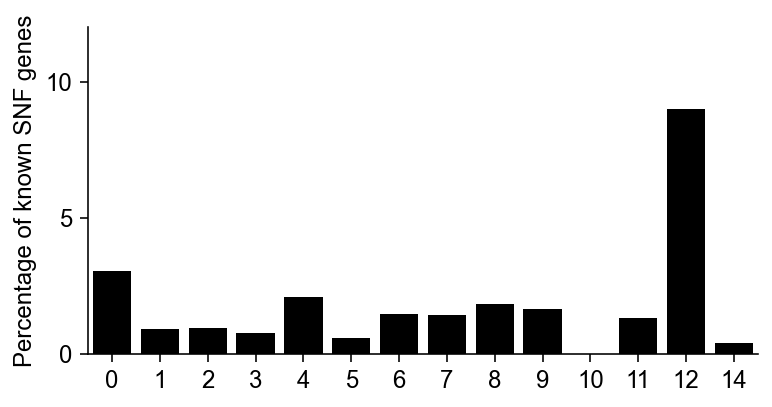

In [ ]:
fig, ax = plt.subplots(figsize=(6, 3))

# sns.barplot(y=["1", "2", "3"], x=[100, 100, 100], palette=["#D3D3D3"])
sns.barplot(
    x=_ls_cluster,
    y=_ls_snfPropotion,
    palette=["black"],
)
plt.ylabel("Percentage of known SNF genes")
plt.ylim(0, 12)
ax.yaxis.set_major_locator(ticker.MultipleLocator(5))

plt.xticks(
    rotation=-90, ha='center'
)
sns.despine()
plt.xticks(rotation=0);

In [ ]:
len(ls_c12EnrichedGenes), len(ls_c12SpercificGenes), len(
    ls_c12EnrichedGenes | F(filter, lambda x: x in ls_knownSnfGenes) | F(list)
), len(ls_c12SpercificGenes | F(filter, lambda x: x in ls_knownSnfGenes) | F(list))

(311, 33, 28, 2)

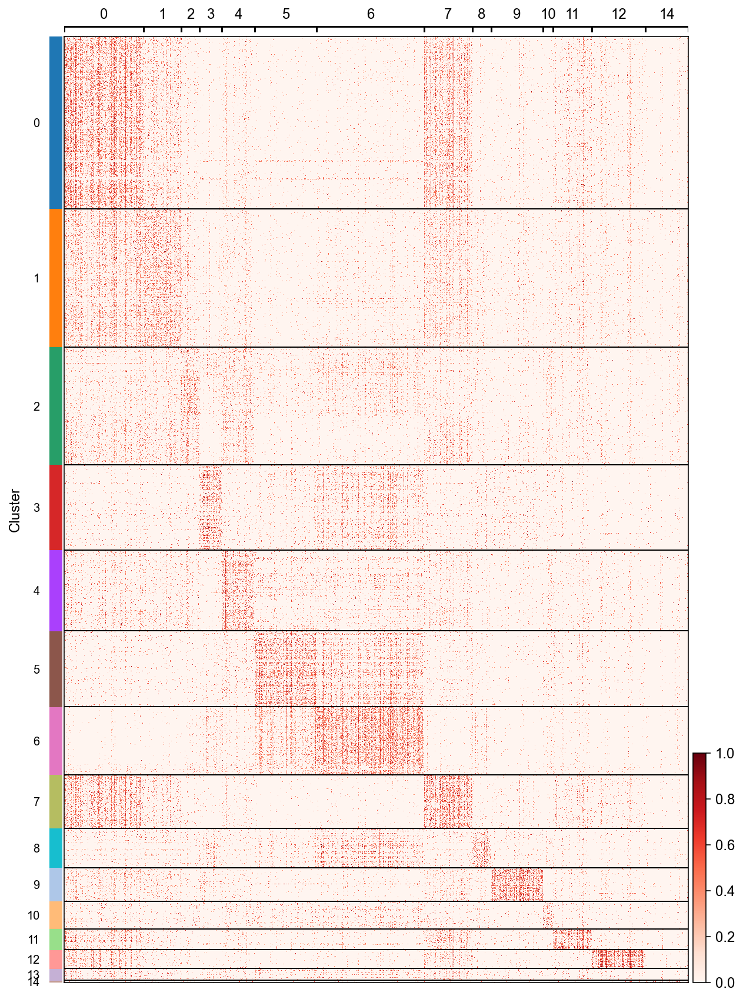

In [ ]:
sc.pl.heatmap(
    ad,
    {x: y for x, y in dt_marker.items() if y},
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    figsize=(10, 15), standard_scale='var'
)

In [ ]:
{x:len(y) for x,y in dt_marker.items() if y}

{'10': 3, '11': 6, '12': 33, '14': 50, '5': 3, '6': 2, '8': 7, '9': 28}

In [ ]:
2 / 33

0.06060606060606061

In [ ]:
{x:[z for z in y if z in ls_knownSnfGenes] for x,y in dt_marker.items() if y}

{'5': [],
 '6': [],
 '8': [],
 '9': [],
 '10': [],
 '11': [],
 '12': ['GLYMA_15G048400', 'GLYMA_07G025800'],
 '14': []}

Text(0.5, 1.0, 'Propotion of known SNF genes')

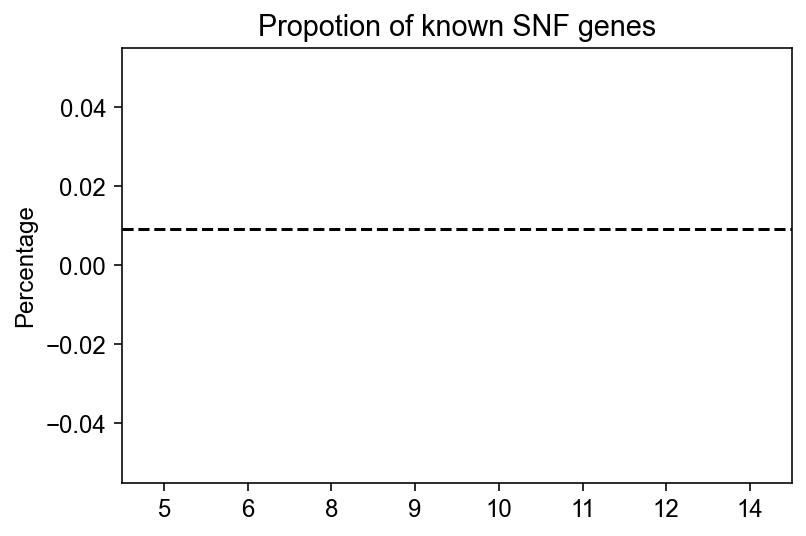

In [ ]:
_df = pd.Series({x:len([z for z in y if z in ls_knownSnfGenes]) / len(y) for x,y in dt_marker.items() if y})
sns.barplot(data = _df.reset_index(), x='index', y=0, palette=singleCellTools.basic.getadataColor(ad, 'Cluster'))
plt.ylabel('Percentage')
plt.xlabel('')
plt.axhline(len(ls_knownSnfGenes) / ad.shape[1], ls='--', color='black')
plt.title('Propotion of known SNF genes')

## sc spec gene in st data

In [ ]:
_dt_marker = dt_marker >> F(lambda j: {x: [z for z in y if z in ad_stAlign.var.index] for x, y in j.items() if y})

In [ ]:
singleCellTools.geneEnrichInfo.getAUCellScore(ad_stAlign, _dt_marker, 'raw', threads=14, label='scUpRegGenes_AUC')

Create regulons from a dataframe of enriched features.
Additional columns saved: []


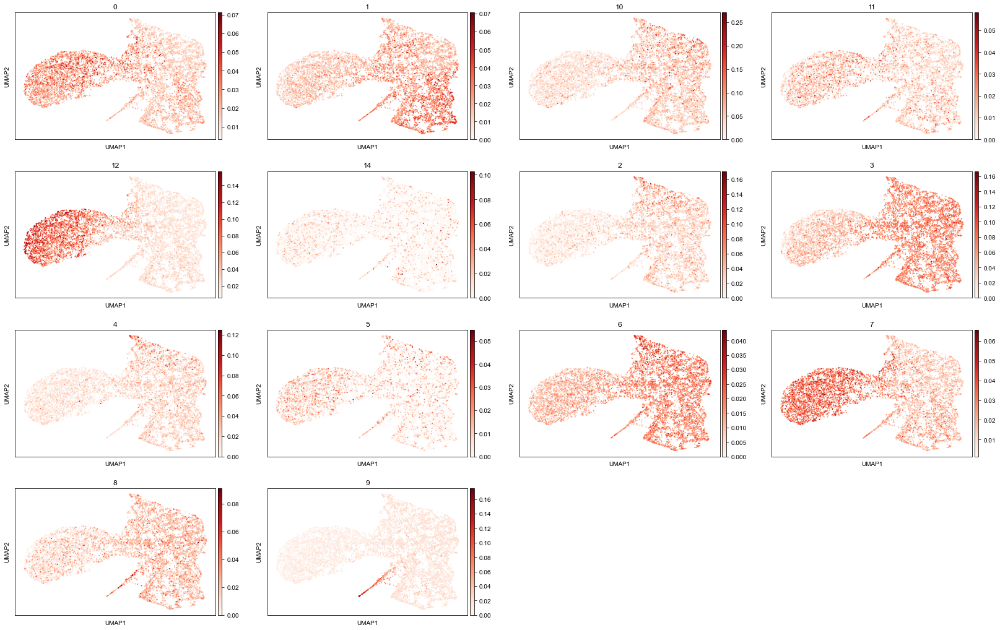

In [ ]:
_ad = singleCellTools.plotting.obsmToObs(ad_stAlign, 'scUpRegGenes_AUC')
sc.pl.umap(_ad, color=_ad.uns['plot_obsm'], cmap='Reds')

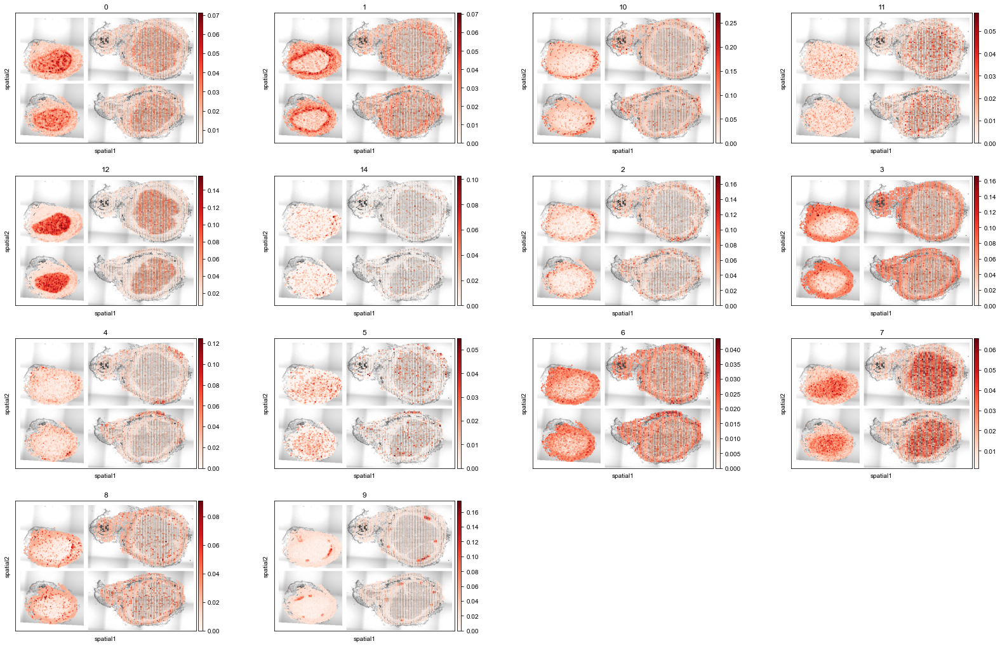

In [ ]:
sc.pl.spatial(
    _ad,
    color=_ad.uns['plot_obsm'],
    size=0.12,
    # alpha=0.75,
    img_key="cross", na_in_legend=False,
    cmap='Reds'
)
# plt.legend(ncol=1, loc='upper left', bbox_to_anchor=(0,-0.2), frameon=False)

## GO for each cluster

In [ ]:
from jpy_tools.otherTools import getGoDesc

In [ ]:
df_go = pd.read_table("/data/Zhaijx/liuzj/data/soybase_IPF/soybase_soybean_go_term.tsv")
df_goDesc = getGoDesc(df_go["goTerm"].unique().tolist())
_dt = df_goDesc["hitGO"].to_dict()
df_termGene = (
    df_go[["goTerm", "gene"]]
    .assign(goTerm=lambda df: df["goTerm"].map(_dt))
    .rename(columns={"gene": "Gene stable ID", "goTerm": "GO term accession"})
)
df_termName = df_goDesc.reset_index()[["hitGO", "hitName"]].rename(
    columns={"index": "GO term accession", "hitName": "GO term name"}
)
dt_goToCat = df_go.set_index("goTerm")["cate"].to_dict()

100%|██████████| 5017/5017 [01:16<00:00, 65.89it/s]
2022-11-03 13:50:08.631 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0007126, target : GO:0051321
2022-11-03 13:50:08.633 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0016568, target : GO:0006325
2022-11-03 13:50:08.636 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0006944, target : GO:0061025
2022-11-03 13:50:08.642 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0007067, target : GO:0000278
2022-11-03 13:50:08.643 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0006342, target : GO:0031507
2022-11-03 13:50:08.646 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0070838, target : GO:0030001
2022-11-03 13:50:08.647 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0009814, target : GO:0098542
2022-11-03 13:50:08.649 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0007050, target : GO:0051726
2022-11-03 13:50:08.651 | WARNING  |

In [ ]:
ad_stAlign.obs['n_counts'].mean(), ad_stAlign.obs['n_genes'].mean()

(695.0361, 224.3304665102945)

In [ ]:
cpro = importr('clusterProfiler')
rBase = importr("base")
R = ro.r

dfR_termGene = py2r(df_termGene)
dfR_termName = py2r(df_termName)

In [ ]:
def enrichmentAnalysisGO(ls_gene, ls_background, qvalueCutoff=0.2, dt_goToCat=None, pvalueCutoff=0.05):
    _go = cpro.enricher(
        R.c(*ls_gene),
        universe=R.c(*ls_background),
        TERM2GENE=dfR_termGene,
        TERM2NAME=dfR_termName,
        qvalueCutoff=qvalueCutoff,
        pvalueCutoff=pvalueCutoff
    )
    df_go = r2py(rBase.as_data_frame(_go))
    if df_go.empty:
        return df_go
    df_go["-log10Pvalue"] = np.log10(df_go["pvalue"]) * -1
    if dt_goToCat:
        df_go["Category"] = df_go.index.map(dt_goToCat)
        df_go = df_go.sort_values(["Category", "pvalue"])
    else:
        df_go = df_go.sort_values(["pvalue"])
    return df_go

In [ ]:
dt_goColor = {x:y for x,y in zip(['Biological Process ', 'Cellular Component ', 'Molecular Function '], sns.palettes.color_palette())}

In [ ]:
def _fcSplitGoTerm(x, cutoff=40):
    from more_itertools import chunked
    ls_x = x.split(' ')
    parsed = ''
    lineChrCounts = 0
    for x in ls_x:
        x = x.strip()
        chrCounts = len(x)
        lineChrCounts += chrCounts
        if lineChrCounts > cutoff:
            parsed = parsed + '\n' + x
            lineChrCounts = 0
        else:
            parsed = parsed + ' ' + x
    return parsed

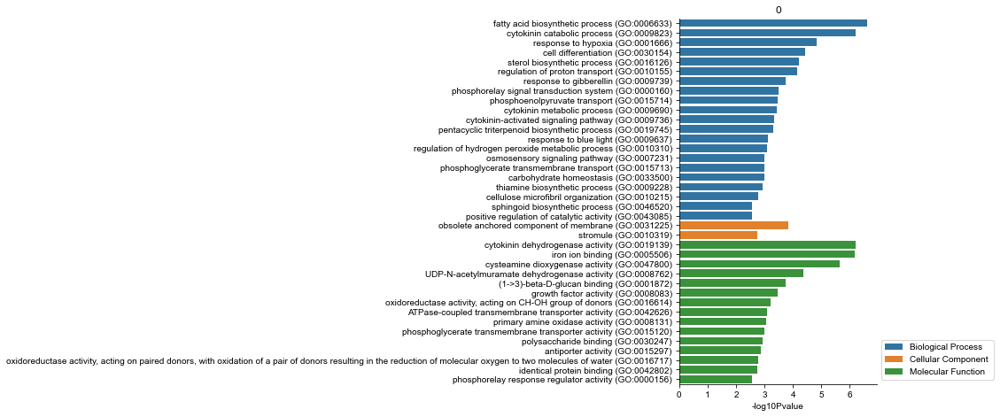

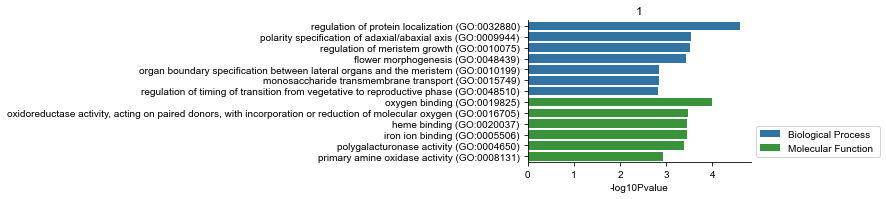

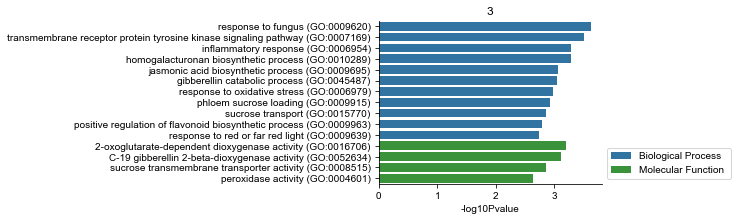

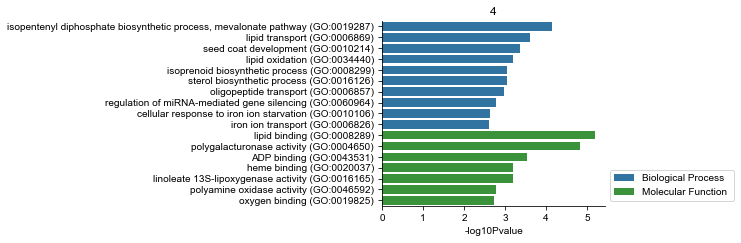

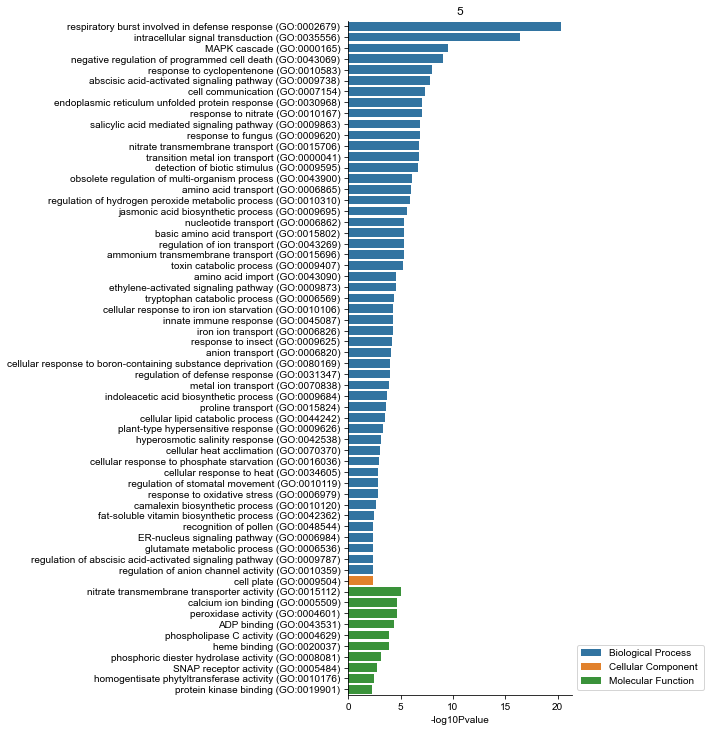

...

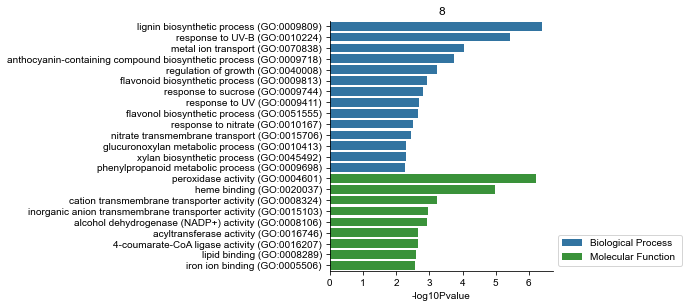

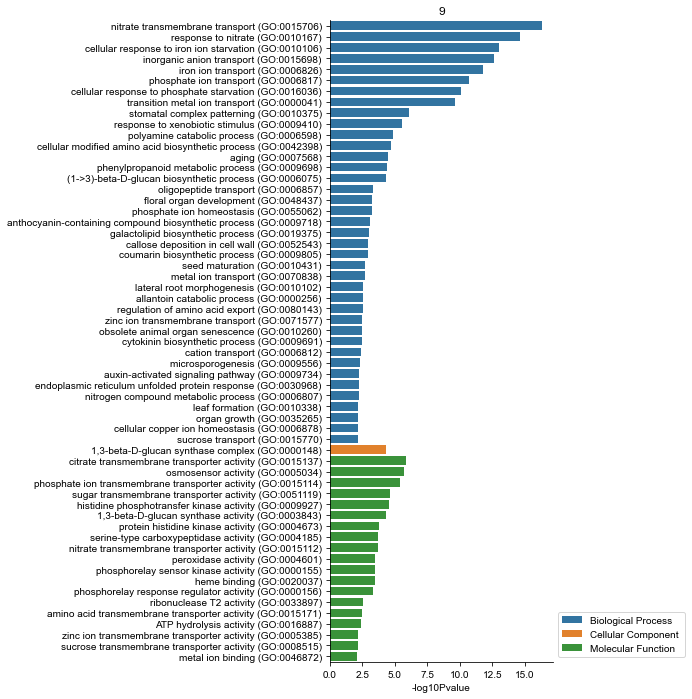

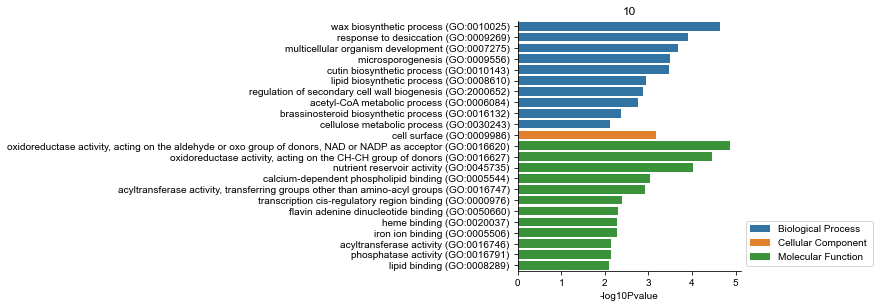

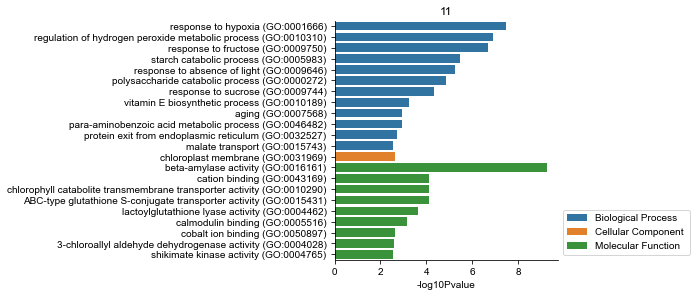

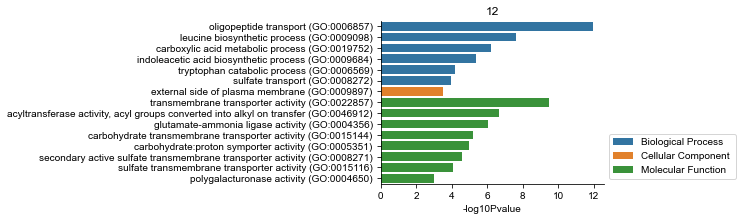

R[write to console]: --> No gene can be mapped....

R[write to console]: --> Expected input gene ID: GLYMA_17G001600,GLYMA_20G123100,GLYMA_18G025900,GLYMA_04G060500,GLYMA_19G026800,GLYMA_13G063400

R[write to console]: --> return NULL...



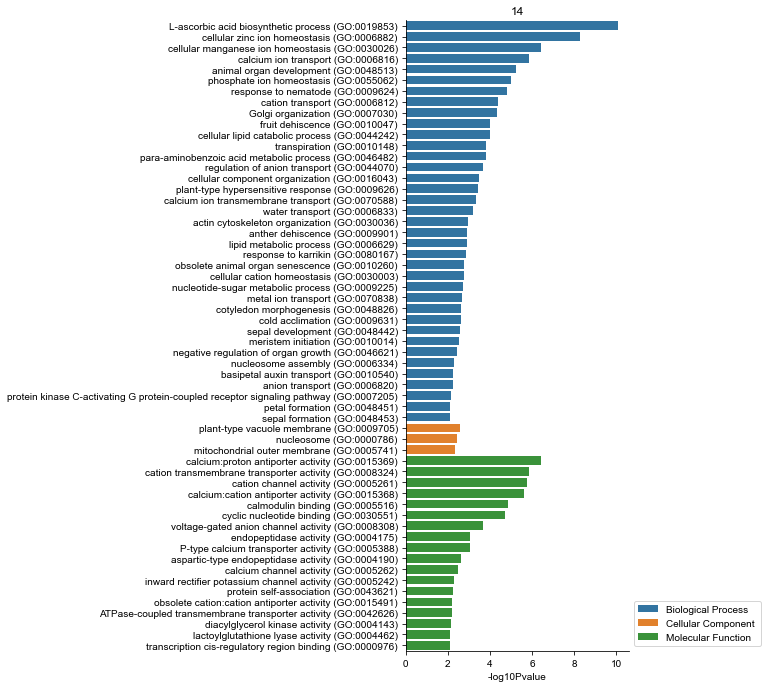

In [ ]:
lsDf_go = []
for cluster, ls_gene in dt_marker.items():
    df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat,  qvalueCutoff=0.2, pvalueCutoff=0.05)
    if df_go.empty:
        continue
    df_go.insert(0, 'Cluster', cluster)
    lsDf_go.append(df_go)

    fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
    sns.barplot(data=df_go, x="-log10Pvalue", y="Description", hue = 'Category', ax=ax, dodge=False, palette=dt_goColor)
    plt.legend(loc='lower left', bbox_to_anchor=[1,0])
    plt.ylabel('')
    sns.despine(top=True, right=True)
    plt.title(cluster)
    plt.show()

In [ ]:
_ls_go = ['GO:0009098', 'GO:0015144']
cluster = '12'
ls_gene = dt_marker[cluster]
df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat,  qvalueCutoff=0.2, pvalueCutoff=0.05)
df_go.insert(0, 'Cluster', '12')
df_go = df_go.query("ID in @_ls_go")

In [ ]:
lsDf_go = []
_ls_go = ['GO:0016161', 'GO:0010310', 'GO:0009750']
cluster = '11'
ls_gene = dt_marker[cluster]
df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat,  qvalueCutoff=0.2, pvalueCutoff=0.05)
df_go.insert(0, 'Cluster', '11')
df_go = df_go.query("ID in @_ls_go")
lsDf_go.append(df_go)

_ls_go = ['GO:0016161', 'GO:0010310', 'GO:0009750']
cluster = '11'
ls_gene = dt_marker[cluster]
df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat,  qvalueCutoff=0.2, pvalueCutoff=0.05)
df_go.insert(0, 'Cluster', '11')
df_go = df_go.query("ID in @_ls_go")
lsDf_go.append(df_go)

In [ ]:
fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
sns.barplot(data=df_go, x="-log10Pvalue", y="Description", hue = 'Category', ax=ax, dodge=False, palette=dt_goColor)
# plt.legend(loc='lower left', bbox_to_anchor=[1,0])
ax.
plt.ylabel('')
sns.despine(top=True, right=True)
plt.title('11')
plt.show() 

,Cluster,ID,Description,GeneRatio,BgRatio,pvalue,p.adjust,qvalue,geneID,Count,-log10Pvalue,Category
GO:0010310,11,GO:0010310,regulation of hydrogen peroxide metabolic proc...,14/218,388/35944,1.296308e-07,1.732731e-05,1.514633e-05,GLYMA_02G086100/GLYMA_06G061900/GLYMA_07G19530...,14,6.887292,Biological Process
GO:0009750,11,GO:0009750,response to fructose (GO:0009750),12/218,285/35944,2.033955e-07,2.039040e-05,1.782387e-05,GLYMA_01G161500/GLYMA_02G145300/GLYMA_06G05010...,12,6.691659,Biological Process
GO:0016161,11,GO:0016161,beta-amylase activity (GO:0016161),6/218,17/35944,5.437488e-10,2.180433e-07,1.905983e-07,GLYMA_01G203400/GLYMA_05G068000/GLYMA_11G03940...,6,9.264602,Molecular Function


In [ ]:
_ls = df_go.loc['GO:0010310', 'geneID'].split('/')
df_symbol.query("index in @_ls")

,Symbol,other_designations
geneID,,
GLYMA_16G141500,BZIP117,bZIP transcription factor bZIP117
GLYMA_06G061900,WRKY17,WRKY transcription factor 17
GLYMA_11G121800,LOC102661758,nonsymbiotic hemoglobin|non-symbiotic hemoglob...
GLYMA_12G150500,LOC100814871,stem-specific protein TSJT1
GLYMA_02G086100,LOC100811587,RNA-dependent RNA polymerase 1
GLYMA_09G073600,LOC100806761,sucrose synthase
GLYMA_18G273200,LOC100787893,protein DOWNY MILDEW RESISTANCE 6
GLYMA_13G181000,LOC100786699,stem-specific protein TSJT1
GLYMA_13G242100,LOC100816141,stem-specific protein TSJT1


In [ ]:
len(_ls)

14

### IC UC GO

In [ ]:
lsDf_go = []
for cluster in ['0']:
    ls_gene = dt_marker[cluster]
    df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat)
    if df_go.empty:
        continue
    df_go.insert(0, 'Cluster', cluster)
    df_go.loc['GO:0016717', 'Description'] = 'oxidoreductase activity (GO:0016717)'
    lsDf_go.append(df_go)
    
    fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
    sns.barplot(data=df_go, x="-log10Pvalue", y="Description", hue = 'Category', ax=ax, dodge=False, palette=dt_goColor)
    plt.legend(loc='lower left', bbox_to_anchor=[1,0])
    plt.xlabel("-log$_{10}$Pvalue")
    plt.ylabel('')
    sns.despine(top=True, right=True)
    plt.title(cluster)
    plt.show() 

In [ ]:
lsDf_go = []
for cluster in ["7", "11", "12"]:
    ls_gene = dt_marker[cluster]
    df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat=dt_goToCat)
    if df_go.empty:
        continue
    df_go.insert(0, "Cluster", cluster)
    lsDf_go.append(df_go)

    fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
    sns.barplot(
        data=df_go,
        x="-log10Pvalue",
        y="Description",
        hue="Category",
        ax=ax,
        dodge=False,
        palette=dt_goColor,
    )
    plt.legend(loc="lower left", bbox_to_anchor=[1, 0])
    plt.xlabel("-log$_{10}$Pvalue")

    plt.ylabel("")
    sns.despine(top=True, right=True)
    plt.title(cluster)
    plt.show()

In [ ]:
lsDf_go = []
for cluster in ['11']:
    ls_gene = dt_marker[cluster]
    df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat)
    if df_go.empty:
        continue
    df_go.insert(0, 'Cluster', cluster)
    lsDf_go.append(df_go)
    
    fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
    sns.barplot(data=df_go, x="-log10Pvalue", y="Description", hue = 'Category', ax=ax, dodge=False, palette=dt_goColor)
    plt.legend(loc='lower left', bbox_to_anchor=[1,0])
    plt.xlabel("-log$_{10}$Pvalue")
    plt.ylabel('')
    sns.despine(top=True, right=True)
    plt.title(cluster)
    plt.show() 

In [ ]:
fig, ax = plt.subplots(figsize=(12, 0.5))
sns.barplot(
    data=df_go.query("ID in ['GO:0005983', 'GO:0016161']"),
    x="-log10Pvalue",
    y="Description",
    #     hue="Category",
    ax=ax,
    dodge=False,
    color="black"
    #     palette=dt_goColor,
)
# plt.legend(loc="lower left", bbox_to_anchor=[1, 0])
plt.xlabel("-log$_{10}$Pvalue")
plt.ylabel("")
sns.despine(top=True, right=True)
plt.title(cluster)
plt.show()

# get diff gene for each cluster

In [ ]:
import diffxpy.api as de

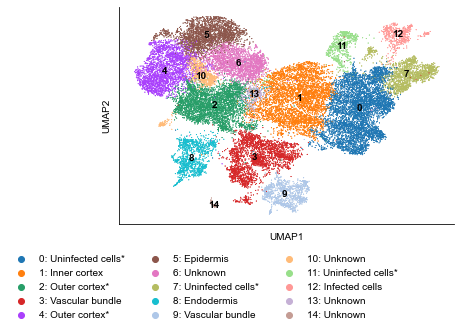

In [ ]:
# fig, ax = plt.subplots(figsize=(6, 3))
_ls = range(15) | F(map, str) | F(filter, lambda x: x not in ['6', '8', '10', '13', '14']) | F(list)
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", na_in_legend=False)

# ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
# sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="")
plt.legend(loc="upper left", bbox_to_anchor=(-0.35, -0.1), ncol=3, frameon=False)
# plt.title("Single-nucleus transcriptomes")
sns.despine()
plt.show()

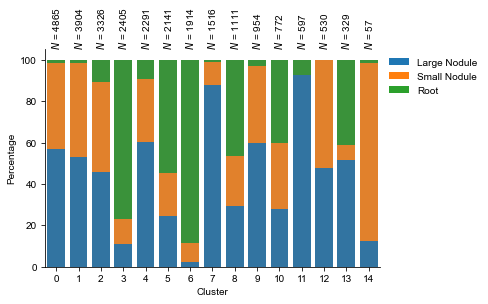

In [ ]:
singleCellTools.plotting.plotLabelPercentageInCluster(ad, "Cluster", "Sample")
plt.show()

In [ ]:
dt_diffxpyUseSampleForEachCluster = {}
ls_allUsedSample = ad.obs[["Cluster", "Sample"]].value_counts().loc[lambda sr:sr > 100].sort_index().index
for cluster, sample in ls_allUsedSample:
    if cluster not in dt_diffxpyUseSampleForEachCluster:
        dt_diffxpyUseSampleForEachCluster[cluster] = []
    dt_diffxpyUseSampleForEachCluster[cluster].append(sample)

In [ ]:
ls_diffxpyResults = []
for cluster, ls_diffxpyUsedSamples in dt_diffxpyUseSampleForEachCluster.items():
    print(cluster, ls_diffxpyUsedSamples)
    if len(ls_diffxpyUsedSamples) <= 1:
        print(f"Skip {cluster}")
        continue
    _ad = ad[ad.obs.eval("Cluster == @cluster & Sample in @ls_diffxpyUsedSamples"), :].copy()
    singleCellTools.geneEnrichInfo.getGeneMeanAndExpressedRatioGroups(_ad, layer='raw', groupby=['Sample'])
    de_res = de.test.versus_rest(_ad.layers['raw'], grouping='Sample', gene_names=_ad.var.index, sample_description=_ad.obs, quick_scale=True, noise_model='nb')
    for sample in ls_diffxpyUsedSamples:
        df_oneDiffxpyResult = de_res.summary_group(sample)
        df_oneDiffxpyResult = df_oneDiffxpyResult.merge(
            _ad.var[[f"Sample_{sample}_expressedRatio", f"Sample_{sample}_expressedCount"]].rename(columns=lambda x: x.replace(f"Sample_{sample}_", "")), 
            left_on='gene', right_index=True).assign(sample=sample, cluster=cluster
            )
        ls_diffxpyResults.append(df_oneDiffxpyResult)

0 ['Large Nodule', 'Small Nodule']
training location model: False
training scale model: False
iter   0: ll=87618564.355380
iter   1: ll=87618564.355380, converged: 100.00% (loc: 100.00%, scale update: True), in 0.00sec
training location model: False
training scale model: False
iter   0: ll=87557317.361295
iter   1: ll=87557317.361295, converged: 100.00% (loc: 100.00%, scale update: True), in 0.00sec
1 ['Large Nodule', 'Small Nodule']
training location model: False
training scale model: False
iter   0: ll=75932850.679249
iter   1: ll=75932850.679249, converged: 100.00% (loc: 100.00%, scale update: True), in 0.00sec
training location model: False
training scale model: False
iter   0: ll=75833950.477206
iter   1: ll=75833950.477206, converged: 100.00% (loc: 100.00%, scale update: True), in 0.00sec
2 ['Large Nodule', 'Small Nodule', 'Root']
training location model: False
training scale model: False
iter   0: ll=67738397.219641
iter   1: ll=67738397.219641, converged: 100.00% (loc: 100.00%,

In [ ]:
df_diffxpyResults = pd.concat(ls_diffxpyResults)
df_diffxpyResults = df_diffxpyResults.reset_index(drop=True)

In [ ]:
df_diffxpyResults = df_diffxpyResults.query("qval < 0.01 & log2fc < -4 & expressedCount > 10")

In [ ]:
dt_renameSample = {
    "Root": "Root",
    "Large Nodule": "Nodule (21 dpi)",
    "Small Nodule": "Nodule (12 dpi)",
}


df_diffxpyResults = df_diffxpyResults.assign(
    sample=lambda df: df["sample"].astype("category").cat.reorder_categories(['Small Nodule', 'Large Nodule', 'Root']).map(dt_renameSample),
    cluster=lambda df: df["cluster"].astype("category").cat.reorder_categories(['0', '1', '2', '3', '4', '5', '6', '7','8', '9', '10', '12', '13']),
)

In [ ]:
ls_diffxpyClusterUniqueGene = df_diffxpyResults['gene'].value_counts().loc[lambda x:x==1].index.to_list()

In [ ]:
df_diffxpyResults = df_diffxpyResults.assign(clusterUnique=lambda df: np.where(df['gene'].isin(ls_diffxpyClusterUniqueGene), 'Yes', 'No'))
df_diffxpyResults['clusterUnique'] = df_diffxpyResults['clusterUnique'].astype('category').cat.set_categories(['Yes', 'No'])

In [ ]:
df_diffxpyResults.value_counts(['clusterUnique']) / len(df_diffxpyResults)

clusterUnique
No               0.553776
Yes              0.446224
dtype: float64

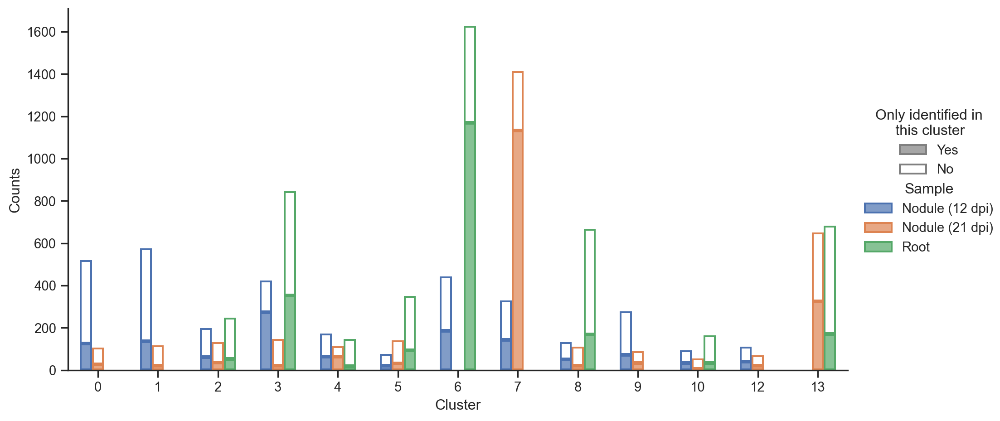

In [ ]:
(
    so.Plot(
        data=df_diffxpyResults.value_counts(['sample', 'cluster', 'clusterUnique']).rename("Counts").sort_index().reset_index().rename(columns=str.capitalize), 
        x='Cluster', y='Counts', fill='Clusterunique', color='Sample'
    )
    .add(so.Bar(width=0.6, edgewidth=1.5), so.Dodge(by=['color']), so.Stack())
    .scale(color="deep")
    .theme(dt_snsStyle)
    .label(fill='Only identified in\n     this cluster')
    .layout(size=(10,5))
)

In [ ]:
df_diffxpyResults['log2fc'] = df_diffxpyResults['log2fc'] * -1

In [ ]:
# df_diffxpyResults.to_excel(f"{dir_result}/cluster_within_deg.xlsx", index=False)

In [ ]:
df_diffxpyResults = df_diffxpyResults.assign(cluster_sample=lambda df:df['cluster'].astype(str) + ': ' + df['sample'].astype(str))
df_upset = df_diffxpyResults.pivot_table(values='expressedCount', index='gene', columns='cluster_sample').notna().value_counts()

In [ ]:
import upsetplot

{'matrix': <AxesSubplot:>,
 'shading': <AxesSubplot:>,
 'totals': <AxesSubplot:>,
 'intersections': <AxesSubplot:ylabel='Intersection size'>}

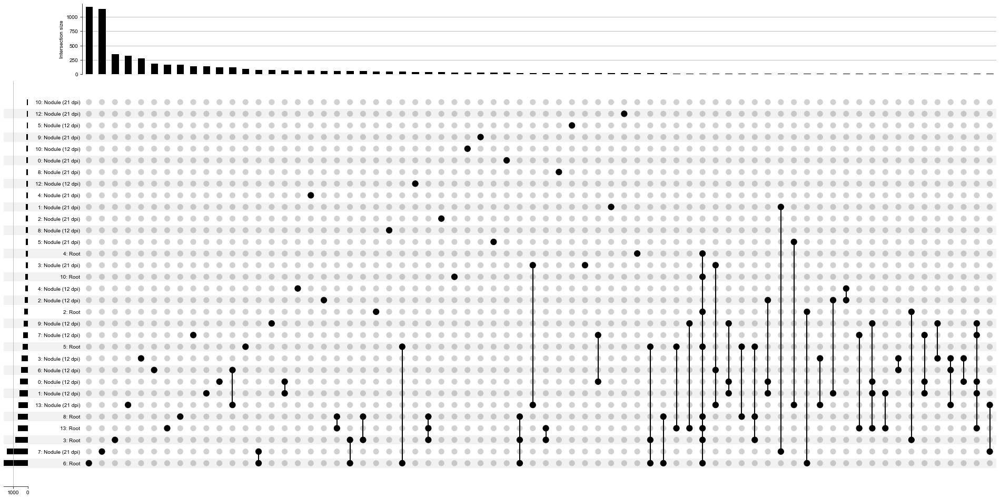

In [ ]:
upsetplot.plot(df_upset, min_subset_size=10, sort_by='cardinality')

# for web

In [ ]:
import lmdb
import tqdm
import pickle

In [ ]:
env = lmdb.open("/data/Zhaijx/liuzj/projects/singleCell/soybean/03_web/all_spatial", map_size=1099511627776)
txn = env.begin(write=True) 

In [ ]:
for gene in tqdm.tqdm(ad_stAlign.var.index):
    value = pickle.dumps(ad_stAlign[:, gene].layers['normalize_log'].A.reshape(-1))
    txn.put(key=gene.encode(), value=value)

100%|██████████| 27744/27744 [05:22<00:00, 86.13it/s]


In [ ]:
value = pickle.dumps(ad_stAlign.obsm['spatial'][:, 0] * ad_stAlign.uns['spatial']['Soybean']['scalefactors']['tissue_cross_scalef'])
txn.put(key='x'.encode(), value=value)

value = pickle.dumps(ad_stAlign.obsm['spatial'][:, 1] * ad_stAlign.uns['spatial']['Soybean']['scalefactors']['tissue_cross_scalef'])
txn.put(key='y'.encode(), value=value)

True

In [ ]:
value = pickle.dumps(ad_stAlign.uns['spatial']['Soybean']['images']['cross'])
txn.put(key='image'.encode(), value=value)

True

In [ ]:
txn.commit()
env.close()

In [ ]:
penguins = sns.load_dataset('penguins')

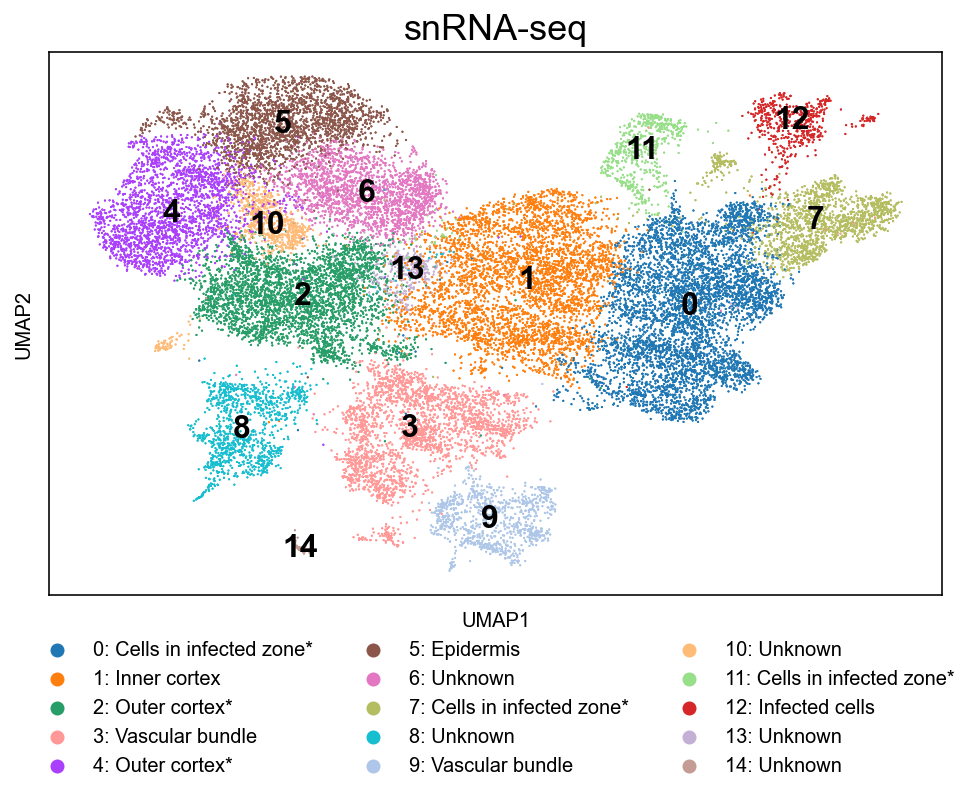

In [ ]:
fig, ax = plt.subplots(figsize=(8,5))
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False, ax=ax)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", na_in_legend=False)
plt.title('snRNA-seq', fontsize=18)
plt.legend(loc="upper center", bbox_to_anchor=(0.5, -0.05), ncol=3, frameon=False)
for text in ax.texts:
    text.set_fontsize(16)

plt.savefig("/public/home/liuzj/share/scSoybean/allUmap_bc/leiden.png", dpi=300, bbox_inches='tight')
plt.show()

## save barplot

In [ ]:
from joblib import Parallel, delayed
from more_itertools import chunked

In [ ]:
ad_merged = singleCellTools.geneEnrichInfo._mergeData(ad, 'Cluster', layer='raw')

In [ ]:
singleCellTools.basic.initLayer(ad_merged, total=1e6)

In [ ]:
_ls_colors = ['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#ff9896',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#d62728',
 '#c5b0d5',
 '#c49c94']

In [ ]:
def batchBarplot(ad_merged, ls_gene):
    for gene in ls_gene:
        sns.barplot(
            x=ad_merged.obs.index, y=ad_merged[:, gene].X.reshape(-1), palette=_ls_colors
        )
        plt.xlabel('Cluster')
        plt.ylabel('Expression\n(Log CPM)')
        plt.title(gene)
        plt.savefig(f"/public/home/liuzj/share/scSoybean/allBar/{gene}.bar.png", dpi=100)
        plt.close()

In [ ]:
ls_chunkedGene = chunked(ad.var.index.to_list(), 1000)
Parallel(12)(delayed(batchBarplot)(ad_merged, ls_gene) for ls_gene in ls_chunkedGene)

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

# use lotus data to identify UC

In [ ]:
path_ljUcIcDEG = '/data/Zhaijx/liuzj/projects/singleCell/soybean/01_data/lj_pbj/lj_uc_ic.tsv'
path_ljGmOrth = '/data/Zhaijx/liuzj/data/ortholog/plant/parsed/1v1_soybean_maize_lotus/soybase_2__v__lotus.1v1.tsv'

In [ ]:
path_allGmOrth = '/data/Zhaijx/liuzj/data/ortholog/plant/results_soybean_maize_lotus/Results_Mar02/Orthologues/Orthologues_soybase_2/soybase_2__v__lotus.tsv'

In [ ]:
df_allGmOrth = pd.read_table(path_allGmOrth)
df_allGmOrth["lotus"] = df_allGmOrth["lotus"].str.split(',')
df_allGmOrth = df_allGmOrth.explode("lotus")
df_allGmOrth['lotus'] = df_allGmOrth['lotus'].map(lambda x: x.split('|')[1].split('.')[0])
def _fc(df):
    return ','.join(df['soybase_2'].to_list()).split(',') >> F(map, str.strip) >> F(map, lambda x: x.split('glyma.Wm82.gnm2.ann1.')[1].replace('Glyma.', 'GLYMA_').split('.')[0]) >> F(set) >> F(sorted) >> F(list)

In [ ]:
dt_allLj2Gm = df_allGmOrth.groupby("lotus").apply(_fc).to_dict()

In [ ]:
df_ljDeg = pd.read_table(path_ljUcIcDEG)
df_ljGmOrth = pd.read_table(path_ljGmOrth)
dt_ljGmOrth = df_ljGmOrth.set_index('lotus')['soybase_2'].to_dict()

In [ ]:
ad_ifz = ad[ad.obs.eval("Cluster in ['0', '7', '11', '12']")].copy()

## 1v1 only

In [ ]:
df_ljDeg = (
    df_ljDeg.assign(
        gene=lambda df: df["Transcript ID \n(Lj 3.0)"].str.split(".").str[0]
    )
    .assign(gmGene=lambda df: df["gene"].map(dt_ljGmOrth))
    .dropna(subset=["gmGene"])
)
df_ljDeg = df_ljDeg.rename(columns = lambda x:x.replace('\n', '_'))
df_ljDeg['-log10FDR'] = - np.log10(df_ljDeg['FDR'])
df_ljDeg = df_ljDeg.query("`-log10FDR` > 4 & (`Log2FC_(IC vs UC)` < -10 | `Log2FC_(IC vs UC)` > 10)")

In [ ]:
df_ljDeg = df_ljDeg.pipe(
    lambda df: df.assign(category=np.where(df["Log2FC_(IC vs UC)"] > 0, "IC", "UC"))
)

In [ ]:
df_ljDeg_1 = df_ljDeg

In [ ]:
dt_ljDeg = df_ljDeg.query('gmGene in @ad.var.index').groupby('category')['gmGene'].agg(list).to_dict()

In [ ]:
dt_ljDeg = {x: dt_ljDeg[x] for x in ["UC", "IC"]}

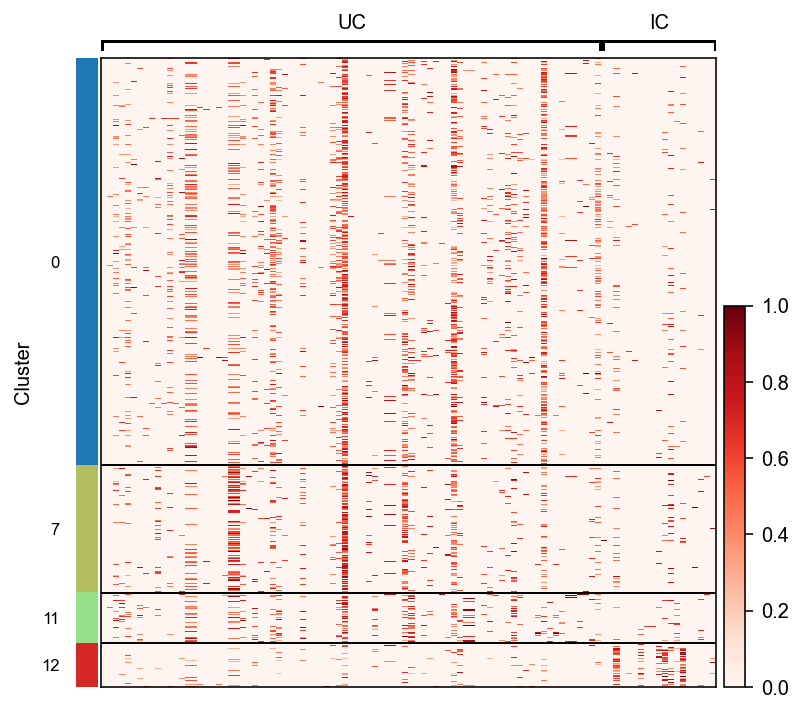

In [ ]:
sc.pl.heatmap(
    ad_ifz,
    dt_ljDeg,
    "Cluster",
    cmap="Reds",
    layer="normalize_log",
    standard_scale="var",
    figsize=(6, 6),
)

R[write to console]: Quantiles for the number of genes detected by cell: 
(Non-detected genes are shuffled at the end of the ranking. Keep it in mind when choosing the threshold for calculating the AUC).



    min      1%      5%     10%     50%    100% 
 460.00  657.07  742.00  799.00 1246.00 3613.00 


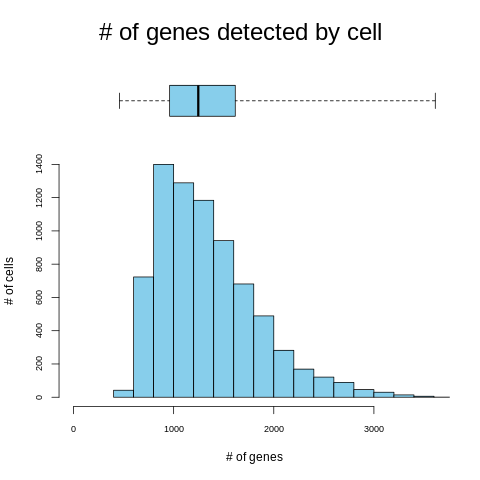

In [ ]:
singleCellTools.geneEnrichInfo.getAUCellScore_r(
    ad_ifz,
    dt_ljDeg,
    layer="raw",
)

In [ ]:
from matplotlib import ticker

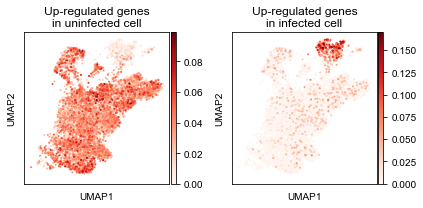

In [ ]:
ls_title = [
    "Up-regulated genes\nin uninfected cell",
    "Up-regulated genes\nin infected cell",
]
with plt.rc_context({"figure.figsize": (6, 3)}):
    _ad = singleCellTools.plotting.obsmToObs(ad_ifz, "AUCell")
    fig, axs = plt.subplots(1, 2)
    axs = axs.reshape(-1)
    for label, title, ax in zip(_ad.uns["plot_obsm"], ls_title, axs):
        if label == "Cortex":
            sc.pl.umap(
                _ad, color=label, title=title, cmap="Reds", show=False, ax=ax, vmin=0.15
            )
        else:
            sc.pl.umap(_ad, color=label, title=title, cmap="Reds", show=False, ax=ax)
        plt.sca(ax)
        plt.xlim(3, 13)
    plt.tight_layout()

#### lj DEG in sc datasets

## all only

In [ ]:
df_ljDeg = pd.read_table(path_ljUcIcDEG)
df_ljGmOrth = pd.read_table(path_ljGmOrth)
dt_ljGmOrth = df_ljGmOrth.set_index('lotus')['soybase_2'].to_dict()

In [ ]:
df_ljDegAll = (
    df_ljDeg.assign(
        gene=lambda df: df["Transcript ID \n(Lj 3.0)"].str.split(".").str[0]
    )
    .assign(gmGene=lambda df: df["gene"].map(dt_allLj2Gm))
    .dropna(subset=["gmGene"])
)
df_ljDegAll = df_ljDegAll.rename(columns = lambda x:x.replace('\n', '_'))
df_ljDegAll['-log10FDR'] = - np.log10(df_ljDegAll['FDR'])
df_ljDegAll = df_ljDegAll.query("`-log10FDR` > 4 & (`Log2FC_(IC vs UC)` < -10 | `Log2FC_(IC vs UC)` > 10)")

In [ ]:
df_ljDegAll = df_ljDegAll.pipe(
    lambda df: df.assign(category=np.where(df["Log2FC_(IC vs UC)"] > 0, "IC", "UC"))
)

In [ ]:
_ls = df_ljDeg_1['gene']
df_ljDegAll = df_ljDegAll.query("`gene` not in @_ls", engine='python').explode("gmGene")

In [ ]:
df_ljDegAll = pd.concat([df_ljDeg_1, df_ljDegAll])

In [ ]:
df_ljDegAll = df_ljDegAll.sort_values(['category', 'Transcript ID _(Lj 3.0)'])

In [ ]:
df_ljDegAll.to_excel(f"{dir_result}/ljDegAll.xlsx")

In [ ]:
dt_ljDegAll = df_ljDegAll.groupby('category')['gmGene'].agg(lambda x: list(set(x))).to_dict()

In [ ]:
dt_ljDegAll = {x: [z for z in y if z in ad.var.index] >> F(set) >> F(list) for x, y in dt_ljDegAll.items()}

In [ ]:
dt_ljDegAll = {x: dt_ljDegAll[x] for x in ["UC", "IC"]}

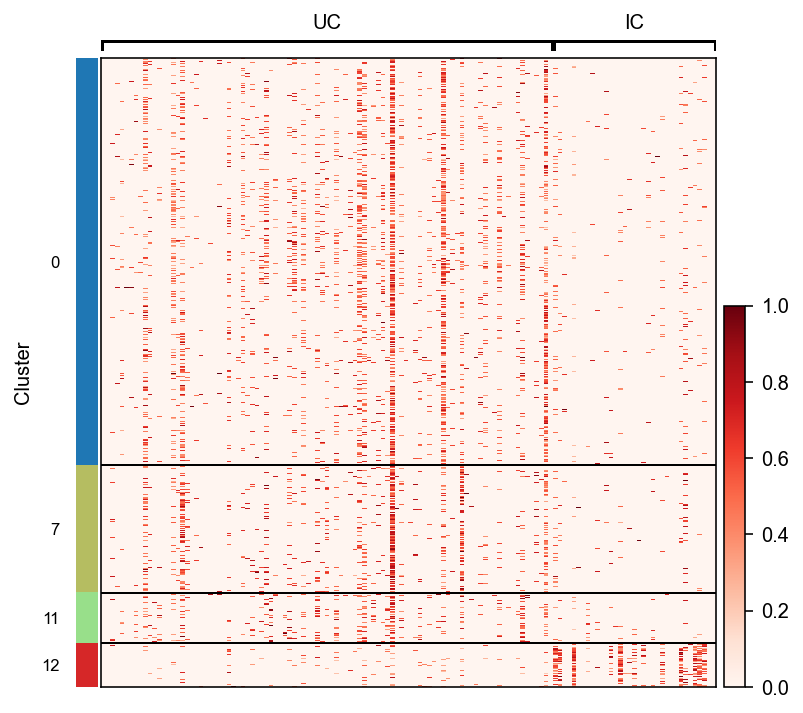

In [ ]:
sc.pl.heatmap(
    ad_ifz,
    dt_ljDegAll,
    "Cluster",
    cmap="Reds",
    layer="normalize_log",
    standard_scale="var",
    figsize=(6, 6),
)

R[write to console]: Quantiles for the number of genes detected by cell: 
(Non-detected genes are shuffled at the end of the ranking. Keep it in mind when choosing the threshold for calculating the AUC).



    min      1%      5%     10%     50%    100% 
 460.00  657.07  742.00  799.00 1246.00 3613.00 


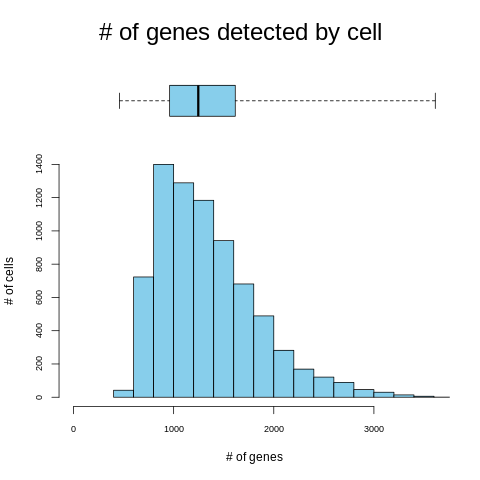

In [ ]:
singleCellTools.geneEnrichInfo.getAUCellScore_r(
    ad_ifz,
    dt_ljDegAll,
    layer="raw",
    label='all_ljDeg'
)

In [ ]:
from matplotlib import ticker

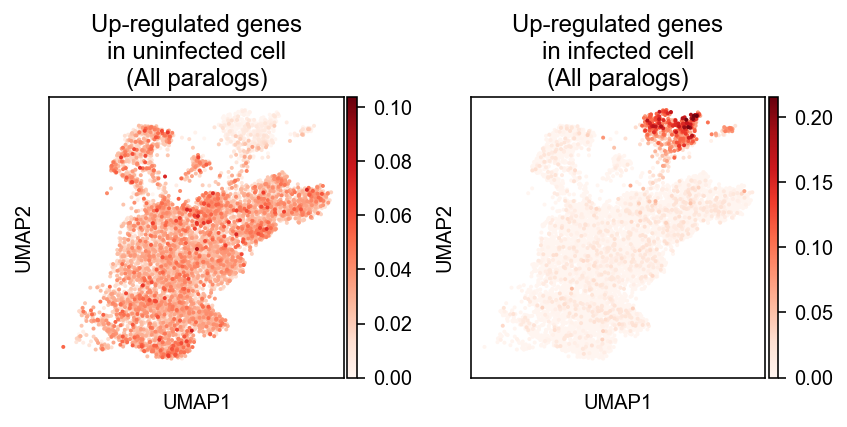

In [ ]:
ls_title = [
    "Up-regulated genes\nin uninfected cell\n(All paralogs)",
    "Up-regulated genes\nin infected cell\n(All paralogs)",
]
with plt.rc_context({"figure.figsize": (6, 3)}):
    _ad = singleCellTools.plotting.obsmToObs(ad_ifz, "all_ljDeg")
    fig, axs = plt.subplots(1, 2)
    axs = axs.reshape(-1)
    for label, title, ax in zip(_ad.uns["plot_obsm"], ls_title, axs):
        if label == "Cortex":
            sc.pl.umap(
                _ad, color=label, title=title, cmap="Reds", show=False, ax=ax, vmin=0.15
            )
        else:
            sc.pl.umap(_ad, color=label, title=title, cmap="Reds", show=False, ax=ax)
        plt.sca(ax)
        plt.xlim(3, 13)
    plt.tight_layout()

#### sc marker in lj

In [ ]:
df_ljGem = pd.read_excel('/data/Zhaijx/liuzj/projects/singleCell/soybean/01_data/lj_pbj/pbi13778-sup-0002-tables1 (1).xlsx')
df_ljGem = df_ljGem.assign(gene=lambda df: df["Transcript"].str.split(".").str[0]).drop(
    columns="Transcript"
).groupby("gene").agg("sum")

In [ ]:
df_ljGem = df_ljGem.loc[df_ljGem.index.isin(dt_ljGmOrth)]
df_ljGem.index = df_ljGem.index.map(dt_ljGmOrth)

In [ ]:
ad_lj = sc.AnnData(df_ljGem.T)
ad_lj.var_names_make_unique()

In [ ]:
ad_lj.layers['rpkm'] = ad_lj.X.copy()
ad_lj.obs["category"] = ["IC", "IC", "UC", "UC", "UC", "UC"]

In [ ]:
df_scMarker = ad.uns['Cell type_cellexES'].assign(
    Cluster=lambda df: df["Cell type"].str.split(":").str[0]
)

In [ ]:
df_scMarker["Cluster"] = df_scMarker["Cluster"].astype("category").cat.set_categories(
    ["0", "1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12", "13", "14"]
)

In [ ]:
df_scMarker.query(
    "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2"
).merge(df_symbol, left_on="gene", right_index=True, how="left").sort_values(
    ["Cell type", "enrichScore"], ascending=[True, False]
).to_excel(f"{dir_result}/cluster_marker.xlsx")

In [ ]:
dt_scMarker = (
    df_scMarker.query(
        "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2 & gene in @ad_lj.var.index"
    )
    .groupby("Cluster")["gene"]
    .agg(list)
    .to_dict()
)

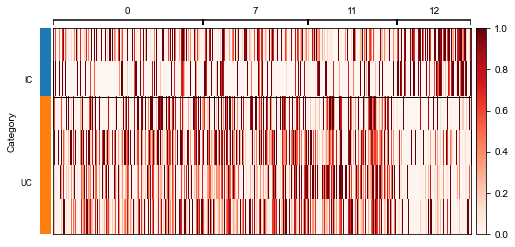

In [ ]:
axs = sc.pl.heatmap(
    ad_lj,
    {x: dt_scMarker[x] for x in ["0", "7", "11", "12"]},
    "category",
    cmap="Reds",
    standard_scale="var",
    figsize=(8, 4),
    show=False,
)
plt.sca(axs["groupby_ax"])
plt.ylabel("Category")
plt.show()

#### verification

In [ ]:
ls_gene = [
    "GLYMA_10G199100",
    "GLYMA_10G199000",
    "GLYMA_20G191200",
    "GLYMA_10G198800",
    "GLYMA_08G012800",
    "GLYMA_05G205900",
    "GLYMA_06G301500",
    "GLYMA_15G098100",
    "GLYMA_08G025500",
    "GLYMA_17G150100",
    "GLYMA_05G068000",
    "GLYMA_01G203400",
    "GLYMA_11G039400",
    "GLYMA_13G215000",
]
ls_name = [
    "LBA",
    "LBC1",
    "LBC2",
    "LBC3",
    "SYMREM1.1",
    "SYMREM1.2",
    "BMY1-1",
    "BMY1-2",
    "BMY1-3",
    "BMY2",
    "BMY3-1",
    "BMY3-2",
    "BMY3-3",
    "BMY9",
]

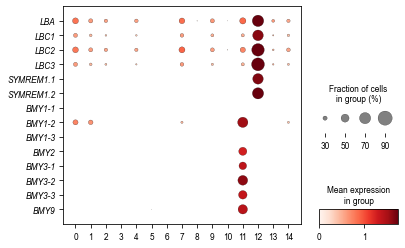

In [ ]:
axs = sc.pl.dotplot(
    ad,
    ls_gene,
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    swap_axes=True,
    show=False,
    figsize=(6, 4),
    dot_min=0.15,
    dot_max=0.9, vmax=1.75
)
plt.sca(axs["mainplot_ax"])
plt.xticks(rotation=0)
plt.yticks([x + 0.5 for x in range(len(ls_name))], ls_name, style="italic")
plt.show()

In [ ]:
{"SYMREM1.1": "GLYMA_08G012800", "N56": "GLYMA_13G024700", "ENOD55": "GLYMA_02G204500"}

{'SYMREM1.1': 'GLYMA_08G012800',
 'N56': 'GLYMA_13G024700',
 'ENOD55': 'GLYMA_02G204500'}

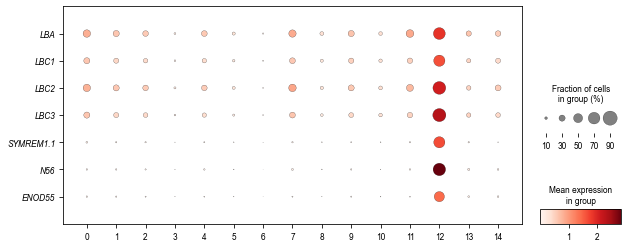

In [ ]:
ls_gene = [
    "GLYMA_10G199100",
    "GLYMA_10G199000",
    "GLYMA_20G191200",
    "GLYMA_10G198800",
    "GLYMA_08G012800",
    "GLYMA_13G024700",
    "GLYMA_02G204500",
]
ls_name = ["LBA", "LBC1", "LBC2", "LBC3", "SYMREM1.1", "N56", "ENOD55"]
axs = sc.pl.dotplot(
    ad,
    ls_gene,
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    swap_axes=True,
    show=False,
    figsize=(10, 4),
)
plt.sca(axs["mainplot_ax"])
plt.xticks(rotation=0)
plt.yticks([x + 0.5 for x in range(len(ls_name))], ls_name, style="italic")
plt.show()

In [ ]:
ls_gene = [
    "GLYMA_06G301500",
    "GLYMA_15G098100",
    "GLYMA_08G025500",
    "GLYMA_17G150100",
    "GLYMA_05G068000",
    "GLYMA_01G203400",
    "GLYMA_11G039400",
    "GLYMA_13G215000",
    "GLYMA_01G058500",
    "GLYMA_02G116300",
    "GLYMA_02G116400",
    "GLYMA_20G072400",
    "GLYMA_14G111800",
    "GLYMA_17G216000",
]
ls_name = [
    "BMY1-1",
    "BMY1-2",
    "BMY1-3",
    "BMY2",
    "BMY3-1",
    "BMY3-2",
    "BMY3-3",
    "BMY9",
    "UPS2-1",
    "UPS2-2",
    "UPS2-3",
    "UR2",
    "ASP5-1",
    "ASP5-2",
]

In [ ]:
ls_gene = [
    "GLYMA_15G098100",
    "GLYMA_17G150100",
    "GLYMA_05G068000",
    "GLYMA_01G203400",
    "GLYMA_11G039400",
    "GLYMA_13G215000",
    "GLYMA_01G058500",
    "GLYMA_02G116300",
    "GLYMA_20G072400",
    "GLYMA_14G111800",
    "GLYMA_17G216000",
]
ls_name = [
    "BMY1-2",
    "BMY2",
    "BMY3-1",
    "BMY3-2",
    "BMY3-3",
    "BMY9",
    "UPS2-1",
    "UPS2-2",
    "UR2",
    "ASP5",
    "ASP5",
]
ls_name = [f"{x}\n({y})" for x,y in zip(ls_gene, ls_name)]

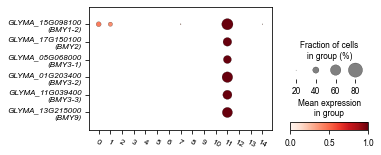

In [ ]:
axs = sc.pl.dotplot(
    ad,
    ls_gene[:6],
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    swap_axes=True,
    show=False,
    figsize=(5, 5 / 11 * 5),
    dot_min=0.2,
    dot_max=0.8,
    standard_scale="var",
)
plt.sca(axs["mainplot_ax"])
plt.yticks([x + 0.5 for x in range(len(ls_name[:6]))], ls_name[:6], style="italic", size=8)
plt.xticks(rotation=-30, ha="center", size=8)
plt.show()

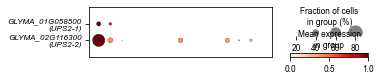

In [ ]:
axs = sc.pl.dotplot(
    ad,
    ls_gene[6:8],
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    swap_axes=True,
    show=False,
    figsize=(5, 2 / 11 * 5),
    dot_min=0.2,
    dot_max=0.8,
    standard_scale="var",
)
plt.sca(axs["mainplot_ax"])
plt.yticks([x + 0.5 for x in range(len(ls_name[6:8]))], ls_name[6:8], style="italic", size=8)
plt.xticks([])
plt.tick_params(bottom=False)
plt.show()

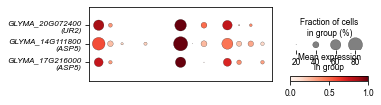

In [ ]:
axs = sc.pl.dotplot(
    ad,
    ls_gene[8:],
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    swap_axes=True,
    show=False,
    figsize=(5, 3 / 11 * 5),
    dot_min=0.2,
    dot_max=0.8,
    standard_scale="var",
)
plt.sca(axs["mainplot_ax"])
plt.yticks([x + 0.5 for x in range(len(ls_name[8:]))], ls_name[8:], style="italic", size=8)
plt.xticks([])
plt.tick_params(bottom=False)
plt.show()

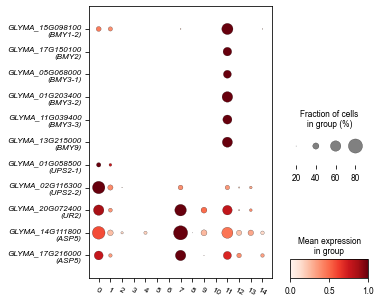

In [ ]:
axs = sc.pl.dotplot(
    ad,
    ls_gene,
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    swap_axes=True,
    show=False,
    figsize=(5, 5),
    dot_min=0.2,
    dot_max=0.8,
    standard_scale="var",
)
plt.sca(axs["mainplot_ax"])
plt.xticks(rotation=-30, ha="center", size=8)
plt.yticks([x + 0.5 for x in range(len(ls_name))], ls_name, style="italic", size=8)
plt.show()

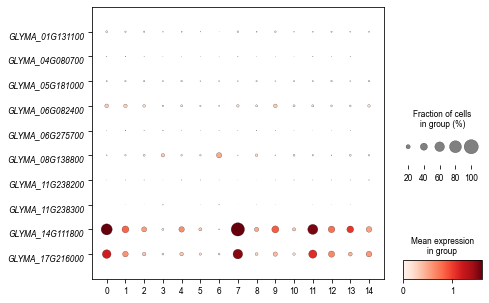

In [ ]:
# aspartate aminotransferase
_ls = (
    """Glyma.01g131100
Glyma.04g080700
Glyma.05g181000
Glyma.06g082400
Glyma.06g275700
Glyma.08g138800
Glyma.11g238200
Glyma.11g238300
Glyma.14g111800
Glyma.17g216000""".split()
    | F(map, lambda x: x.replace("Glyma.", "GLYMA_").upper())
    | F(list)
)
_ls_name = _ls[:]
# _ls_name[-2] = "GLYMA_14G111800\n(ASP5-1)"
# _ls_name[-1] = "GLYMA_17G216000\n(ASP5-2)"

axs = sc.pl.dotplot(
    ad,
    _ls,
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    swap_axes=True,
    show=False,
    figsize=(7, 5),
    vmax=1.6,
)
plt.sca(axs["mainplot_ax"])
plt.yticks([x + 0.5 for x in range(len(_ls))], _ls_name, style="italic", rotation=0, va='top')
plt.xticks(rotation=0)
plt.show()

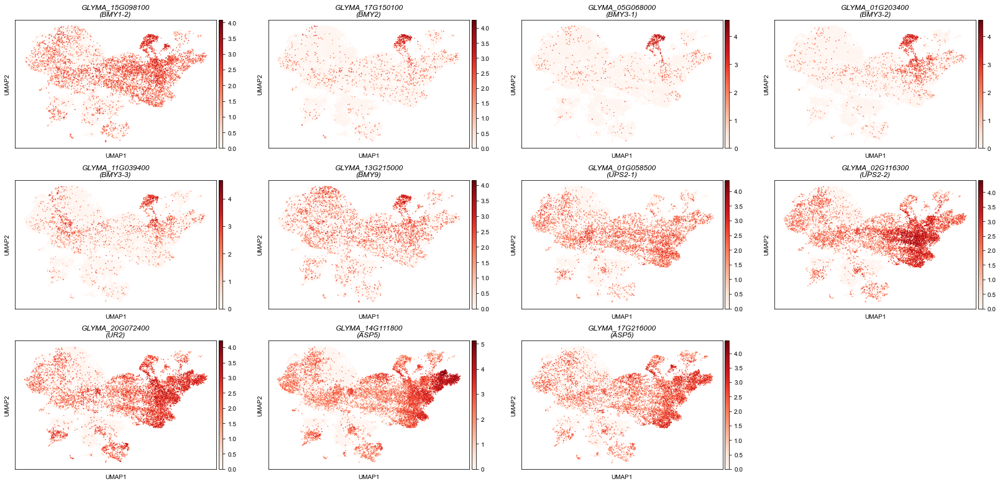

In [ ]:
axs = sc.pl.umap(
    ad,
    layer="normalize_log",
    cmap="Reds",
    color=ls_gene,
    title=ls_name,
    size=10, show=False, ncols=4
)
for ax in axs:
    plt.sca(ax)
    text = ax.get_title()
    plt.title(text, fontdict={'style': 'italic'})

In [ ]:
ls_gene = [
    "GLYMA_08G012800",
    "GLYMA_05G205900",
]
ls_name = [
    "SYMREM1.1",
    "SYMREM1.2",
]

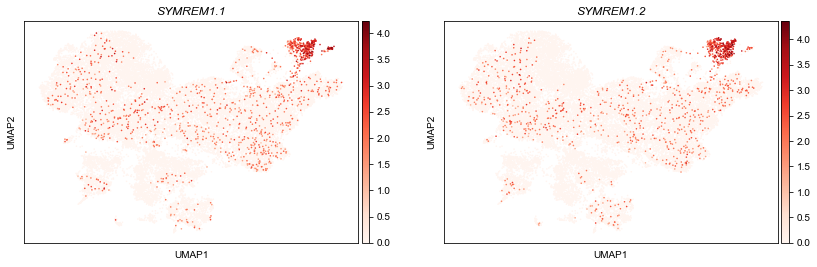

In [ ]:
axs = sc.pl.umap(
    ad,
    layer="normalize_log",
    cmap="Reds",
    color=ls_gene,
    title=ls_name,
    size=10, show=False
)
for ax in axs:
    plt.sca(ax)
    text = ax.get_title()
    plt.title(text, fontdict={'style': 'italic'})

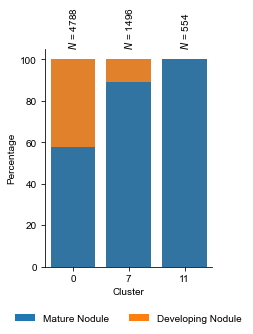

In [ ]:
with plt.rc_context({"figure.figsize": (3, 4)}):
    _ls = ["0", "7", "11"]
    singleCellTools.plotting.plotLabelPercentageInCluster(
        ad[ad.obs.eval("Cluster in @_ls & Sample != 'Root'")],
        "Cluster",
        "Sample_new",
        dt_kwargsForLegend={
            "bbox_to_anchor": [0.5, -0.3],
            "loc": "lower center",
            "ncol": 2,
        },
    )

In [ ]:
ls_gene = [
    "GLYMA_06G301500",
    "GLYMA_15G098100",
    "GLYMA_08G025500",
    "GLYMA_17G150100",
    "GLYMA_05G068000",
    "GLYMA_01G203400",
    "GLYMA_11G039400",
    "GLYMA_13G215000",
]
ls_name = [
    "BMY1-1",
    "BMY1-2",
    "BMY1-3",
    "BMY2",
    "BMY3-1",
    "BMY3-2",
    "BMY3-3",
    "BMY9",
]

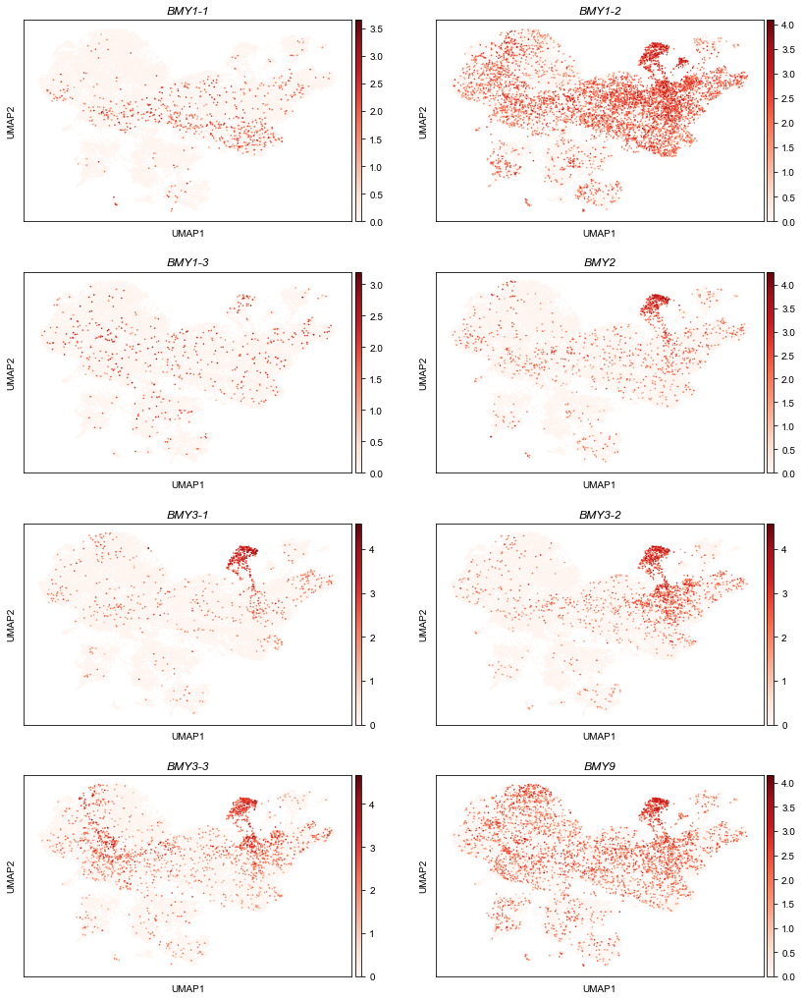

In [ ]:
axs = sc.pl.umap(
    ad,
    layer="normalize_log",
    cmap="Reds",
    color=ls_gene,
    title=ls_name,
    ncols=2,
    size=10,
    show=False,
)
for ax in axs:
    plt.sca(ax)
    text = ax.get_title()
    plt.title(text, fontdict={"style": "italic"})

# UC pseudotime

## cytotrace

In [ ]:
import scvelo as scv
import cellrank as cr

In [ ]:
_ls = ["0", "7", "11"]
ad_ciz = ad[ad.obs.eval("Sample in ['Large Nodule', 'Small Nodule'] & Cluster in @_ls")]

In [ ]:
ad_ciz.X = ad_ciz.layers['raw'].copy()

In [ ]:
sc.pp.filter_genes(ad_ciz, min_cells=10)

/public/home/liuzj/softwares/anaconda3/envs/sc_py/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.


In [ ]:
sc.pp.highly_variable_genes(ad_ciz, flavor='seurat_v3', n_top_genes=1000)

scv.pp.normalize_per_cell(ad_ciz)
sc.pp.log1p(ad_ciz)

ad_ciz.layers["spliced"] = ad_ciz.X
ad_ciz.layers["unspliced"] = ad_ciz.X

scv.pp.moments(ad_ciz, n_pcs=30, n_neighbors=30)
# scv.pp.moments(ad_ciz, n_neighbors=30, use_rep='X_scvi')

Normalized count data: X.
computing neighbors
    finished (0:00:02) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:15) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [ ]:
ad_ciz

AnnData object with n_obs × n_vars = 6838 × 31785
    obs: 'batch', 'n_genes', 'n_counts', 'percent_ct', 'leiden_0.0', 'leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5', 'leiden_0.6', 'leiden_0.7', 'leiden_0.8', 'leiden_0.9', 'leiden_1.0', 'leiden_1.1', 'leiden_1.2', 'leiden_1.3', 'leiden_1.4', 'leiden_1.5', 'leiden_1.6', 'leiden_1.7', 'leiden_1.8', 'leiden_1.9', 'leiden_2.0', 'leiden', 'UMI counts', 'Gene counts', 'Sample', 'leiden_R', 'Cluster', 'Cell type', '__group', 'Sample_two', 'Partition', 'UMI counts log10', 'Sample_new', 'wgcna_cluster', 'cluster_mergeUC', 'Sample_time', 'vb_ct'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std', 'SNF', 'means_ForPickMock', 'Cluster_2_mean', 'Cluster_2_expressedRatio', 'Cluster_12_mean', 'Cluster_12_expressedRatio', 'Cluster_9_mean', 'Cluster_9_expressedRatio', 'Cluster_4_mean', 'Cluster_4_expressedRatio', 'Cluster_0_mean', 'Cluste

In [ ]:
from cellrank.tl.kernels import CytoTRACEKernel

ctk = CytoTRACEKernel(ad_ciz)

In [ ]:
ctk.compute_transition_matrix(threshold_scheme="soft", nu=0.5)
ctk.compute_projection(basis="umap")

  0%|          | 0/6838 [00:00<?, ?cell/s]

In [ ]:
_dt = singleCellTools.basic.getadataColor(ad, "Cluster")
ad_ciz = singleCellTools.basic.setadataColor(ad_ciz, "Cluster", _dt)

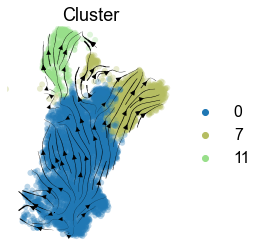

In [ ]:
with plt.rc_context({"figure.figsize": (3, 4)}):
    ax = scv.pl.velocity_embedding_stream(
        ad_ciz,
        color="Cluster",
        vkey="T_fwd",
        basis="umap",
        legend_loc="right",
        smooth=0.5,
        min_mass=3,
        title="Cluster",
        legend_fontsize=16,
        show=False,
        fontsize=18
    )
    plt.sca(ax)
    plt.xlim(3, 13)
#     for text in ax.texts:
#         text.set_color('black')
    plt.show()

In [ ]:
from cellrank.tl.estimators import GPCCA

g_fwd = GPCCA(ctk)
print(g_fwd)

GPCCA[n=6838, kernel=<CytoTRACEKernel[dnorm=False, scheme=soft, b=10.0, nu=0.5]>]


Mat Object: 1 MPI processes
  type: seqdense
1.0000000000000002e+00 -1.3451811240545000e-02 -6.7646899729889012e-03 2.2948015605340516e-02 -6.5394745934908025e-03 -1.7084586751363498e-02 3.8429786583646771e-04 -3.6594000640256093e-02 -2.2549879339336918e-02 5.4377189336820564e-03 -3.8900647407905962e-02 1.5281971719723590e-02 1.1929486536118791e-02 2.8574492438253440e-02 -4.8147440921371493e-02 6.5807556367455259e-03 -5.7265620685272689e-02 2.5269023116557450e-04 -2.5595612228181620e-02 -2.5380435719810197e-02 
0.0000000000000000e+00 9.9574004181986508e-01 -6.4117460866483164e-03 4.7159515370456748e-03 -1.9550522125730586e-02 2.0379591995956240e-02 2.7806638725345254e-02 -3.5513370589696426e-02 -1.6354801406212635e-02 1.3858483423501104e-03 1.1049553367956787e-02 -1.0011282480857361e-02 -2.8619389580210216e-04 8.6534741977150435e-03 -1.7615037311385560e-02 -9.0789982484496563e-03 -2.7557405991521386e-02 -5.1932883597652435e-03 -3.3778092836776142e-03 -3.2582799780006805e-02 
0.00000000

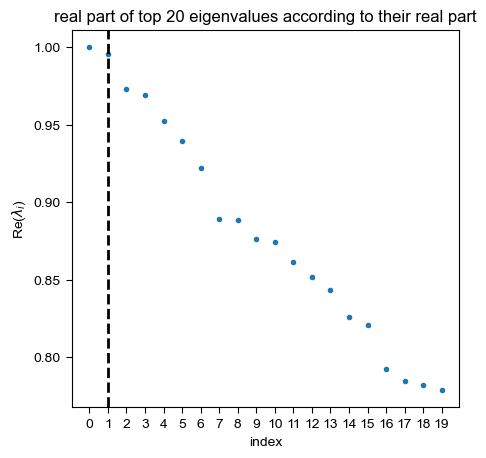

In [ ]:
g_fwd.compute_schur(n_components=20)
g_fwd.plot_spectrum(real_only=True)

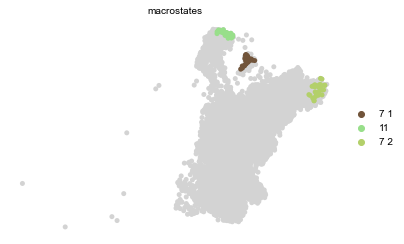

In [ ]:
g_fwd.compute_macrostates(n_states=3, cluster_key="Cluster")
g_fwd.plot_macrostates(
    discrete=True, legend_loc="right", size=100, basis="umap"
)

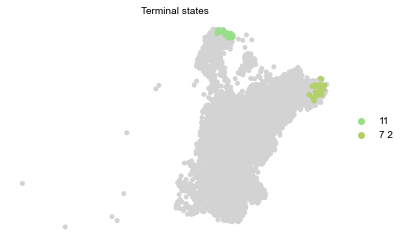

In [ ]:
ax = g_fwd.plot_macrostates(
    ['11', '7_2'],discrete=True, legend_loc="right", size=100, basis="umap", title='Terminal states'
)

In [ ]:
ax

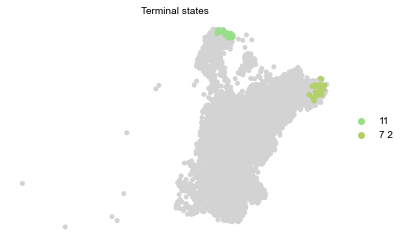

In [ ]:
ax = g_fwd.plot_macrostates(
    ['11', '7_2'],discrete=True, legend_loc="right", size=100, basis="umap", title='Terminal states'
)

In [ ]:
ax

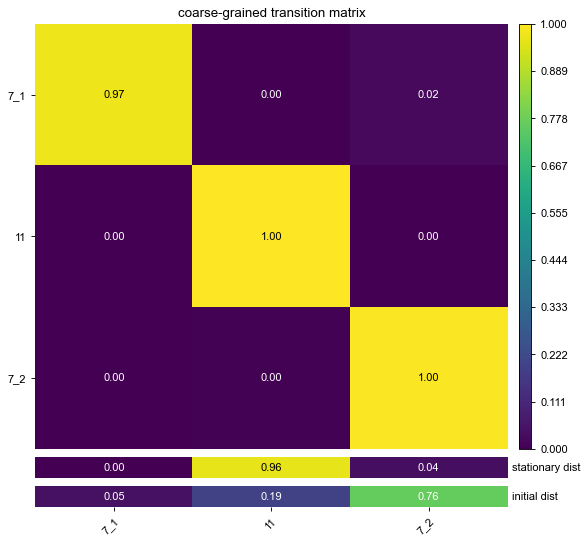

In [ ]:
g_fwd.plot_coarse_T(show_initial_dist=True)

In [ ]:
g_fwd.compute_macrostates(n_states=3, cluster_key="Cluster")
g_fwd.set_terminal_states_from_macrostates(names={"11": "11", "7_2": "7"}) # 7_1  has the smallest value in the coarse-grained stationary distribution, so we don't need to set it as a terminal state

  0%|          | 0/2 [00:00<?, ?/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple MacOS to find memory corruption errors
[0]PETSC ERROR: [0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 11 SEGV: Segmentation Violation, probably memory access out of range
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple MacOS to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 


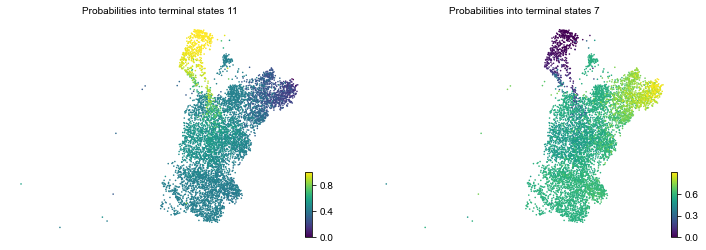

In [ ]:
g_fwd.compute_absorption_probabilities()
g_fwd.plot_absorption_probabilities(same_plot=False, size=10, basis="umap", title=['Probabilities into terminal states 11', 'Probabilities into terminal states 7'])

## RNA velocity

### load data

In [ ]:
dt_loomPath = {"nodule_large":"/data/Zhaijx/liuzj/projects/singleCell/soybean/02_result/20210922/step1_cellRanger/nodule_large/nodule_large/velocyto/nodule_large.loom",
"nodule_small":"/data/Zhaijx/liuzj/projects/singleCell/soybean/02_result/20210922/step1_cellRanger/nodule_small/nodule_small/velocyto/nodule_small.loom",
"root":"/data/Zhaijx/liuzj/projects/singleCell/soybean/02_result/20210922/step1_cellRanger/root/root/velocyto/root.loom"}

In [ ]:
dt_loom = {x:sc.read_loom(y) for x,y in dt_loomPath.items()}

In [ ]:
def reformatLoomAd(ad, batch):
    ad.obs = ad.obs.rename(index = lambda x:x.split(f"{batch}:")[-1][:-1] + '-1')
    return ad

In [ ]:
dt_loom= {x:reformatLoomAd(y, x) for x,y in dt_loom.items()}
ad_loom = sc.concat(dt_loom, index_unique='-batch-')
del(dt_loom)

In [ ]:
# %store ad_loom ad_ciz

Stored 'ad_loom' (AnnData)


In [ ]:
# %store -r ad_loom ad_ciz

In [ ]:
%store -r ad_loom

In [ ]:
import scvelo as scv
import cellrank as cr

In [ ]:
ad_cizForRnaVelocity = ad_loom[ad_ciz.obs.index]
ad_cizForRnaVelocity.obs = ad_ciz.obs

In [ ]:
ad_cizForRnaVelocity.obsm

AxisArrays with keys: 

In [ ]:
ad_cizForRnaVelocity.obsm = ad_ciz.obsm

### two samples

In [ ]:
ad_cizForRnaVelocity

AnnData object with n_obs × n_vars = 6838 × 56826
    obs: 'batch', 'n_genes', 'n_counts', 'percent_ct', 'leiden_0.0', 'leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5', 'leiden_0.6', 'leiden_0.7', 'leiden_0.8', 'leiden_0.9', 'leiden_1.0', 'leiden_1.1', 'leiden_1.2', 'leiden_1.3', 'leiden_1.4', 'leiden_1.5', 'leiden_1.6', 'leiden_1.7', 'leiden_1.8', 'leiden_1.9', 'leiden_2.0', 'leiden', 'UMI counts', 'Gene counts', 'Sample', 'leiden_R', 'Cluster', 'Cell type', '__group', 'Sample_two', 'Partition', 'UMI counts log10', 'Sample_new', 'wgcna_cluster', 'cluster_mergeUC', 'Sample_time', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size'
    obsm: 'X_scvi', 'X_scvi_withBatchEffect', 'X_umap', 'jaRelated_marker', 'scDblFinder', 'smDetected_auc', 'sm_auc', 'sn_wgcna_module', 'sn_wgcna_module_0605_triku10000', 'sn_wgcna_module_0605_triku10000_filtered'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [ ]:
scv.pp.filter_and_normalize(ad_cizForRnaVelocity, min_shared_counts=10, n_top_genes=1000)
scv.pp.moments(ad_cizForRnaVelocity, n_pcs=30, n_neighbors=30)

Filtered out 48130 genes that are detected 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 1000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:02) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [ ]:
scv.tl.recover_dynamics(ad_cizForRnaVelocity, n_jobs=64)
scv.tl.velocity(ad_cizForRnaVelocity, mode='dynamical')
scv.tl.velocity_graph(ad_cizForRnaVelocity,  n_jobs=64)

recovering dynamics (using 64/64 cores)


  0%|          | 0/858 [00:00<?, ?gene/s]

/public/home/liuzj/softwares/anaconda3/envs/sc_py/lib/python3.8/site-packages/scvelo/tools/dynamical_model.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.array([dm.alpha, dm.beta, dm.gamma, dm.pars[:3]]) / dm.m[-1]
/public/home/liuzj/softwares/anaconda3/envs/sc_py/lib/python3.8/site-packages/scvelo/tools/dynamical_model.py:716: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.array([dm.t, dm.tau, dm.t_, dm.pars[4]]) * dm.m[-1]


    finished (0:01:06) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:08) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 64/64 cores)


  0%|          | 0/6838 [00:00<?, ?cells/s]

/public/home/liuzj/softwares/anaconda3/envs/sc_py/lib/python3.8/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:13) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [ ]:
# %store ad_cizForRnaVelocity

Stored 'ad_cizForRnaVelocity' (AnnData)


In [ ]:
_dt = singleCellTools.basic.getadataColor(ad, 'Cluster')
singleCellTools.basic.setadataColor(ad_cizForRnaVelocity, 'Cluster', _dt)

AnnData object with n_obs × n_vars = 6838 × 1000
    obs: 'batch', 'n_genes', 'n_counts', 'percent_ct', 'leiden_0.0', 'leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5', 'leiden_0.6', 'leiden_0.7', 'leiden_0.8', 'leiden_0.9', 'leiden_1.0', 'leiden_1.1', 'leiden_1.2', 'leiden_1.3', 'leiden_1.4', 'leiden_1.5', 'leiden_1.6', 'leiden_1.7', 'leiden_1.8', 'leiden_1.9', 'leiden_2.0', 'leiden', 'UMI counts', 'Gene counts', 'Sample', 'leiden_R', 'Cluster', 'Cell type', '__group', 'Sample_two', 'Partition', 'UMI counts log10', 'Sample_new', 'wgcna_cluster', 'cluster_mergeUC', 'Sample_time', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime'
    var: 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fi

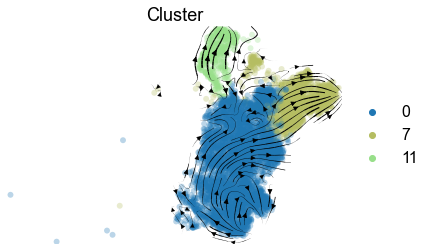

In [ ]:
scv.pl.velocity_embedding_stream(
        ad_cizForRnaVelocity,
        color="Cluster",
        basis="umap",
        legend_loc="right",
        smooth=0.5,
        min_mass=0,
        title="Cluster",
        legend_fontsize=16,
        fontsize=18,
    )

In [ ]:
scv.tl.paga(ad_cizForRnaVelocity, groups='Cluster', vkey='velocity')

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:03) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


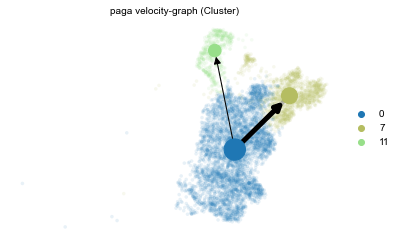

In [ ]:
scv.pl.paga(ad_cizForRnaVelocity, basis='umap', vkey='velocity', node_size_scale=1.5, min_edge_width=1, max_edge_width=5, edge_width_scale=2, use_raw=False, size=50, alpha=0.1)

## monocle3

In [ ]:
Seurat = importr('Seurat')
monocle3 = importr('monocle3')
SeuratWrappers = importr('SeuratWrappers')
ggplot2 = importr('ggplot2')

In [ ]:
def so2cds(so):
    with ro.local_context() as rlc:
        rlc['so'] = so
        R("""
        cds <- as.cell_data_set(so)
        cds <- estimate_size_factors(cds)
        cds@rowRanges@elementMetadata@listData[["gene_short_name"]] <- rownames(so[["RNA"]])
        """)
        cds = rlc['cds']
    return cds

In [ ]:
_ls = ["0", "7", "11"]
_ad = ad[ad.obs.eval("Sample in ['Large Nodule', 'Small Nodule'] & Cluster in @_ls")]
so_ifz = ad2so(_ad)

/public/home/liuzj/softwares/anaconda3/envs/sc_py/lib/python3.8/site-packages/rpy2/robjects/conversion.py:28: DeprecationWarning: The use of {name} in module {__name__} is deprecated. Use (__name__}.get_conversion() instead of {__name__}.converter.
  warnings.warn(




/public/home/liuzj/softwares/anaconda3/envs/sc_py/lib/python3.8/site-packages/rpy2/robjects/conversion.py:28: DeprecationWarning: The use of {name} in module {__name__} is deprecated. Use (__name__}.get_conversion() instead of {__name__}.converter.
  warnings.warn(




In [ ]:
cds_ifz = so2cds(so_ifz)

In [ ]:
ls_cizHvg = ad_ciz.var.loc[lambda df:df['highly_variable']].index.to_list() >> F(map, lambda x:x.replace('_', '-')) >> F(list)
arR_cizHvg = R.c(*ls_cizHvg)

In [ ]:
%%R -i cds_ifz -i arR_cizHvg
ar_umap <- reducedDim(cds_ifz, 'UMAP')

In [ ]:
%%R 
cds_ifz <- preprocess_cds(cds_ifz, num_dim = 50, use_genes=arR_cizHvg)

# cds <- preprocess_cds(cds, num_dim = 30, use_genes = lsR_hvgGene)
cds_ifz <- align_cds(cds_ifz, alignment_group = "batch")
cds_ifz <- reduce_dimension(cds_ifz)

Please remember to cite:
	 Haghverdi L, Lun ATL, Morgan MD, Marioni JC (2018). 'Batch effects in single-cell RNA-sequencing data are corrected by matching mutual nearest neighbors.' Nat. Biotechnol., 36(5), 421-427. doi: 10.1038/nbt.4091




In [ ]:
%%R
cds_ifz <- cluster_cells(cds_ifz)

In [ ]:
%%R
cds_ifz <- learn_graph(cds_ifz)

  |======================================================================| 100%


/public/home/liuzj/softwares/anaconda3/envs/sc_py/lib/python3.8/site-packages/rpy2/ipython/rmagic.py:813: DeprecationWarning: The `source` parameter emit a  deprecation warning since IPython 8.0, it had no effects for a long time and will  be removed in future versions.
  displaypub.publish_display_data(data=disp_d, source=tag,


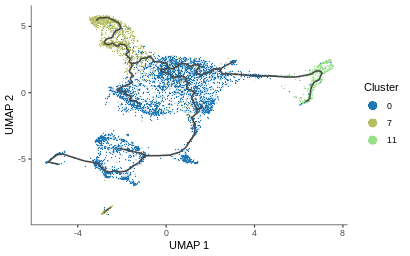

In [ ]:
%%R -w 410 -h 256
plot_cells(cds_ifz, label_groups_by_cluster=T, color_cells_by = "Cluster", group_label_size=0, 
           label_cell_groups=F, label_roots = F,label_leaves = F, label_branch_points =F) + 
    ggplot2::scale_color_manual(values=c('#1f77b4', '#b5bd61', '#98df8a')) +
    theme(legend.position = 'right') 

In [ ]:
%%R
cds_ifz <- order_cells(cds_ifz)

Listening on http://127.0.0.1:6533

Error: cannot open display: localhost:25.0


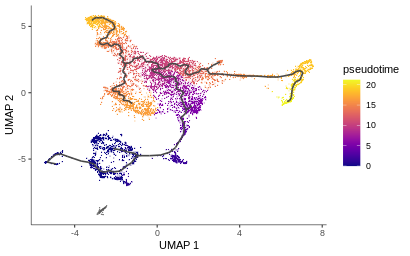

In [ ]:
%%R -w 410 -h 256
plot_cells(cds_ifz,
           color_cells_by = "pseudotime",
           label_cell_groups=FALSE,
           label_leaves=FALSE,
           label_branch_points=FALSE,
           label_roots=FALSE,
           graph_label_size=1.5)

# zoom in IC

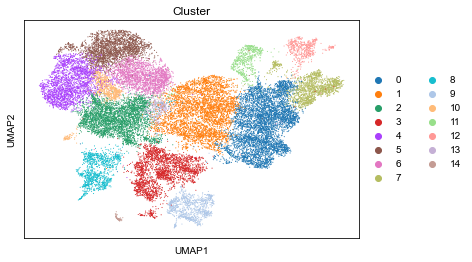

In [ ]:
sc.pl.umap(ad, color='Cluster')

In [ ]:
sc.tl.leiden(ad, resolution=0.1, restrict_to=('Cluster', ['12']))

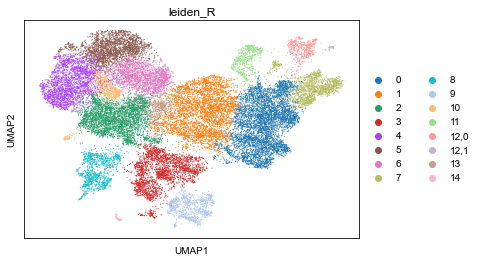

In [ ]:
ax = sc.pl.umap(ad, color='leiden_R', show=False)

In [ ]:
ad.obs['leiden_R'] = ad.obs['leiden_R'].map(lambda x:x.replace(',', '-'))

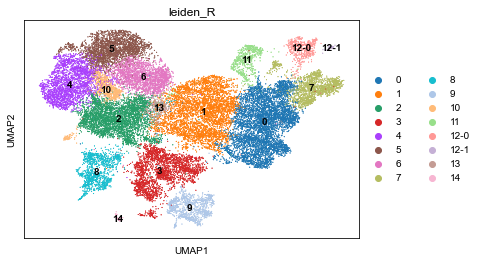

In [ ]:
ax = sc.pl.umap(ad, color='leiden_R', show=False, legend_loc='on data')
sc.pl.umap(ad, color='leiden_R', ax=ax)

Text(0, 0.5, '')

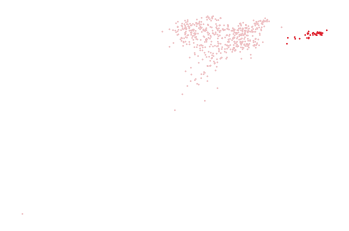

In [ ]:
sc.pl.umap(
    ad[ad.obs.eval("Cluster in ['12']")],
    color="leiden_R", show=False, palette=['#EEBFC2', '#DE1E2A'], legend_loc=None,size=12
)
sns.despine(left=True, bottom=True)
plt.title('')
plt.xlabel('')
plt.ylabel('')

## ALL detected SM

In [ ]:
ls_allDetectedSmGenes = (
    pd.read_excel(
        "/data/Zhaijx/liuzj/projects/singleCell/soybean/01_data/yangweicai/1-s2.0-S1673852722001242-mmc1.xlsx"
    )
    .dropna(subset=["Protein ID"])
    .eval(
        "geneID = `Protein ID`.str.replace('Glyma.', 'GLYMA_').str.split('.').str[0]",
        engine="python",
    )
    .query("geneID in @ad.var.index")["geneID"]
    .to_list()
)

on disk mode: False, transfer `<class 'scipy.sparse.csc.csc_matrix'>` to R:  End. Elapsed time: 33


(Non-detected genes are shuffled at the end of the ranking. Keep it in mind when choosing the threshold for calculating the AUC).



 min   1%   5%  10%  50% 100% 
 460  559  677  757 1226 3880 


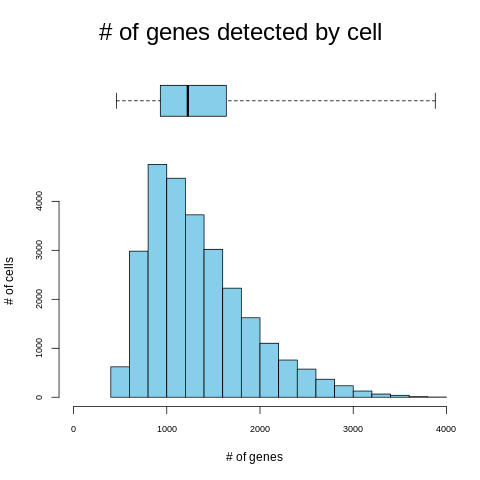

transfer `data.frame` to python:  End. Elapsed time: 4
transfer `data.frame` to python:  End. Elapsed time: 0


In [ ]:
singleCellTools.geneEnrichInfo.getAUCellScore(
    ad,
    {"sm": ls_allDetectedSmGenes},
    layer="raw",
    aucMaxRank=1000,
    label="smDetected_auc",
)

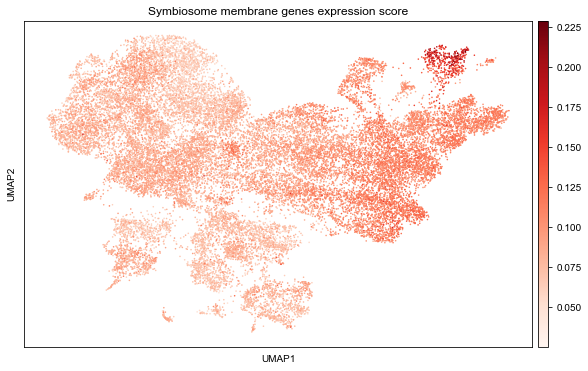

In [ ]:
with plt.rc_context({"figure.figsize": (10, 6)}):
    _ad = singleCellTools.plotting.obsmToObs(ad, "smDetected_auc")
    sc.pl.umap(
        _ad,
        color=_ad.uns["plot_obsm"],
        title=["Symbiosome membrane genes expression score"],
        cmap="Reds",
        size=10,
    )

In [ ]:
ls_palette = ["#EEBFC2", "#DE1E2A", "#126FB0", "#B5BE62", "#A0E192"]

Text(0.5, 0, '')

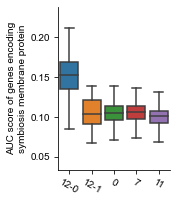

In [ ]:
fig, ax = plt.subplots(figsize=(2, 3))

sns.boxplot(
    data=_ad.obs.query("Cluster in ['0', '7', '11', '12']").eval(
        "leiden_R = leiden_R.cat.set_categories(['12-0', '12-1', '0', '7', '11'])",
        engine="python",
    ),
    x="leiden_R",
    y="sm", fliersize=0
)
plt.xticks(rotation=-30, ha="center")
plt.ylabel("AUC score of genes encoding\nsymbiosis membrane protein")

for i, (box, color) in enumerate(zip(ax.artists, ls_palette)):
    box.set_edgecolor(color)
    box.set_facecolor("white")
    # iterate over whiskers and median lines
    for j in range(6 * i, 6 * (i + 1)):
        ax.lines[j].set_color(color)
sns.despine()
plt.xlabel('')

In [ ]:
dt_smAuc = (
    _ad.obs.query("Cluster in ['0', '7', '11', '12']")
    .groupby("leiden_R")["sm"]
    .agg(list)
    .dropna()
    .to_dict()
)

In [ ]:
from scipy.stats import median_test
from itertools import product

In [ ]:
for x, y in product(dt_smAuc.keys(), dt_smAuc.keys()):
    p = median_test(dt_smAuc[x], dt_smAuc[y])[1]
#     if p < 0.05:
    print(x, y, median_test(dt_smAuc[x], dt_smAuc[y])[1])

0 0 1.0
0 7 0.2034484396014494
0 11 9.373972846965979e-14
0 12-0 8.224499692628447e-103
0 12-1 0.6260464254831073
7 0 0.2034484396014494
7 7 1.0
7 11 5.5428443678344805e-15
7 12-0 3.683277465427867e-122
7 12-1 0.6222062973914226
11 0 9.373972846965979e-14
11 7 5.5428443678344805e-15
11 11 1.0
11 12-0 1.0057250379484212e-150
11 12-1 0.8592595902966044
12-0 0 8.224499692628681e-103
12-0 7 3.683277465427867e-122
12-0 11 1.0057250379484212e-150
12-0 12-0 1.0
12-0 12-1 4.674072547402916e-10
12-1 0 0.6260464254831073
12-1 7 0.6222062973914226
12-1 11 0.8592595902966044
12-1 12-0 4.674072547402916e-10
12-1 12-1 1.0


In [ ]:
median_test(dt_smAuc['0'], dt_smAuc['12-1'])

(0.23746035776330274,
 0.6260464254831073,
 0.10513313313313313,
 array([[2434,   17],
        [2431,   21]]))

In [ ]:
# ad.write_h5ad(f"{dir_result}/ad_brief_com_version_1.h5ad")
f"{dir_result}/ad_brief_com_version_1.h5ad"

'/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/analysis/noduleWithRoot//ad_brief_com_version_1.h5ad'

## marker

In [ ]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad, 'raw', 'leiden_R')

In [ ]:
ad.obs['leiden_R'].str.replace(',', '-')

AAACCCAAGACGCAGT-1-batch-nodule_large       2
AAACCCAAGAGGATCC-1-batch-nodule_large    12-0
AAACCCACAAATACAG-1-batch-nodule_large       9
AAACCCACAGCAGTAG-1-batch-nodule_large       4
AAACCCACAGCTGTAT-1-batch-nodule_large       2
                                         ... 
TTTGTTGGTGTTACAC-1-batch-root               5
TTTGTTGTCAGTCCGG-1-batch-root               4
TTTGTTGTCCTCTTTC-1-batch-root               3
TTTGTTGTCGGTTGTA-1-batch-root               3
TTTGTTGTCTCATTTG-1-batch-root               6
Name: leiden_R, Length: 26712, dtype: object

In [ ]:
_dt = {'Developping Nodule': "Developing Nodule"}
ad.obs['Sample_new'] = ad.obs['Sample_new'].map(lambda x:_dt.get(x,x))

In [ ]:
ad.obs['Sample_new']

AAACCCAAGACGCAGT-1-batch-nodule_large    Mature Nodule
AAACCCAAGAGGATCC-1-batch-nodule_large    Mature Nodule
AAACCCACAAATACAG-1-batch-nodule_large    Mature Nodule
AAACCCACAGCAGTAG-1-batch-nodule_large    Mature Nodule
AAACCCACAGCTGTAT-1-batch-nodule_large    Mature Nodule
                                             ...      
TTTGTTGGTGTTACAC-1-batch-root                     Root
TTTGTTGTCAGTCCGG-1-batch-root                     Root
TTTGTTGTCCTCTTTC-1-batch-root                     Root
TTTGTTGTCGGTTGTA-1-batch-root                     Root
TTTGTTGTCTCATTTG-1-batch-root                     Root
Name: Sample_new, Length: 26712, dtype: category
Categories (3, object): ['Mature Nodule', 'Developing Nodule', 'Root']

In [ ]:
import importlib

importlib.reload(singleCellTools.plotting)

<module 'jpy_tools.singleCellTools.plotting' from '/public/home/liuzj/softwares/anaconda3/lib/python3.8/site-packages/jpy_tools/singleCellTools/plotting.py'>

Text(0.5, 0, 'Sub-cluster')

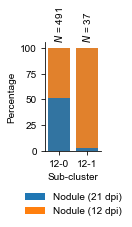

In [ ]:
fig, ax = plt.subplots(figsize=(1, 2))
singleCellTools.plotting.plotLabelPercentageInCluster(
    ad[ad.obs.eval("Cluster in ['12'] & Sample != 'Root'")],
    "leiden_R",
    "Sample_time",
    ax=ax,
    dt_kwargsForLegend=dict(loc="upper center", bbox_to_anchor=(0.5, -0.3), ncol=1)
)
plt.xlabel("Sub-cluster")

Text(0.5, 0, 'Sub-cluster')

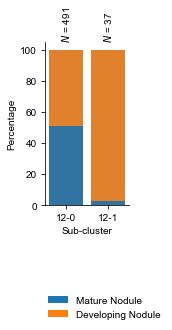

In [ ]:
fig, ax = plt.subplots(figsize=(1.5, 3))
singleCellTools.plotting.plotLabelPercentageInCluster(
    ad[ad.obs.eval("Cluster in ['12'] & Sample != 'Root'")],
    "leiden_R",
    "Sample_new",
    ax=ax,
    dt_kwargsForLegend=dict(loc="upper left", bbox_to_anchor=(-0.07, -0.5), ncol=1),
)
ax.yaxis.set_major_locator(ticker.MultipleLocator(20))
plt.xlabel("Sub-cluster")

In [ ]:
ls_c12_1ClusterGenes = (
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '12,1' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")
    .query("gene in @ls_knownSnfGenes")["gene"]
    .to_list()
)

In [ ]:
ls_c12_1ClusterGenes = (
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '12,1' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")
    .query("gene in @ls_knownSnfGenes")["gene"]
    .to_list()
)

In [ ]:
ls_c12_1ClusterGenes = (
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '12,1' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")["gene"]
    .to_list()
)

In [ ]:
ad.uns["leiden_R_cellexES"].query(
    "leiden_R == '12,1' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01"
).nlargest(50, "enrichScore").assign(
    SNF=lambda df: np.where(df["gene"].isin(ls_knownSnfGenes), "True", "")
).reset_index(drop=True).to_excel(f"{dir_result}/12_1_marker.xlsx")

transfer `data.frame` to python:  start
transfer `data.frame` to python:  End. Elapsed time: 0


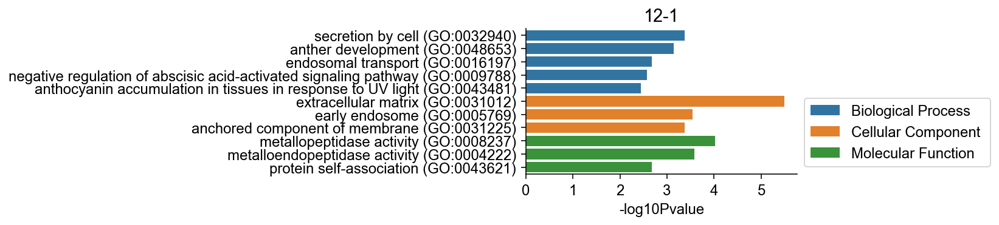

In [ ]:

df_go = enrichmentAnalysisGO(ls_c12_1ClusterGenes, ad.var.index.to_list(), dt_goToCat = dt_goToCat,  qvalueCutoff=0.2, pvalueCutoff=0.05)
if df_go.empty:
    print("Empty")
df_go.insert(0, 'Cluster', '12-1')

fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
sns.barplot(data=df_go, x="-log10Pvalue", y="Description", hue = 'Category', ax=ax, dodge=False, palette=dt_goColor)
plt.legend(loc='lower left', bbox_to_anchor=[1,0])
plt.ylabel('')
sns.despine(top=True, right=True)
plt.title('12-1')
plt.show()

In [ ]:
from matplotlib import ticker

In [ ]:
len([x for x in ad.var.index if x in df_nodulationRelatedGene['Soybean Gene Parsed ID'].to_list()]), len(ad.var.index)

(251, 39337)

In [ ]:
[x for x in ls_c12SpercificGenes if x in df_nodulationRelatedGene['Soybean Gene Parsed ID'].to_list()], len(ls_c12SpercificGenes)

(['GLYMA_07G025800'], 33)

In [ ]:
[x for x in ls_c12_1ClusterGenes if x in df_nodulationRelatedGene['Soybean Gene Parsed ID'].to_list()], len(ls_c12_1ClusterGenes)

(['GLYMA_13G093600',
  'GLYMA_11G244800',
  'GLYMA_06G184400',
  'GLYMA_10G198700',
  'GLYMA_16G177500',
  'GLYMA_19G114600'],
 50)

In [ ]:
[x for x in ls_c12_0ClusterGenes if x in df_nodulationRelatedGene['Soybean Gene Parsed ID'].to_list()], len(ls_c12_0ClusterGenes)

([], 38)

(array([0, 1, 2, 3]),
 [Text(0, 0, '12-1 specific genes'),
  Text(1, 0, '12-0 specific genes'),
  Text(2, 0, '12 specific genes'),
  Text(3, 0, 'All detected genes')])

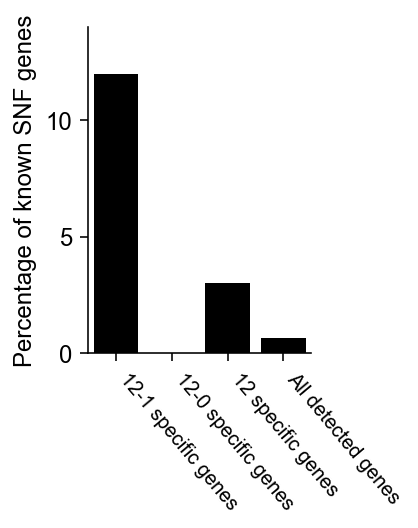

In [ ]:
fig, ax = plt.subplots(figsize=(2, 3))

# sns.barplot(y=["1", "2", "3"], x=[100, 100, 100], palette=["#D3D3D3"])
sns.barplot(
    x=["1", "2", "3", "4"],
    y=[6 / 50 * 100, 0 / 38 * 100, 1/33 * 100,  251 / 39337 * 100],
    palette=["black"],
)
plt.ylabel("Percentage of known SNF genes")
plt.ylim(0, 14)
ax.yaxis.set_major_locator(ticker.MultipleLocator(5))

plt.xticks(
    [0, 1, 2, 3], ["12-1 specific genes", "12-0 specific genes", "12 specific genes", "All detected genes"], rotation=-90, ha='center', fontsize=10
)
sns.despine()
plt.xticks(rotation=-50, ha='left')
# ls_legendHandle = []
# ls_legendLabel = ["Others", "Known SNF genes"]
# ls_legendHandle.append(plt.Rectangle((0, 0), 1, 1, fc="#D3D3D3", edgecolor="none"))
# ls_legendHandle.append(plt.Rectangle((0, 0), 1, 1, fc="black", edgecolor="none"))
# plt.legend(
#     ls_legendHandle[::-1],
#     ls_legendLabel[::-1],
#     frameon=False,
#     **dict(loc="upper left", bbox_to_anchor=(-0.5, -0.6), ncol=2)
# )

In [ ]:
ad.var["means_ForPickMock"] = ad.to_df('normalize_log').mean()
ad.var["bins_ForPickMock"] = pd.qcut(
    ad.var["means_ForPickMock"], 50, duplicates="drop"
)

In [ ]:
import tqdm


def staticTestForModuleGeneCounts(ad, ls_gene, propotion, shuffleCounts=500):
    ls_snfPropotion = []
    for i in tqdm.tqdm(range(shuffleCounts)):
        ls_bgGenes = singleCellTools.geneEnrichInfo.getBgGene(
            ad, ls_gene, usePreBin="bins_ForPickMock", seed=i, replacement=False
        )
        ls_bgSnfGenes = [
            x
            for x in ls_bgGenes
            if x in df_nodulationRelatedGene["Soybean Gene Parsed ID"].to_list()
        ]
        ls_snfPropotion.append(len(ls_bgSnfGenes) / len(ls_bgGenes))
    sns.histplot(ls_snfPropotion, bins=10)
    plt.axvline(propotion)
    ax = plt.gca()

    #     ls_snfPropotion.append(propotion)
    pvalue = len([x for x in ls_snfPropotion if x >= propotion]) / shuffleCounts
    #     df_snfPropotion = pd.concat([pd.Series(ls_snfPropotion), pd.Series(ls_snfPropotion).rank(ascending=False)], axis=1)
    #     pvalue = df_snfPropotion.loc[lambda df:df[0] == propotion].iat[0, -1] / shuffleCounts
    plt.text(
        propotion,
        0.95,
        f"P-value = {pvalue}",
        ha="right",
        transform=ax.get_xaxis_transform(),
    )
    plt.show()
    return ls_snfPropotion

In [ ]:
ls_c12_1ClusterGenes = (
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '12,1' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")["gene"]
    .to_list()
)

100%|██████████| 1000/1000 [01:59<00:00,  8.34it/s]


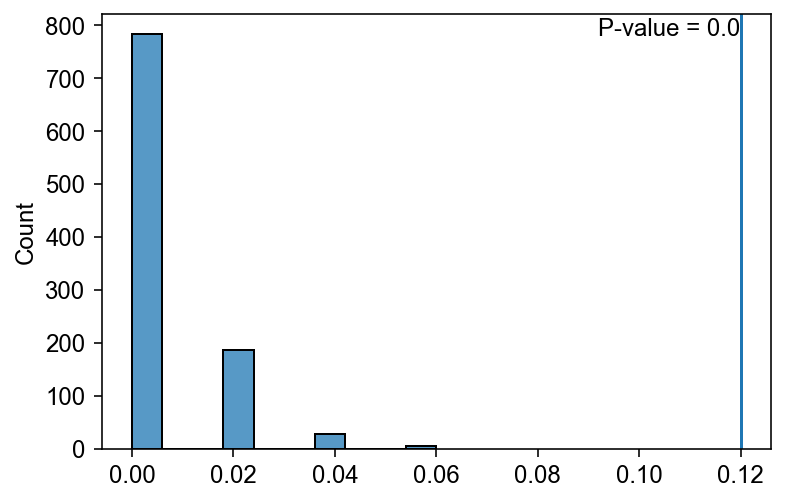

In [ ]:
ls_snfPropotion = staticTestForModuleGeneCounts(ad, ls_c12_1ClusterGenes, 0.12, 1000)

In [ ]:
from matplotlib import ticker

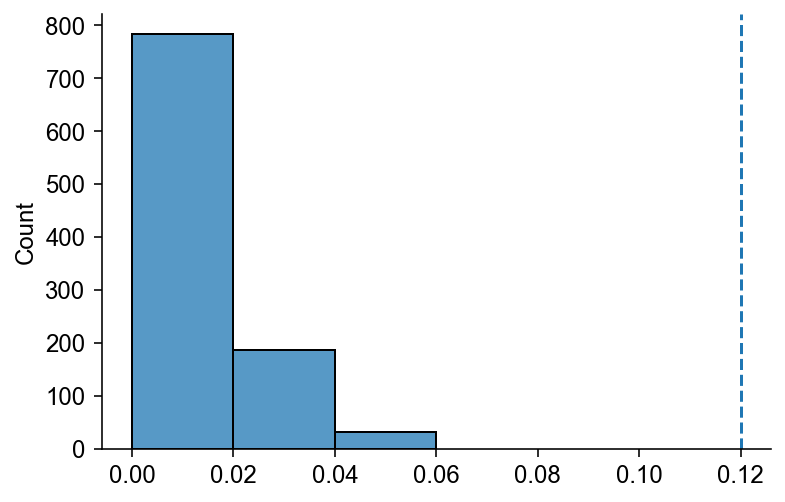

In [ ]:
sns.histplot(ls_snfPropotion, bins=[0, 0.02, 0.04, 0.06], stat='count')
plt.axvline(0.12, ls='--')
ax = plt.gca()
ax.xaxis.set_major_locator(ticker.MultipleLocator(0.02))
sns.despine()

In [ ]:
plt.title('$\it{text you want to show in italics}$')

In [ ]:
sc.pl.correlation_matrix?

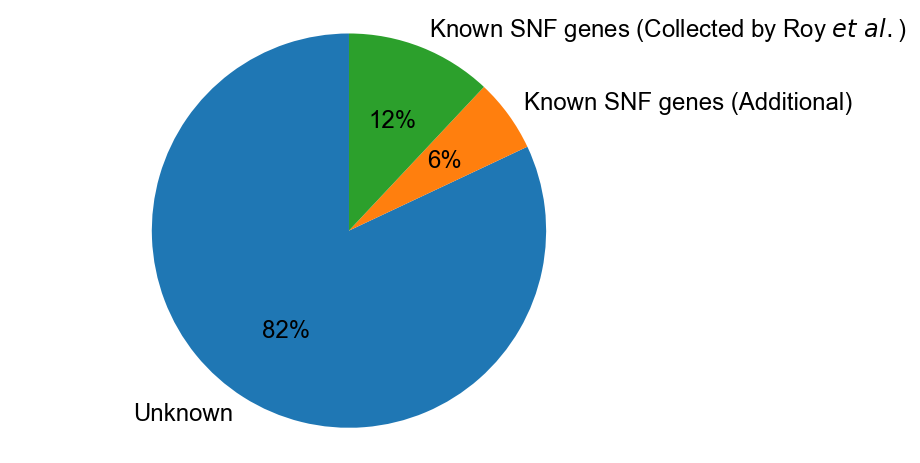

In [ ]:
labels = (
    "Unknown",
    "Known SNF genes (Additional)",
    "Known SNF genes (Collected by Roy $\it{et\ al.}$)",
)
sizes = [41, 3, 6]
explode = (0, 0, 0)  # only "explode" the 2nd slice (i.e. 'Hogs')

fig1, ax1 = plt.subplots()
ax1.pie(sizes, labels=labels, autopct="%1.0f%%", startangle=90)
ax1.axis("equal")  # Equal aspect ratio ensures that pie is drawn as a circle.

plt.show()

In [ ]:
ls_c12_1ClusterGenes = [
    "GLYMA_13G093600", 1 SPK1
    "GLYMA_05G088400", 2 VPY
    "GLYMA_02G076900", 0 NNL1
    "GLYMA_11G244800", 1 NPL
    "GLYMA_06G184400", 1 RINRK1
    "GLYMA_10G198700", 1 RPG
    "GLYMA_19G146000", 0 SPL9d
    "GLYMA_16G177500", 1 CBS1
    "GLYMA_19G114600", 2 VPY
]

In [ ]:
ls_c12_1ClusterGenes = [
    "GLYMA_13G093600",
    "GLYMA_05G088400",
    "GLYMA_02G076900",
    "GLYMA_11G244800",
    "GLYMA_06G184400",
    "GLYMA_10G198700",
    "GLYMA_19G146000",
    "GLYMA_16G177500",
    "GLYMA_19G114600",
]

In [ ]:
ls_c12_1ClusterNames = [
    "SPK1",
    "VPY",
    "NNL1",
    "NPL",
    "RINRK1",
    "RPG",
    "SPL9d",
    "CBS1",
    "VPY",
]
ls_c12_1ClusterNames = [f"{x}\n({y})" for x,y in zip(ls_c12_1ClusterGenes, ls_c12_1ClusterNames)]

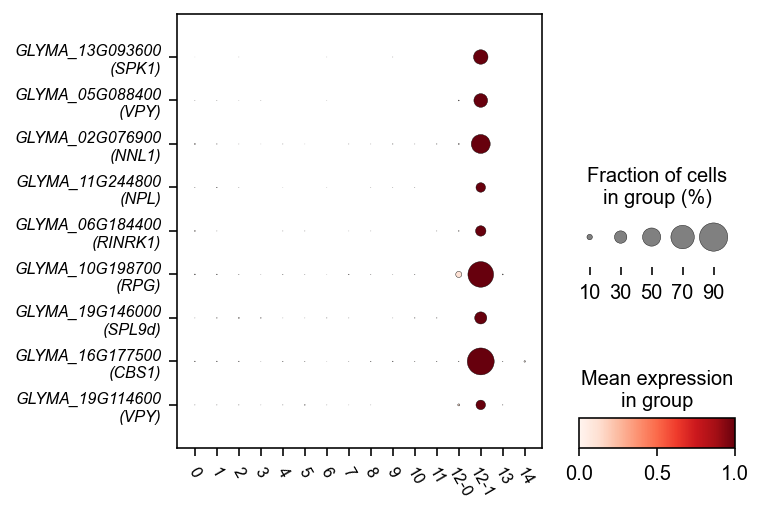

In [ ]:
axs = sc.pl.dotplot(
    ad,
    ls_c12_1ClusterGenes,
    groupby="leiden_R",
    cmap="Reds",
    layer="normalize_log",
    swap_axes=True,
    show=False,
    figsize=(5, 4),
    standard_scale="var",
)
plt.sca(axs["mainplot_ax"])
plt.yticks(
    range(len(ls_c12_1ClusterNames)) | F(map, lambda x: x + 0.5) | F(list),
    ls_c12_1ClusterNames,
    style="italic",
    size=8,
)
plt.xticks(rotation=-60, ha="center", size=8)
plt.show()

In [ ]:
from matplotlib import ticker

In [ ]:
axs

[<AxesSubplot:title={'center':'GLYMA_13G093600\n(SPK1)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_05G088400\n(VPY)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_02G076900\n(NNL1)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_11G244800\n(NPL)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_06G184400\n(RINRK1)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_10G198700\n(RPG)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_19G146000\n(SPL9d)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_16G177500\n(CBS1)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_19G114600\n(VPY)'}, xlabel='UMAP1', ylabel='UMAP2'>]

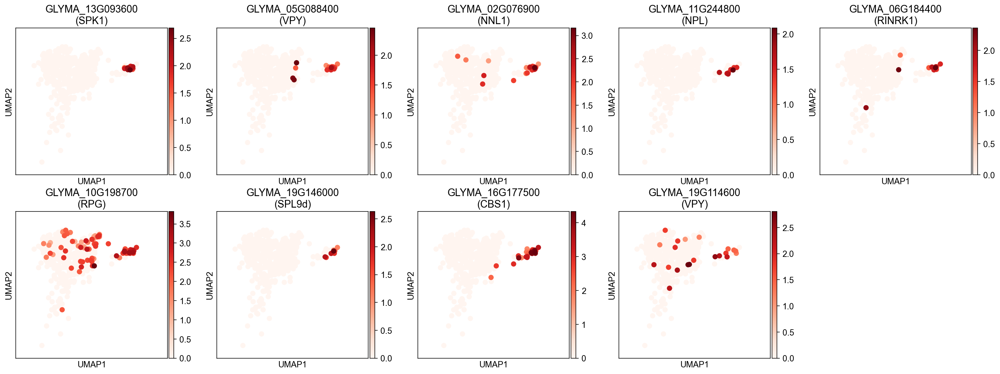

In [ ]:
with plt.rc_context({"figure.figsize": (4, 4)}):
    axs = sc.pl.umap(
        ad[ad.obs.eval("Cluster == '12'")],
        color=ls_c12_1ClusterGenes,
        title=ls_c12_1ClusterNames,
        cmap="Reds",
        layer="normalize_log",
        ncols=5,
    #     size=15,
        show=False
    )
    for ax in axs:
        plt.sca(ax)
    #     ax.xaxis.set_major_locator(ticker.MultipleLocator(2))
    #     ax.yaxis.set_major_locator(ticker.MultipleLocator(2))
        plt.xlim(8,13)
        plt.ylim(8,15)

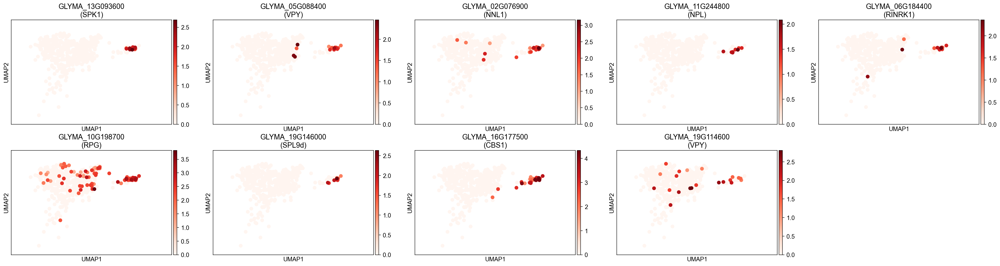

In [ ]:
axs = sc.pl.umap(
    ad[ad.obs.eval("Cluster == '12'")],
    color=ls_c12_1ClusterGenes,
    title=ls_c12_1ClusterNames,
    cmap="Reds",
    layer="normalize_log",
    ncols=5,
#     size=15,
    show=False
)
for ax in axs:
    plt.sca(ax)
#     ax.xaxis.set_major_locator(ticker.MultipleLocator(2))
#     ax.yaxis.set_major_locator(ticker.MultipleLocator(2))
    plt.xlim(8,13)
    plt.ylim(8,15)

In [ ]:
df_cellexEs = ad.uns["leiden_R_cellexES"].query("leiden_R == '12,1'")

## expression in bulk rh data

In [ ]:
ls_c12_1ClusterGenes = (
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '12,1' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")["gene"]
    .to_list()
)

ls_c12_0ClusterGenes = (
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '12,0' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")["gene"]
    .to_list()
)

In [ ]:
df_rhRpkm = pd.read_excel("/data/Zhaijx/liuzj/projects/singleCell/soybean/01_data/bulkRHData/Soybean RH _FPKM.xls")

In [ ]:
ad_rh =sc.AnnData(df_rhRpkm.iloc[:, :7].set_index('gene')).T

In [ ]:
ad_rh.var = ad_rh.var.rename(index = lambda sr:sr.replace('Glyma.', 'GLYMA_'))

In [ ]:
ad_rh.X = np.log1p(ad_rh.X)

In [ ]:
ad_rh.obs = ad_rh.obs.assign(id = lambda x:x.index, time = lambda x:x.index.str[:2], treat = lambda x:x.index.str[2:4])

In [ ]:
ad_rh = ad_rh[:, ad_rh.X.sum(0) > 0]

In [ ]:
_ls = ['12IN_RH', '12UN_RH', '24IN_RH', '24UN_RH', '48IN_RH', '48UN_RH']
_ls = [_ls[x] for x in [0,2,4,1,3,5]]
ad_rh = ad_rh[_ls]
ad_rh.obs['id'] = ad_rh.obs['id'].astype('category').cat.set_categories(_ls)

Trying to set attribute `.obs` of view, copying.


In [ ]:
# ad_rh = ad_rh[[0,1,3,4]]

In [ ]:
ad_rh.layers['X'] = ad_rh.X

Trying to set attribute `.obs` of view, copying.


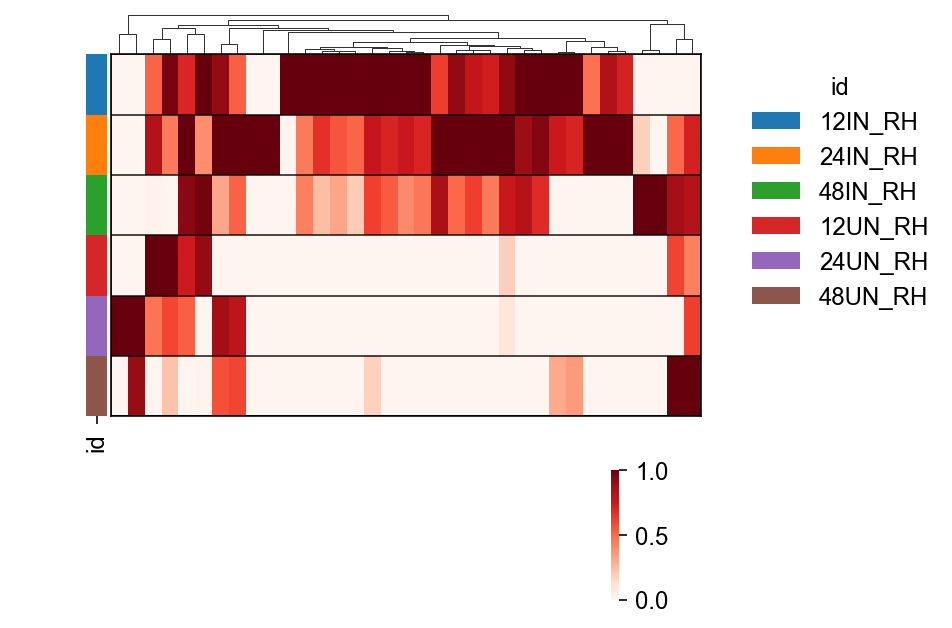

In [ ]:
singleCellTools.plotting.clustermap(
    ad_rh,
    {"a": [x for x in ls_c12_1ClusterGenes if x in ad_rh.var.index]},
    obsAnno="id",
    layer="X",
    add_gene_name=False,
    col_cluster=True,
    dendrogram_ratio=0.1,
    figsize=(6, 5), standard_scale =1
)

In [ ]:
ls_c12_0ClusterGenes = (
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '11' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")["gene"]
    .to_list()
)

Trying to set attribute `.obs` of view, copying.


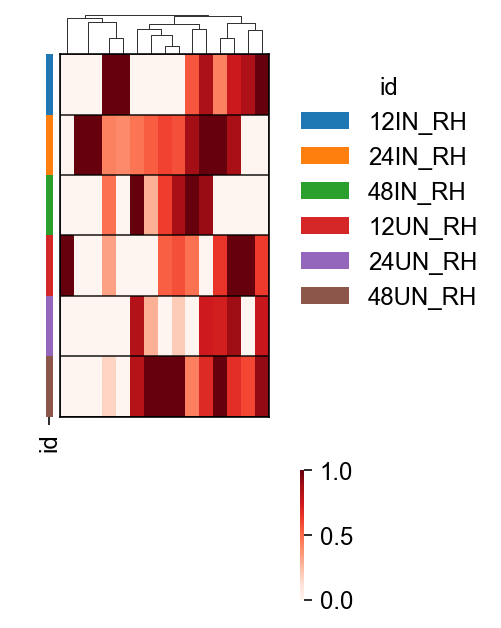

In [ ]:
singleCellTools.plotting.clustermap(
    ad_rh,
    {"a": [x for x in ls_c12_0ClusterGenes if x in ad_rh.var.index]},
    obsAnno="id",
    layer="X",
    add_gene_name=False,
    col_cluster=True,
    dendrogram_ratio=0.1, standard_scale =1,
    figsize=(3, 5),
)

# genome mapping ratio

In [ ]:
dir_resultWithRhizobium = "/public/home/liuzj/projects/singleCell/soybean/02_result/20220916_rhizobium_and_soybean_cellranger/step1_cellRanger/"
ls_sample = ['nodule_large', 'nodule_small', 'root']

In [ ]:
ls_cellrangerH5 = [f"{dir_resultWithRhizobium}/{x}/{x}/outs/raw_feature_bc_matrix.h5" for x in ls_sample]
ls_ad = [sc.read_10x_h5(x) for x in ls_cellrangerH5]
ad_rhi = sc.concat(ls_ad, label='batch', keys=ls_sample, index_unique='-batch-')

In [ ]:
ad_rhi = ad_rhi[ad.obs.index]

In [ ]:
ad_rhi.var['specie'] = ad_rhi.var.index.str.split('_').str[0]

/tmp/ipykernel_214833/901161390.py:1: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_rhi.var['specie'] = ad_rhi.var.index.str.split('_').str[0]


In [ ]:
ad_rhi.obs['Soybean_umis'] = ad_rhi[:, ad_rhi.var['specie'] == 'soybean'].X.sum(1).A1

In [ ]:
ad_rhi.obs['Rhizobium_umis'] = ad_rhi[:, ad_rhi.var['specie'] == 'rhizobium'].X.sum(1).A1

In [ ]:
for batch, _df in ad_rhi.obs.groupby('batch'):
    break

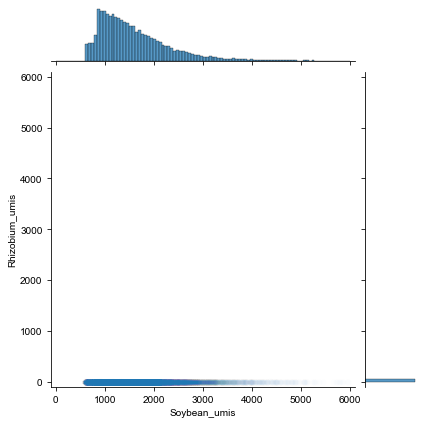

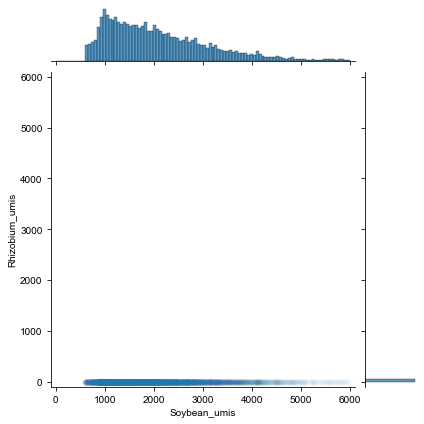

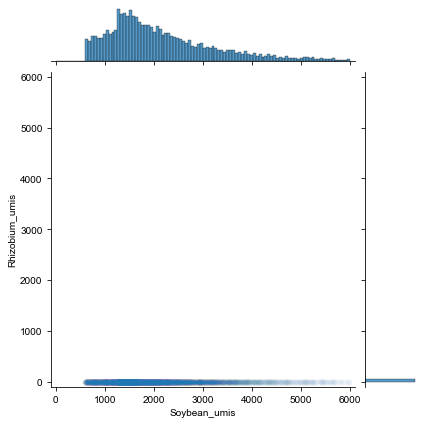

In [ ]:
for batch, _df in ad_rhi.obs.groupby('batch'):

    sns.jointplot(
        data=_df, x='Soybean_umis', y='Rhizobium_umis', xlim=(-100, 6100), ylim=(-100, 6100), 
        marginal_kws=dict(bins=np.linspace(0, 6000, 101)),
        joint_kws=dict(alpha=0.01)
    )
    plt.show()

In [ ]:
def addDensityToDf(df:pd.DataFrame, x:str, y:str, group=None, bins=20):
    from scipy.interpolate import interpn
    from scipy.stats import gaussian_kde

    if group:
        df = df.groupby(group, as_index=False).apply(lambda df: addDensityToDf(df, x=x, y=y, bins=bins)).reset_index(level=0, drop=True)
    elif bins is None:
        x = df[x].values
        y = df[y].values
        xy = np.vstack([x,y])
        z = gaussian_kde(xy)(xy)
        df['temp_density'] = z
        df = df.sort_values('temp_density')
    else:
        x = df[x].values
        y = df[y].values
        data , x_e, y_e = np.histogram2d( x, y, bins = bins, density = True )
        z = interpn( ( 0.5*(x_e[1:] + x_e[:-1]) , 0.5*(y_e[1:]+y_e[:-1]) ) , data , np.vstack([x,y]).T , method = "splinef2d", bounds_error = False)
        z[np.where(np.isnan(z))] = 0.0
        df['temp_density'] = z
        df = df.sort_values('temp_density')
    return df

In [ ]:
df = addDensityToDf(ad_rhi.obs.eval("Soybean_umis = Soybean_umis \n Rhizobium_umis = Rhizobium_umis"), x='Soybean_umis', y='Rhizobium_umis', group='batch', bins=None)
_dt = {'nodule_large': "Nodule (21 dpi)", "nodule_small": "Nodule (7 dpi)", "root": "Root"}

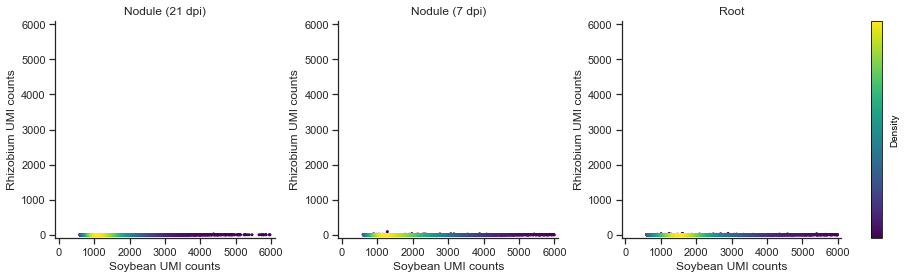

<Figure size 432x288 with 0 Axes>

In [ ]:
fig = plt.Figure(figsize=(12, 4))
ls_subfig = fig.subfigures(1, 4, width_ratios=(1,1,1,0.05))
for (batch, _df), subfig in zip(df.groupby('batch'), ls_subfig):
    (
        so.Plot(_df, x='Soybean_umis', y='Rhizobium_umis', color='temp_density')
        .add(so.Dot(fill=True, edgewidth=0, pointsize=3, alpha=1), legend=False)
        .scale(color='viridis')
        # .scale(y='log', x='log', color='viridis')
        .limit(x=(-100,6100), y=(-100,6100))
        .layout(size=(5,4))
        .label(title=_dt[batch], x='Soybean UMI counts', y='Rhizobium UMI counts')
        .theme(dt_snsStyle)
        .on(subfig).plot()
    )

from matplotlib.colors import Normalize
from matplotlib import cm

ax = ls_subfig[-1].add_subplot(111)
norm = Normalize(vmin = np.min(_df['temp_density']), vmax = np.max(_df['temp_density']))
cbar = ls_subfig[-1].colorbar(cm.ScalarMappable(norm = norm), cax=ax)
cbar.set_ticks([])
cbar.ax.set_ylabel('Density')
plt.tight_layout()
fig

# merge nodule and root steles

In [ ]:
df_araMarker = pd.read_table("/data/Zhaijx/liuzj/projects/singleCell/soybean/01_data/benfey.marker.csv")
df_araMarkerNoStage = pd.read_table("/data/Zhaijx/liuzj/projects/singleCell/soybean/01_data/benfey.marker.without.stage.csv")

dt_arab2soybean = pd.read_table(
    "/public/home/liuzj/data/ortholog/plant/parsed/1v1/arab__v__soybase_2.1v1.tsv"
).set_index("arab")["soybase_2"].to_dict()

In [ ]:
dt_araMarkerOth = (
    df_araMarker.eval("soybean_gene = gene.map(@dt_arab2soybean)").query("soybean_gene in @ad.var.index")
    .dropna(subset=["soybean_gene"]).groupby('cell type + dev stage group')['soybean_gene']
    .apply(lambda x: x.tolist()).to_dict()
)

In [ ]:
dt_araMarkerOthNoStage = (
    df_araMarkerNoStage.eval("soybean_gene = gene.map(@dt_arab2soybean)").query("soybean_gene in @ad.var.index")
    .dropna(subset=["soybean_gene"]).groupby('cell type group')['soybean_gene']
    .apply(lambda x: x.tolist()).to_dict()
)

In [ ]:
singleCellTools.geneEnrichInfo.getAUCellScore(ad, dt_araMarkerOthNoStage, layer='raw', threads=12, label='araMarkerOrthlogNoStage_auc')

Create regulons from a dataframe of enriched features.
Additional columns saved: []


In [ ]:
singleCellTools.geneEnrichInfo.getAUCellScore(ad, dt_araMarkerOth, layer='raw', threads=12, label='araMarkerOrthlog_auc')

Create regulons from a dataframe of enriched features.
Additional columns saved: []


In [ ]:
_ad = singleCellTools.plotting.obsmToObs(ad, 'araMarkerOrthlog_auc')
sc.pl.umap(_ad, color=_ad.uns['plot_obsm'], cmap='Reds')

In [ ]:
ad_stele = ad[ad.obs.eval("Cluster in ['3', '9']")]

In [ ]:
_ad = singleCellTools.plotting.obsmToObs(ad_stele, 'araMarkerOrthlog_auc')
sc.pl.umap(_ad, color=_ad.uns['plot_obsm'], cmap='Reds', ncols=6)

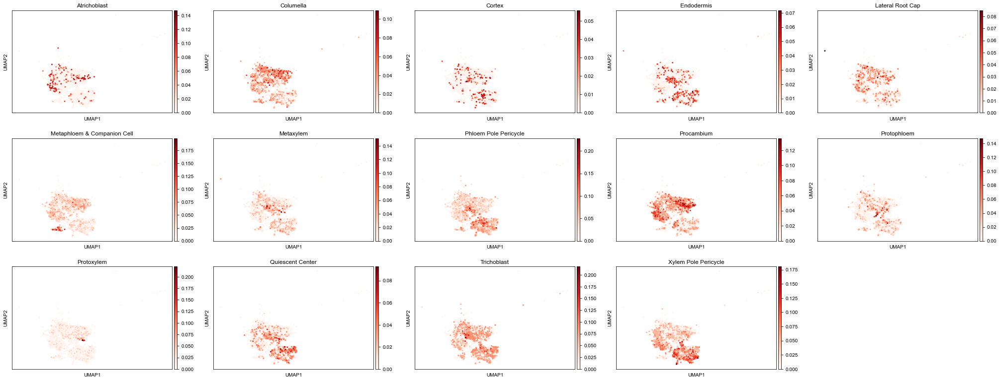

In [ ]:
_ad = singleCellTools.plotting.obsmToObs(ad_stele, 'araMarkerOrthlogNoStage_auc')
sc.pl.umap(_ad, color=_ad.uns['plot_obsm'], cmap='Reds', ncols=5)

# scANVI

In [ ]:
import scvi

In [ ]:
ad_ara = sc.read_h5ad('/data/Zhaijx/qinyw/data/flsnRNA/GSE152766_Root/GSE152766_Root_Atlas.h5ad')

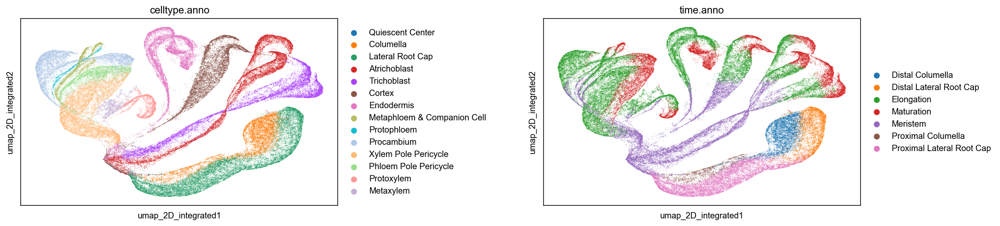

In [ ]:
sc.pl.embedding(ad_ara, 'umap_2D_integrated', color=['celltype.anno', 'time.anno'], wspace=0.5)

In [ ]:
singleCellTools.basic.initLayer(ad_ara, layer='RNA_counts')

In [ ]:
ad_ara = ad_ara[:, ad_ara.var.index.isin(list(dt_arab2soybean.keys()))]
ad_ara.var.index = ad_ara.var.index.map(dt_arab2soybean)
ad_ara.obs['specie'] = 'arabidopsis'

In [ ]:
ad_araSteleMature = ad_ara[ad_ara.obs.eval(
    "`celltype.anno` in ['Metaphloem & Companion Cell', 'Protophloem', 'Procambium', 'Xylem Pole Pericycle', 'Phloem Pole Pericycle', 'Protoxylem', 'Metaxylem'] & `time.anno` in ['Maturation']"
    )]

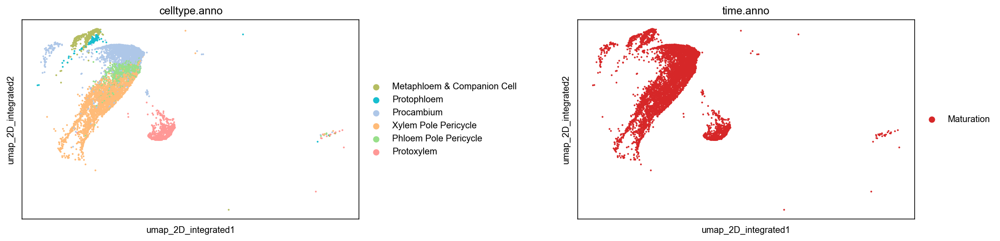

In [ ]:
sc.pl.embedding(ad_araSteleMature, 'umap_2D_integrated', color=['celltype.anno', 'time.anno'], wspace=0.5)

In [ ]:
toPkl(ad_stele, 'ad_stele', 'scem')
toPkl(ad_araSteleMature, 'ad_araSteleMature', 'scem')

2022-11-02 19:44:36.388 | INFO     | jpy_tools.otherTools:toPkl:477 - please run `loadPkl('ad_stele', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object
2022-11-02 19:45:23.698 | INFO     | jpy_tools.otherTools:toPkl:477 - please run `loadPkl('ad_araSteleMature', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


0
0


In [ ]:
# On SCEM

# ad_araSteleMature = loadPkl('ad_araSteleMature', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')
# ad_stele = loadPkl('ad_stele', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')
# ad_araSteleMature.obs['batch'] = 'root'
# ad_stele.obs['orig.ident'] = 'soybean_' + ad_stele.obs['batch'].astype(str)
# ad_stele.obs['specie'] = 'soybean'

# ad_steleScanviMerged = singleCellTools.annotation.labelTransferByScanvi(
#     ad_araSteleMature, 'celltype.anno', 'raw', ad_stele, 'raw', ls_removeCateKey=["orig.ident", "specie", "batch"], mode="merge", 
#     batch_size_ref=2**8,
#     batch_size_query=2**8,
#     dt_params2SCVIModel = {'n_layers': 5},
#     dt_params2SCANVIModel = {'n_layers':5},
#     n_top_genes=3000, needLoc=True,
#     hvgBatch='specie')

# toPkl(ad_steleScanviMerged, 'ad_steleScanviMerged', 'ipf')
# toPkl(ad_stele, 'ad_stele', 'ipf')

In [ ]:
ad_steleScanviMerged = loadPkl('ad_steleScanviMerged', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')
ad_stele = loadPkl('ad_stele', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')

In [ ]:
_ls_order =  [ 'Procambium', 'Protophloem', 'Protoxylem', 'Metaphloem & companion cell', 'Phloem pole pericycle','Xylem pole pericycle', 'Unknown']

In [ ]:
ad_stele.obs['labelTransfer_scanvi_celltype.anno'] = ad_stele.obs['labelTransfer_scanvi_celltype.anno'].str.capitalize().astype('category').cat.set_categories(_ls_order)
ad_steleScanviMerged.obs['labelTransfer_scanvi_celltype.anno'] = ad_steleScanviMerged.obs['labelTransfer_scanvi_celltype.anno'].str.capitalize().astype('category').cat.set_categories(_ls_order)

In [ ]:
def replaceSteleLabel(line):
    if line.name in ad_stele.obs.index:
        return ad_stele.obs.loc[line.name, 'labelTransfer_scanvi_celltype.anno']
    else:
        return line.loc['labelTransfer_scanvi_celltype.anno']
ad_steleScanviMerged.obs['labelTransfer_scanvi_celltype.anno'] = ad_steleScanviMerged.obs.apply(replaceSteleLabel, axis=1).astype('category').cat.set_categories(_ls_order)

In [ ]:
ad_steleScanviMerged.uns['labelTransfer_scanvi_celltype.anno_colors'][-1] = '#7F7F7F'

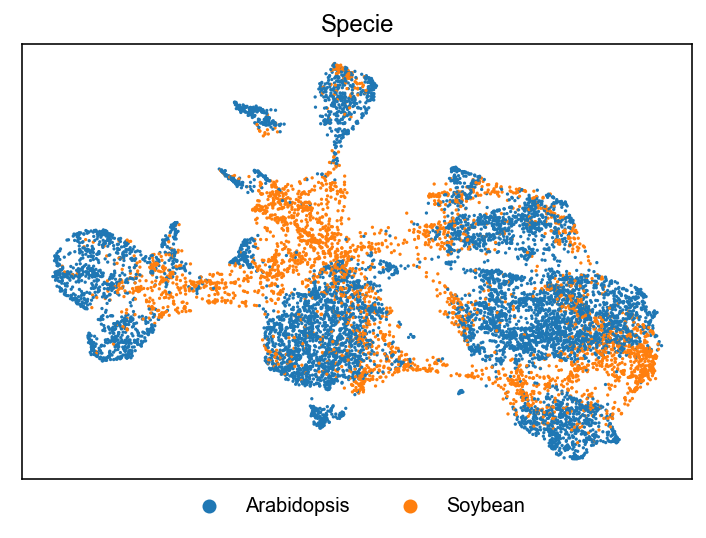

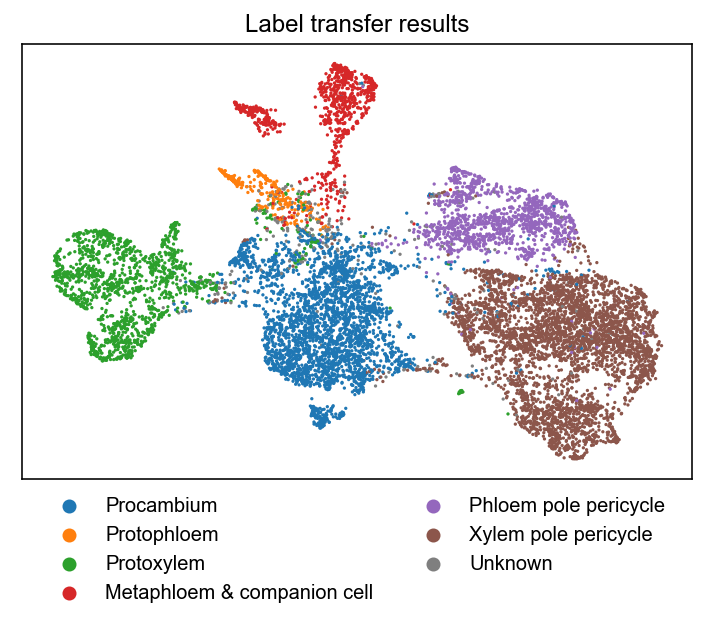

In [ ]:
ax = sc.pl.umap(ad_steleScanviMerged, color='specie', show=False, title='Specie')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, ['Arabidopsis', 'Soybean'], loc='upper center', bbox_to_anchor=(0.5, 0), frameon=False, ncol=2)
plt.xlabel('')
plt.ylabel('')
plt.show()

ax = sc.pl.umap(ad_steleScanviMerged, color='labelTransfer_scanvi_celltype.anno', show=False, title='Label transfer results')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, 0), frameon=False, ncol=2)
plt.xlabel('')
plt.ylabel('')
plt.show()


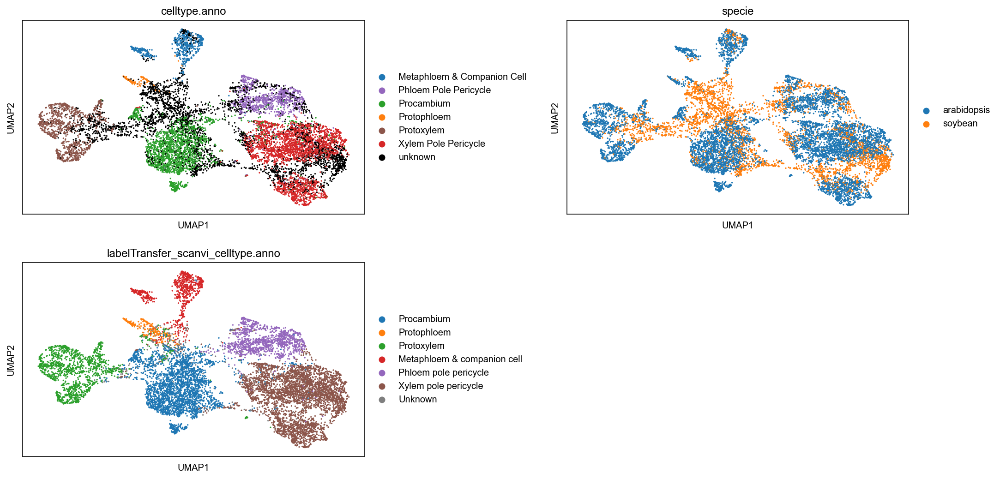

In [ ]:
sc.pl.umap(ad_steleScanviMerged, color=['celltype.anno', 'specie', 'labelTransfer_scanvi_celltype.anno'], wspace=0.45, ncols=2)

In [ ]:
ad_stele.uns['labelTransfer_scanvi_celltype.anno_colors'] =  ad_steleScanviMerged.uns['labelTransfer_scanvi_celltype.anno_colors']

In [ ]:
ad_stele.obsm['X_scANVI'] = ad_steleScanviMerged[ad_stele.obs.index].obsm['X_scANVI']
sc.pp.neighbors(ad_stele, 5, use_rep='X_scANVI')
sc.tl.umap(ad_stele, 0.3)


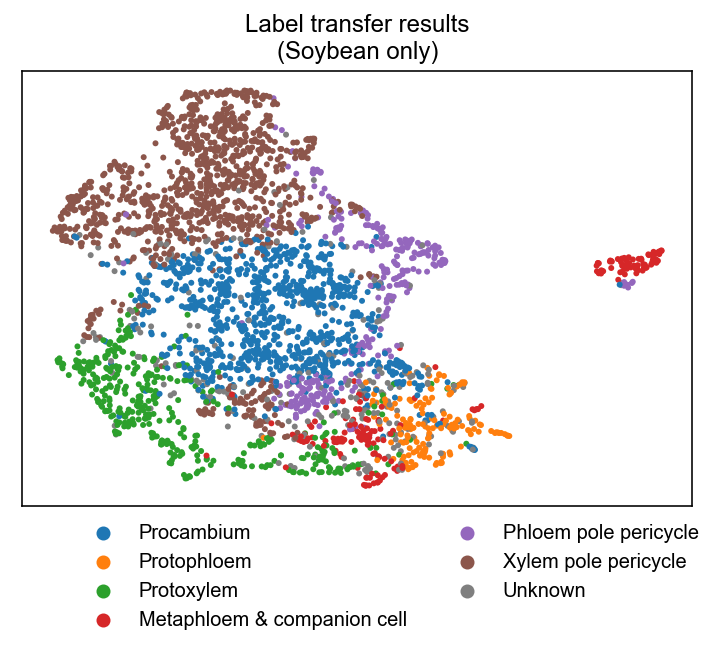

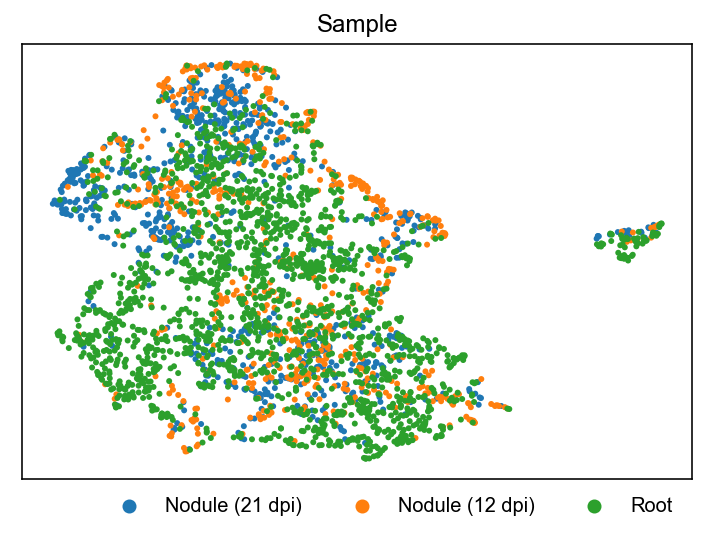

In [ ]:
ax = sc.pl.umap(ad_stele, color='labelTransfer_scanvi_celltype.anno', show=False, title="Label transfer results\n(Soybean only)")
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.55, 0), frameon=False, ncol=2)
plt.xlabel('')
plt.ylabel('')
plt.show()

ax = sc.pl.umap(ad_stele, color='Sample_time', show=False, title='Sample')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.55, 0), frameon=False, ncol=3)
plt.xlabel('')
plt.ylabel('')
plt.show()


In [ ]:
sc.tl.leiden(ad_stele, 0.2)

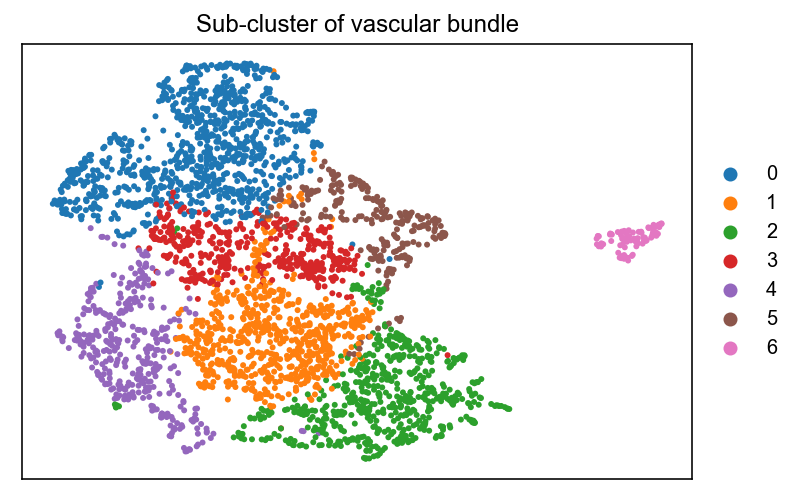

In [ ]:
sc.pl.umap(ad_stele, color='leiden', title="Sub-cluster of vascular bundle", show=False)
plt.xlabel('')
plt.ylabel('')
plt.show()

In [ ]:
import matplotlib.legend as mlegend

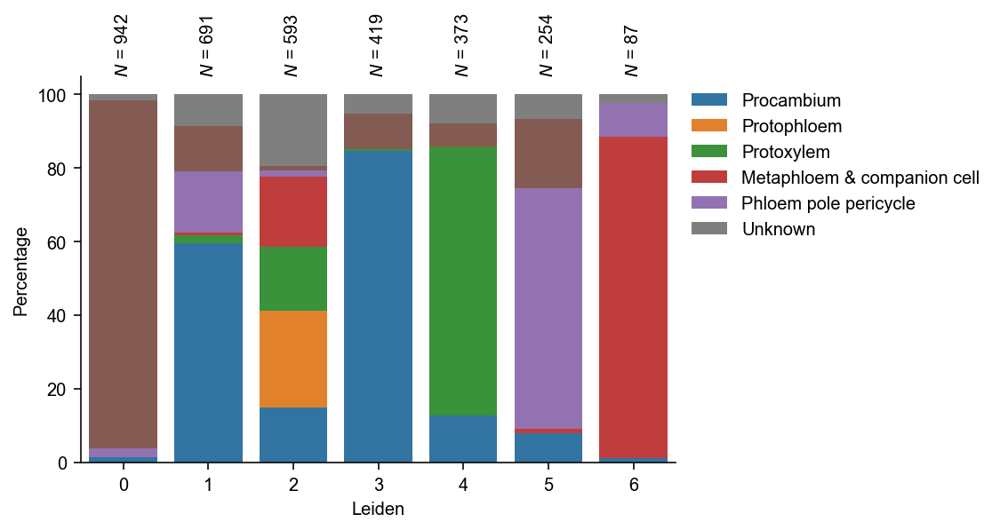

In [ ]:
singleCellTools.plotting.plotLabelPercentageInCluster(ad_stele, 'leiden', 'labelTransfer_scanvi_celltype.anno')
ax = plt.gca()
# remove Metaxylem due to the empty percentage and not present in mature roots
leg = ax.get_legend()
ls_handles = mlegend._get_legend_handles([ax]) >> F(list)
ls_labels = leg.get_texts() >> F(map, lambda x:x.get_text()) >> F(list)
ls_handles = ls_handles[-len(ls_labels):][::-1]
ls_handles.pop(5)
ls_labels.pop(5)
plt.legend(ls_handles, ls_labels, loc='upper left', bbox_to_anchor=(1, 1), frameon=False)
plt.show()

In [ ]:
ad_stele.obsm['araMarkerOrthlogNoStage_auc'].columns = ad_stele.obsm['araMarkerOrthlogNoStage_auc'].columns >> F(map, str.lower) >> F(map, str.capitalize) >> F(list)

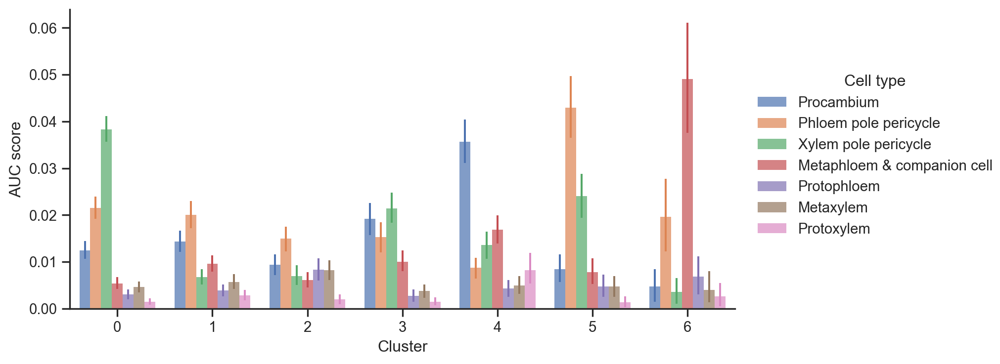

In [ ]:
(
    so.Plot(_df,  x='leiden', y='AUC score', color='Cell type')
    .add(so.Bar(edgewidth=0), so.Agg(), so.Dodge())
    .add(so.Range(), so.Est(errorbar=('ci', 99)), so.Dodge(), legend=False)
    .theme(dt_snsStyle)
    .label(x='Cluster')
    .layout(size=(8,4))
    .scale(color='deep')
)

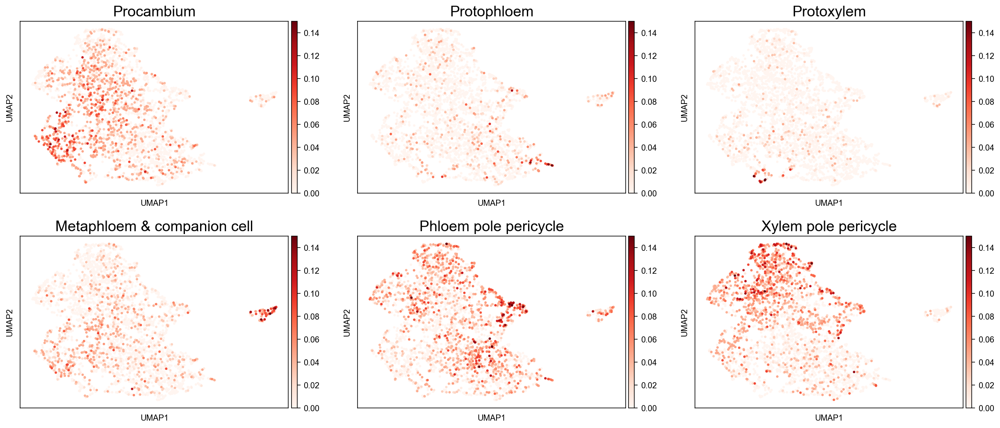

In [ ]:
_ad = singleCellTools.plotting.obsmToObs(ad_stele, 'araMarkerOrthlogNoStage_auc')
axs = sc.pl.umap(_ad, color=_ls_order[:-1], cmap='Reds', ncols=3, vmax=0.15, show=False)
for ax in axs:
    plt.sca(ax)
    plt.title(ax.get_title(), fontdict=dict(fontsize=18))

In [ ]:
dt_annoStele = {
    0:'Xylem pole pericycle', 1 : "Stele (Unknown)", 2: "Stele (Unknown, phloem like)", 3: "Stele (Unknown)", 4:"Stele (Unknown, xylem like)", 
    5: "Phloem pole pericycle", 6: "Metaphloem & companion cell"
}
dt_annoStele = {str(x): f"vb-{x}: {y}" for x,y in dt_annoStele.items()}

In [ ]:
ad_stele.obs['vb_ct'] = ad_stele.obs['leiden'].map(dt_annoStele)

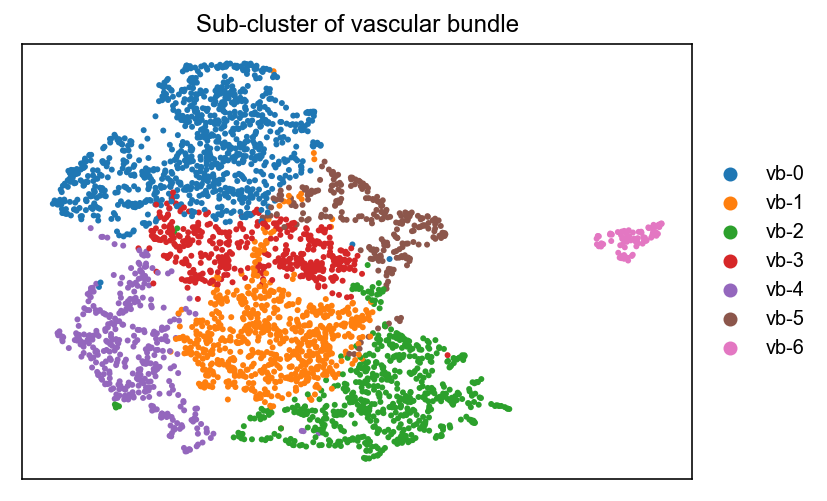

In [ ]:
ax = sc.pl.umap(ad_stele, color='leiden', wspace=0.2, show=False, title='Sub-cluster of vascular bundle')
handle, labels = ax.get_legend_handles_labels()
labels = [f"vb-{x}" for x in labels]
plt.xlabel('')
plt.ylabel('')
ax.legend(handle, labels, loc='center left', bbox_to_anchor=(1, 0.5), frameon=False, ncol=1)

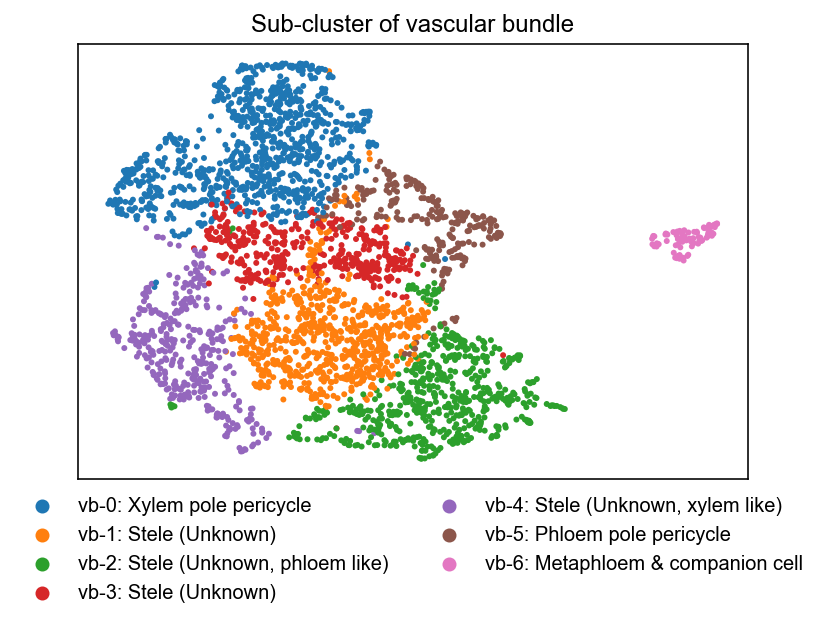

In [ ]:
ax = sc.pl.umap(ad_stele, color='vb_ct', wspace=0.2, show=False, title='Sub-cluster of vascular bundle')
handle, labels = ax.get_legend_handles_labels()
labels = [f"{x}" for x in labels]
plt.xlabel('')
plt.ylabel('')
ax.legend(handle, labels, loc='upper center', bbox_to_anchor=(0.5, 0), frameon=False, ncol=2)

In [ ]:
ad.obs['vb_ct'] = ad.obs['Cell type'].copy().astype(str)
ad.obs.loc[ad_stele.obs.index, 'vb_ct'] = ad_stele.obs['vb_ct'].astype(str)
ad.obs['vb_ct'] = ad.obs['vb_ct'].astype('category')

In [ ]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad, 'raw', 'vb_ct')

In [ ]:
df_steleSpecGeneAllCluster = ad.uns['vb_ct_cellexES'].query(
    "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2 & vb_ct.str.startswith('vb')"
)

In [ ]:
dt_steleSpecGeneAllCluster = df_steleSpecGeneAllCluster.groupby('vb_ct').apply(lambda df:df.nlargest(5, 'enrichScore')["gene"].to_list()).to_dict()

In [ ]:
ls_vbctOrder = [
    "0: Uninfected cells*",
    "1: Inner cortex",
    "2: Outer cortex*",
    "4: Outer cortex*",
    "5: Epidermis",
    "6: Unknown",
    "7: Uninfected cells*",
    "8: Endodermis",
    "10: Unknown",
    "11: Uninfected cells*",
    "12: Infected cells",
    "13: Unknown",
    "14: Unknown",
    "vb-0: Xylem pole pericycle",
    "vb-1: Stele (Unknown)",
    "vb-2: Stele (Unknown, phloem like)",
    "vb-3: Stele (Unknown)",
    "vb-4: Stele (Unknown, xylem like)",
    "vb-5: Phloem pole pericycle",
    "vb-6: Metaphloem & companion cell",
]
ad.obs['vb_ct'] = ad.obs['vb_ct'].cat.set_categories(ls_vbctOrder)

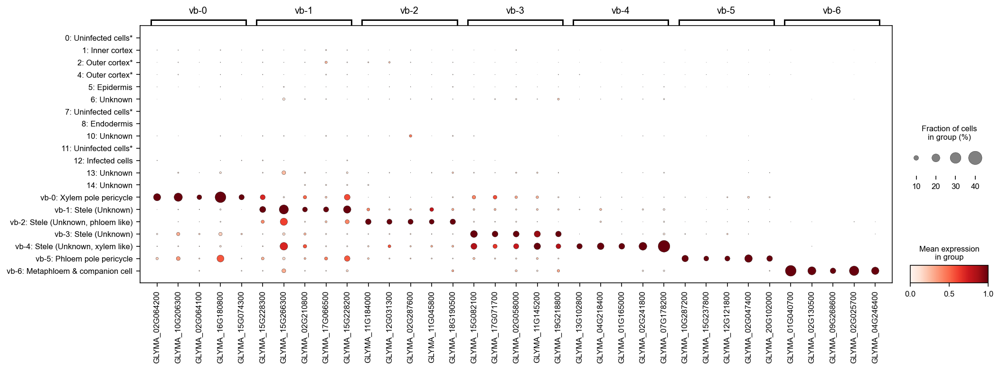

In [ ]:
sc.pl.dotplot(
    ad,
    {x.split(':')[0]: y for x, y in dt_steleSpecGeneAllCluster.items() if y if x.startswith('vb')},
    "vb_ct",
    layer="normalize_log",
    cmap="Reds",
    standard_scale='var',
    dot_max=0.4,
    figsize=(16, 5)
)

In [ ]:
df_steleSpecGeneAllCluster.to_excel(f"{dir_result}/vascular_bundle.xlsx")

In [ ]:
df_steleSpecGeneAllCluster.merge(df_symbol, how="left", left_on="gene", right_index=True).eval(
    "Symbol = Symbol.fillna('') \n other_designations = other_designations.fillna('')",
    engine="python",
).to_excel(f"{dir_result}/stele_spec_genes.xlsx")

# load gene dup list

In [ ]:
import glob
import re

In [ ]:
lsDf_geneDup = []
for f in glob.glob(f"/public/home/liuzj/projects/singleCell/soybean/01_data/pdgd/*.pairs"):
    df = pd.read_table(f, sep='\t')
    df['Category'] = re.search(r'Gma.(\w+).pairs', f).group(1)
    lsDf_geneDup.append(df)

In [ ]:
df_geneDup = pd.concat(lsDf_geneDup)

In [ ]:
df_geneDup.loc[lambda df:df['Category'] == 'transposed', 'Duplicate 1'] = df_geneDup.loc[lambda df:df['Category'] == 'transposed', 'Transposed']
df_geneDup.loc[lambda df:df['Category'] == 'transposed', 'Duplicate 2'] = df_geneDup.loc[lambda df:df['Category'] == 'transposed', 'Parental']

In [ ]:
df_geneDup['Gene 1'] = df_geneDup['Duplicate 1'].str.replace("Glyma.", "GLYMA_").str.split('.').str[0]
df_geneDup['Gene 2'] = df_geneDup['Duplicate 2'].str.replace("Glyma.", "GLYMA_").str.split('.').str[0]

In [ ]:
df_geneDup = df_geneDup.loc[lambda df: df.eval("`Gene 1` in @ad.var.index & `Gene 2` in @ad.var.index")]

In [ ]:
_ls = ['GLYMA_08G071200', 'GLYMA_13G043800']
df_geneDup.query("`Gene 1` in @_ls | `Gene 2` in @_ls")

,Duplicate 1,Location,Duplicate 2,Location.1,E-value,Category,Transposed,Parental,Gene 1,Gene 2
14311,Glyma.08G071200.1,Gma-Chr08:5438763,Glyma.13G043800.1,Gma-Chr13:13707907,0.0,dispersed,NaN,NaN,GLYMA_08G071200,GLYMA_13G043800


# Correlation

In [ ]:
ad_merged = singleCellTools.geneEnrichInfo._mergeData(ad, 'Cluster', layer='raw')

In [ ]:
singleCellTools.basic.initLayer(ad_merged, total=1e6)

In [ ]:
from scipy import stats

In [ ]:
def getSpearmanR(sr, ad, layer, gene2='Gene 2'):
    gene1 = sr.at['Gene 1']
    gene2 = sr.at[gene2]
    return stats.spearmanr(ad[:, gene1].layers[layer].reshape(-1), ad[:, gene2].layers[layer].reshape(-1))[0]

In [ ]:
df_geneDup['Gene Shuffle'] = df_geneDup['Gene 2'].sample(frac=1, random_state=39).values

In [ ]:
df_geneDup["SpearmanR"] = df_geneDup.apply(getSpearmanR, axis=1, ad=ad_merged, layer='normalize_log', gene2='Gene 2')

In [ ]:
df_geneDup["SpearmanR_Shuffle"] = df_geneDup.apply(getSpearmanR, axis=1, ad=ad_merged, layer='normalize_log', gene2='Gene Shuffle')

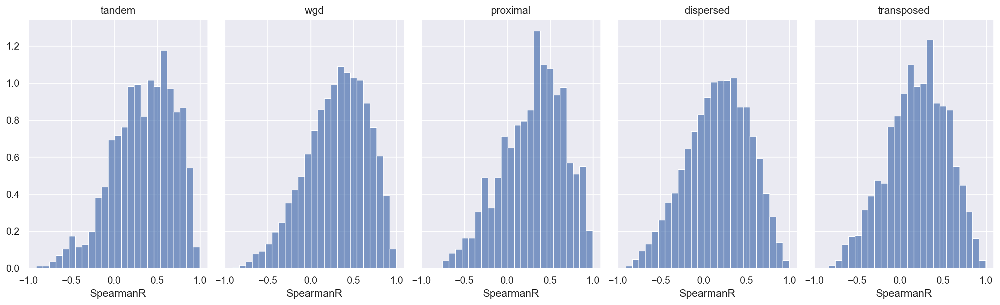

In [ ]:
(
    so.Plot(df_geneDup, x='SpearmanR')
    .facet(col='Category')
    .add(so.Bars(), so.Hist(stat='density', bins=25))
    .layout(size=(16,5))
)

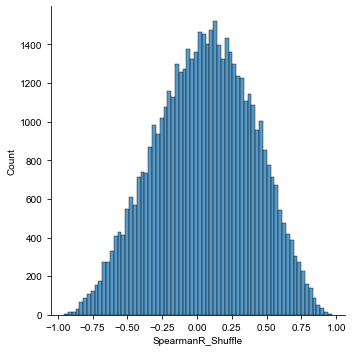

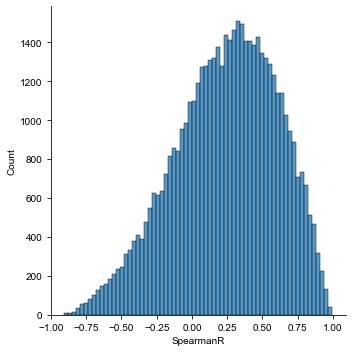

In [ ]:
sns.displot(df_geneDup['SpearmanR_Shuffle'])
sns.displot(df_geneDup['SpearmanR'])

## only 1-1 paralog

In [ ]:
import tqdm

In [ ]:
ls_paralogGroup = []

In [ ]:
df_geneDup = df_geneDup.drop_duplicates(['Gene 1', 'Gene 2'])

In [ ]:
ls_onePairOrth = pd.concat([df_geneDup['Gene 1'], df_geneDup['Gene 2']]).sort_values().value_counts().loc[lambda sr:sr == 1].index.to_list()

In [ ]:
df_paralog1v1Only = df_geneDup.query("`Gene 1` in @ls_onePairOrth & `Gene 2` in @ls_onePairOrth")[['Gene 1', 'Gene 2']].rename(columns={'Gene 1': 'G1', 'Gene 2': 'G2'})

In [ ]:
def getSpearmanR(sr, ad, layer, gene2='Gene 2'):
    gene1 = sr.at['G1']
    gene2 = sr.at[gene2]
    return stats.spearmanr(ad[:, gene1].layers[layer].reshape(-1), ad[:, gene2].layers[layer].reshape(-1))[0]

In [ ]:
df_paralog1v1Only["SpearmanR"] = df_paralog1v1Only.apply(getSpearmanR, axis=1, ad=ad_merged, layer='normalize_log', gene2='G2')

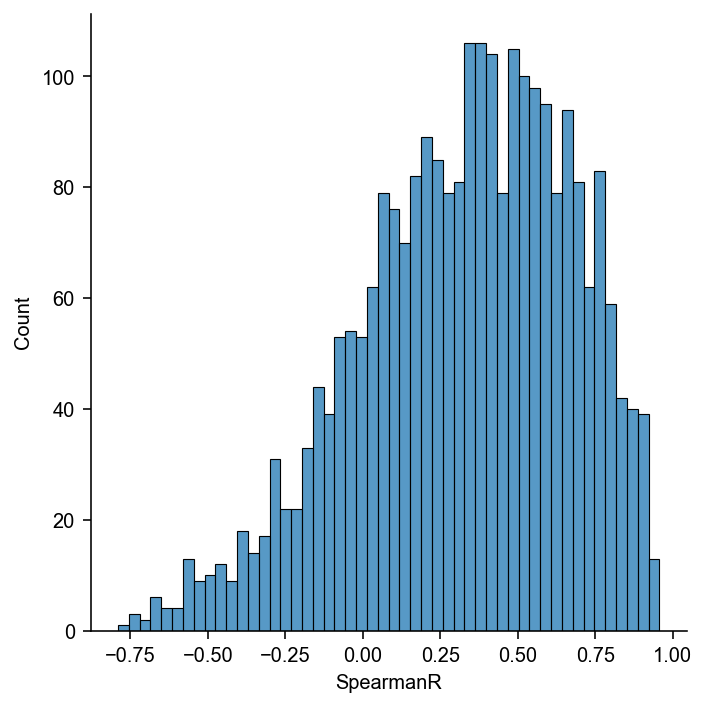

In [ ]:
sns.displot(df_paralog1v1Only['SpearmanR'], bins=50)

### compare with shuffled

In [ ]:
df_paralog1v1Only['Gene Shuffle'] = df_paralog1v1Only['G2'].sample(frac=1, random_state=39, replace=True).values

In [ ]:
df_paralog1v1Only["SpearmanR_shuffle"] = df_paralog1v1Only.apply(getSpearmanR, axis=1, ad=ad_merged, layer='normalize_log', gene2='Gene Shuffle')

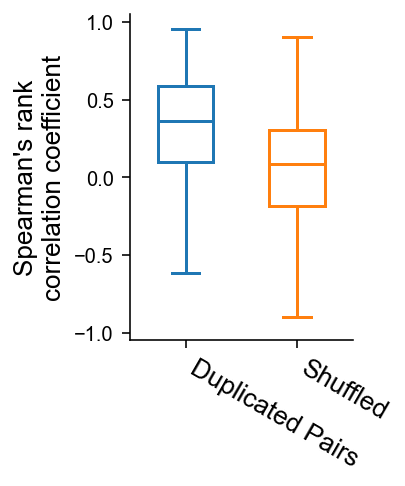

In [ ]:
import matplotlib as mpl
fig, ax = plt.subplots(figsize=(2,3))
ax = sns.boxplot(data = df_paralog1v1Only[['SpearmanR', 'SpearmanR_shuffle']].melt(), x='variable', y='value', ax=ax, fliersize=0, width=0.5)

for i, (box, color) in enumerate(zip([x for x in ax.get_children() if isinstance(x, mpl.patches.PathPatch)], sns.color_palette())):
    box.set_edgecolor(color)
    box.set_facecolor("white")
    # iterate over whiskers and median lines
    for j in range(6 * i, 6 * (i + 1)):
        ax.lines[j].set_color(color)
sns.despine()
plt.ylabel("Spearman's rank\ncorrelation coefficient", fontsize=13)
plt.xticks([0,1], ['Duplicated Pairs', 'Shuffled'], rotation=-30, ha='left', fontsize=13)
plt.xlabel('')

plt.show()

In [ ]:
import scipy.stats

In [ ]:
scipy.stats.ttest_ind(df_paralog1v1Only['SpearmanR'], df_paralog1v1Only['SpearmanR_shuffle']).pvalue

6.748250002626319e-150

### get p value (boot strap)

In [ ]:
from joblib import Parallel, delayed

In [ ]:
singleCellTools.geneEnrichInfo.getBgGene(ad, df_paralog1v1Only['G2'].to_list())

['GLYMA_16G180100',
 'GLYMA_03G029100',
 'GLYMA_15G276900',
 'GLYMA_08G286300',
 'GLYMA_08G204900',
 'GLYMA_01G044000',
 'GLYMA_10G046100',
 'GLYMA_18G226700',
 'GLYMA_02G082500',
 'GLYMA_01G184900',
 'ENSRNA050001470',
 'GLYMA_05G211000',
 'GLYMA_09G146000',
 'GLYMA_13G198100',
 'GLYMA_11G048800',
 'GLYMA_14G156800',
 'GLYMA_02G239000',
 'GLYMA_01G245000',
 'GLYMA_13G355700',
 'GLYMA_12G063300',
 'GLYMA_16G131700',
 'GLYMA_15G073800',
 'GLYMA_15G125600',
 'GLYMA_07G096300',
 'GLYMA_05G069300',
 'GLYMA_01G152200',
 'GLYMA_16G209700',
 'GLYMA_06G092600',
 'GLYMA_03G193200',
 'GLYMA_07G250300',
 'GLYMA_13G277300',
 'GLYMA_13G152800',
 'GLYMA_17G214500',
 'GLYMA_03G054100',
 'GLYMA_16G158800',
 'GLYMA_08G291200',
 'GLYMA_08G215900',
 'GLYMA_01G123100',
 'GLYMA_10G001800',
 'GLYMA_19G045900',
 'GLYMA_02G121800',
 'GLYMA_01G224500',
 'GLYMA_04G045200',
 'GLYMA_05G155900',
 'GLYMA_09G183000',
 'GLYMA_13G213500',
 'GLYMA_11G065300',
 'GLYMA_15G110400',
 'GLYMA_02G297100',
 'GLYMA_02G013900',


In [ ]:
for i in tqdm.tqdm(range(1000)):
    df_paralog1v1Only[f"seed_{i}_bg"] = singleCellTools.geneEnrichInfo.getBgGene(ad, df_paralog1v1Only['G2'].to_list(), seed=i, usePreBin='bins_ForPickMock')

100%|██████████| 1000/1000 [02:00<00:00,  8.33it/s]


In [ ]:
def getBootstrapPearson(df:pd.DataFrame, ad):
    ls_result = []
    for nt in df.itertuples():
        ls_oneLineResult = []
        g1 = nt.G1
        for i in range(1000):
            g2 = getattr(nt, f"seed_{i}_bg")
            g2_corr = stats.spearmanr(ad[:, g1].layers['normalize_log'].reshape(-1), ad[:, g2].layers['normalize_log'].reshape(-1))[0]
            ls_oneLineResult.append(g2_corr)
        ls_result.append(ls_oneLineResult)
    df_result = pd.DataFrame(ls_result, columns=[f"seed_{i}_corr" for i in range(1000)], index=df.index)
    df_result = pd.concat([df, df_result], axis=1)
    return df_result

In [ ]:
df_paralog1v1Only['joblib_group'] = np.random.random_integers(0, 63, size=len(df_paralog1v1Only))

In [ ]:
_lsDf = Parallel(64)(delayed(getBootstrapPearson)(x[1], ad_merged) for x in df_paralog1v1Only.groupby('joblib_group'))

In [ ]:
df_paralogBootstrapResult = pd.concat(_lsDf)

In [ ]:
df_paralogBootstrapResult = df_paralogBootstrapResult.reset_index(drop=True)

In [ ]:
df_paralogBootstrapResult['G2_rank'] = df_paralogBootstrapResult[['SpearmanR']].join(df_paralogBootstrapResult.filter(regex=r"seed_\d+_corr")).rank(1, method='first', ascending=False)['SpearmanR']

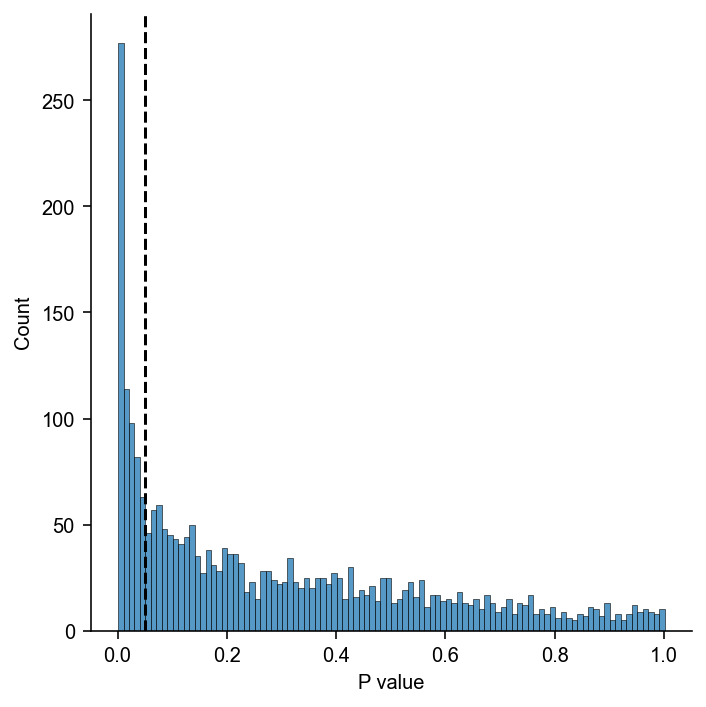

In [ ]:
sns.displot(df_paralogBootstrapResult['G2_rank'] / 1000, bins=100)
plt.xlabel('P value')
plt.axvline(x=0.05, ls='--', color='black')
plt.show()

In [ ]:
df_paralogBootstrapResult['G2_rank'] = df_paralogBootstrapResult[['SpearmanR']].join(df_paralogBootstrapResult.filter(regex=r"seed_\d+_corr")).rank(1, method='first', ascending=False)['SpearmanR']

In [ ]:
df_paralogBootstrapResult['p'] = df_paralogBootstrapResult['G2_rank'] / 1000

In [ ]:
df_paralogBootstrapResult.query("p < 0.05") 

,G1,G2,SpearmanR,seed_0_bg,seed_1_bg,seed_2_bg,seed_3_bg,seed_4_bg,seed_5_bg,seed_6_bg,...,seed_992_corr,seed_993_corr,seed_994_corr,seed_995_corr,seed_996_corr,seed_997_corr,seed_998_corr,seed_999_corr,G2_rank,p
3,GLYMA_02G186700,GLYMA_10G106900,0.896429,GLYMA_11G192600,GLYMA_03G250200,GLYMA_09G261700,GLYMA_09G263200,GLYMA_15G106400,GLYMA_13G053700,GLYMA_08G359500,...,-0.150585,0.472805,-0.247133,-0.435798,-0.016116,-0.760452,0.636220,0.229129,1.0,0.001
5,GLYMA_02G284400,GLYMA_14G030600,0.732143,GLYMA_04G066300,GLYMA_19G039100,GLYMA_19G076800,GLYMA_13G286900,GLYMA_19G156000,GLYMA_20G222800,GLYMA_06G032100,...,0.064517,-0.527949,0.225492,0.005406,0.028204,0.195760,0.141019,-0.265498,1.0,0.001
13,GLYMA_05G148900,GLYMA_08G105600,0.764969,GLYMA_13G358800,GLYMA_06G225100,GLYMA_18G205400,GLYMA_04G156500,GLYMA_09G047300,GLYMA_09G151800,GLYMA_02G106500,...,0.007149,0.417857,-0.003571,0.396429,0.260714,0.167857,-0.175000,0.396429,5.0,0.005
16,GLYMA_07G180000,GLYMA_20G009200,0.750000,GLYMA_02G018200,GLYMA_13G355300,GLYMA_10G055400,GLYMA_08G216200,GLYMA_02G288300,GLYMA_12G147600,GLYMA_05G202500,...,0.260714,-0.514286,0.203571,0.525000,0.328571,0.057143,0.246429,0.632143,23.0,0.023
25,GLYMA_14G081100,GLYMA_17G244300,0.642857,GLYMA_07G196000,GLYMA_03G128600,GLYMA_06G021600,GLYMA_03G236900,GLYMA_04G202900,GLYMA_07G168700,GLYMA_03G180500,...,-0.221429,-0.214286,-0.496429,0.364286,0.346429,-0.157143,0.450000,-0.407143,19.0,0.019
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2534,GLYMA_01G064400,GLYMA_02G122200,0.796429,GLYMA_13G213500,GLYMA_06G175500,GLYMA_20G130000,GLYMA_04G046900,GLYMA_03G239200,GLYMA_11G180900,GLYMA_01G094300,...,0.169589,0.022917,0.495841,-0.410343,-0.123321,-0.178602,-0.537933,-0.412555,1.0,0.001
2541,GLYMA_04G252900,GLYMA_06G109600,0.867857,GLYMA_02G150100,GLYMA_07G145700,GLYMA_18G045400,GLYMA_01G203700,GLYMA_17G261300,GLYMA_15G232400,GLYMA_07G262100,...,0.425000,0.414286,0.525000,0.659518,0.682143,-0.042857,-0.527949,0.659518,2.0,0.002
2552,GLYMA_09G264700,GLYMA_18G227200,0.714286,GLYMA_04G222800,GLYMA_08G155200,GLYMA_18G230800,GLYMA_07G011900,GLYMA_01G207400,GLYMA_10G143600,GLYMA_09G015800,...,-0.307143,-0.135714,-0.246429,-0.185714,-0.089366,-0.578571,0.053571,0.150000,3.0,0.003
2556,GLYMA_13G345800,GLYMA_15G028500,0.771429,GLYMA_19G114000,GLYMA_01G079200,GLYMA_06G082100,GLYMA_15G090300,GLYMA_04G052100,GLYMA_02G090800,GLYMA_13G326200,...,-0.017857,0.564286,0.142857,-0.092857,0.517857,-0.296429,0.750000,0.575000,17.0,0.017


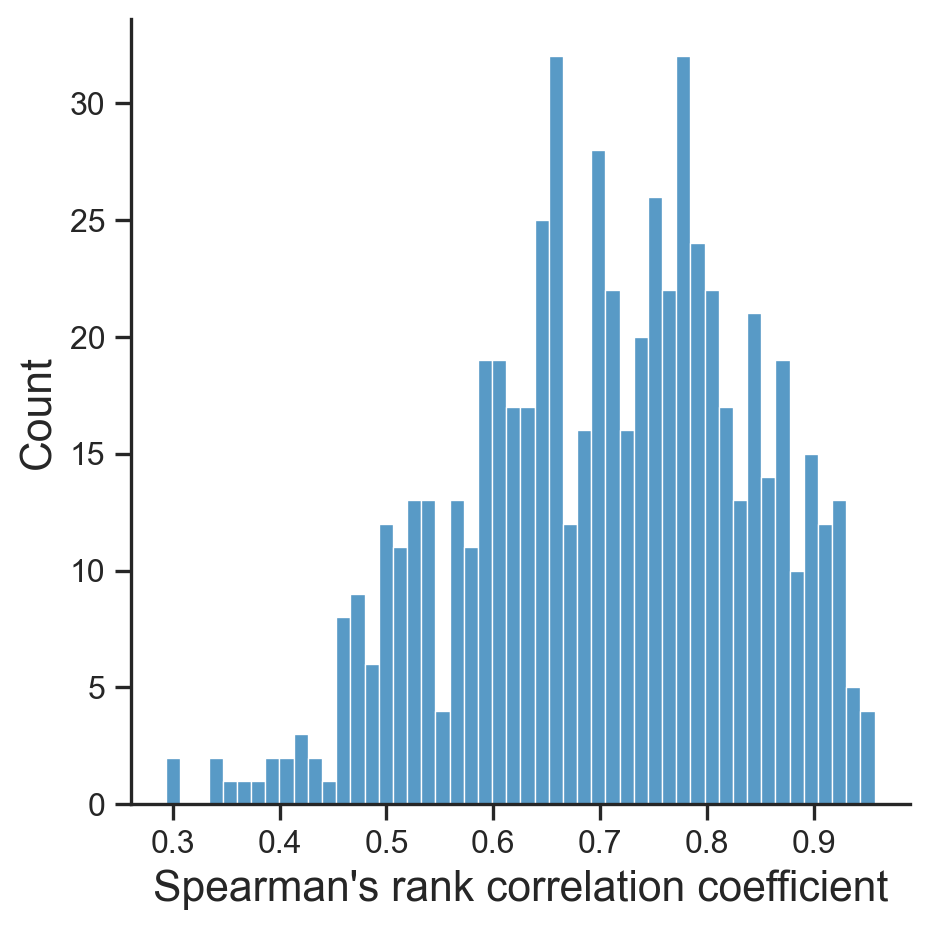

In [ ]:
(
    df_paralogBootstrapResult.query("p < 0.05").pipe(so.Plot, x='SpearmanR')
    .add(so.Bars(color='#116FAF'), so.Hist(bins=50))
    .theme({**dt_snsStyle, 'axes.labelsize': 16, 'xtick.labelsize': 12, 'ytick.labelsize': 12})
    .label(x = "Spearman's rank correlation coefficient", y = "Count")
    .layout(size=(5,5))
)

In [ ]:
ad.uns['gene_dup_corr'] = df_paralogBootstrapResult

# diff

In [ ]:
_lsDf = []
for cluster in ad_merged.obs['Cluster'].unique():
    _df = df_paralog1v1Only[['G1', 'G2', 'Gene Shuffle']]
    _df['G1_expression'] = ad_merged.to_df('normalize_log').loc[cluster, _df['G1']].values
    _df['G2_expression'] = ad_merged.to_df('normalize_log').loc[cluster, _df['G2']].values
    _df['Shuffle_expression'] = ad_merged.to_df('normalize_log').loc[cluster, _df['Gene Shuffle']].values
    _df['Cluster'] = cluster

    _lsDf.append(_df)

In [ ]:
df_1v1OnlyDiff = pd.concat(_lsDf)

In [ ]:
df_1v1OnlyDiff = (
    df_1v1OnlyDiff
    .eval("Diff = G1_expression - G2_expression \n Shuffle_Diff = G1_expression - Shuffle_expression", engine='python')
    .eval("Diff = Diff.abs() \n Shuffle_Diff = Shuffle_Diff.abs()", engine='python')
    .assign(Diff = lambda df:np.exp(df['Diff']), Shuffle_Diff = lambda df:np.exp(df['Shuffle_Diff']))
    .rename(columns={'Diff':'Diff Fc', 'Shuffle_Diff':'Shuffle Fc'})
    .assign(Diff = lambda df:np.abs(np.exp(df['G1_expression']) - np.exp(df['G2_expression'])), Shuffle_Diff =  lambda df:np.abs(np.exp(df['G1_expression']) - np.exp(df['Shuffle_expression'])))
)

In [ ]:
from matplotlib.patches import PathPatch

def adjust_box_widths(g, fac):
    """
    Adjust the withs of a seaborn-generated boxplot.
    """

    # iterating through Axes instances
    for ax in g.axes:

        # iterating through axes artists:
        for c in ax.get_children():

            # searching for PathPatches
            if isinstance(c, PathPatch):
                # getting current width of box:
                p = c.get_path()
                verts = p.vertices
                verts_sub = verts[:-1]
                xmin = np.min(verts_sub[:, 0])
                xmax = np.max(verts_sub[:, 0])
                xmid = 0.5*(xmin+xmax)
                xhalf = 0.5*(xmax - xmin)

                # setting new width of box
                xmin_new = xmid-fac*xhalf
                xmax_new = xmid+fac*xhalf
                verts_sub[verts_sub[:, 0] == xmin, 0] = xmin_new
                verts_sub[verts_sub[:, 0] == xmax, 0] = xmax_new

                # setting new width of median line
                for l in ax.lines:
                    if np.all(l.get_xdata() == [xmin, xmax]):
                        l.set_xdata([xmin_new, xmax_new])

In [ ]:
from itertools import cycle
from matplotlib.patches import Patch
from matplotlib.lines import Line2D

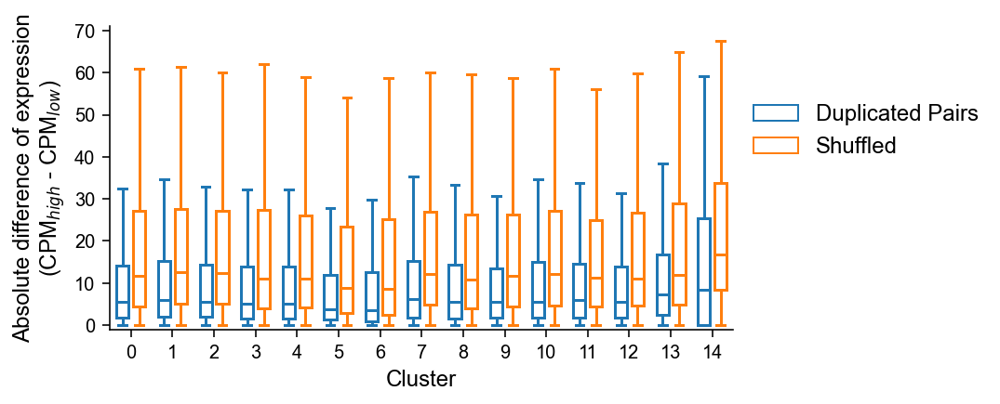

In [ ]:
fig, ax = plt.subplots(figsize=(6,3))
df_1v1OnlyDiff.melt("Cluster", ['Diff', 'Shuffle_Diff'], 'Group', 'Diff').pipe(sns.boxplot, x='Cluster', y='Diff', hue='Group', fliersize=0, ax=ax, )
plt.ylim(-1, 71)

for i, (box, color) in enumerate(zip([x for x in ax.get_children() if isinstance(x, mpl.patches.PathPatch)], cycle(sns.color_palette()[:2]))):
    box.set_edgecolor(color)
    box.set_facecolor("white")
    # iterate over whiskers and median lines
    for j in range(6 * i, 6 * (i + 1)):
        ax.lines[j].set_color(color)

legend_elements = [Patch(facecolor='white', edgecolor=sns.color_palette()[0],
                         label='Duplicated Pairs'), Patch(facecolor='white', edgecolor=sns.color_palette()[1],
                         label='Shuffled')]

plt.legend(handles=legend_elements, loc='lower left', bbox_to_anchor=(1, 0.5), frameon=False, fontsize=12)
plt.ylabel('Absolute difference of expression\n(CPM$_{high}$ - CPM$_{low}$)', fontsize=12)
plt.xlabel("Cluster", fontsize=12)
adjust_box_widths(fig, 0.75)
sns.despine()

In [ ]:
ad.uns['gene_dup_diff'] = df_1v1OnlyDiff

In [ ]:
del(ad.var['bins_ForPickMock'])

In [ ]:
del(ad.obsm['seurat_integrated_data'])

In [ ]:
toPkl(ad, 'ad_gene_dup', 'ipf', dir_path=dir_result)

2022-11-01 20:15:36.728 | INFO     | jpy_tools.otherTools:toPkl:477 - please run `loadPkl('ad_gene_dup', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


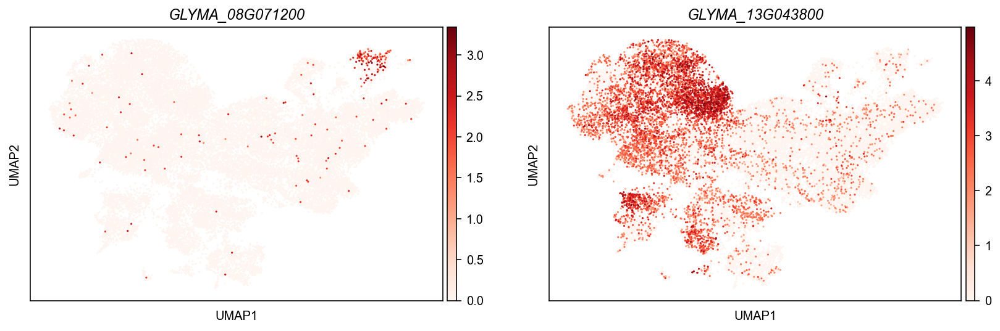

In [ ]:
axs = sc.pl.umap(ad, color=['GLYMA_08G071200', 'GLYMA_13G043800'], layer='normalize_log', cmap='Reds', show=False, size=10)
for ax in axs:
    plt.sca(ax)
    plt.title(ax.get_title(), fontstyle='italic')

In [ ]:
df_1v1OnlyDiff.groupby('Cluster').apply(lambda df:scipy.stats.ttest_ind(df['Diff'], df['Shuffle_Diff']).pvalue)

Cluster
0     1.463250e-04
1     1.085058e-07
10    2.282406e-16
11    2.502472e-03
12    3.519299e-05
13    3.588771e-13
14    1.731463e-13
2     3.281360e-10
3     3.579497e-32
4     2.973648e-13
5     1.416890e-10
6     3.381553e-09
7     2.221386e-07
8     4.559358e-16
9     2.118819e-14
dtype: float64